<a href="https://colab.research.google.com/github/Nyamadie/Dynamic-time-warping/blob/main/signal_similarity_and_features.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Packages

In [ ]:
!pip install "pandas<2.0.0" dtw-python plotly fastdtw dtaidistance

In [ ]:
import pickle
import pandas as pd
import numpy as np
from fastdtw import fastdtw
from google.colab import drive
from google.colab import files
import scipy.spatial.distance as dist
from scipy.spatial.distance import euclidean
import plotly.graph_objects as go
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import matplotlib.pyplot as plt
import numpy as np
from dtw import dtw
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
from scipy.stats import pearsonr
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import io

Importing the dtw module. When using in academic works please cite:
  T. Giorgino. Computing and Visualizing Dynamic Time Warping Alignments in R: The dtw Package.
  J. Stat. Soft., doi:10.18637/jss.v031.i07.



# Data loader

In [ ]:
uploaded = files.upload()

Saving patient_data.csv to patient_data.csv


In [ ]:
df = pd.read_csv(io.BytesIO(uploaded['patient_data.csv']))
df.head()

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (worldly-sweep-243),InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656)
0,AA 05.28.21.2.csv,16.0,2.71,1.71,0.21,0.21,1.32,0.54,1.46,5.29,...,0.81,4.33,NaN,NaN,0.58,NaN,NaN,NaN,NaN,3.9
1,AA 05.28.21.1.csv,16.0,0.01,0.00,NaN,-1.40,-0.94,0.08,0.01,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,AA 05.28.21.3.csv,16.0,1.51,1.33,-0.63,-0.50,0.82,0.54,0.34,1.89,...,0.62,2.92,NaN,NaN,0.58,NaN,NaN,NaN,NaN,3.9
3,AG 07.06.21.1.csv,19.0,3.42,1.14,0.94,0.64,0.57,0.62,5.78,3.79,...,3.45,3.89,3.16,3.38,NaN,NaN,NaN,NaN,NaN,2.2
4,AG 07.06.21.2.csv,19.0,4.36,1.32,1.52,1.20,0.80,0.62,3.06,4.14,...,4.87,6.58,5.83,3.95,NaN,NaN,NaN,NaN,NaN,2.2


In [ ]:
df = pd.read_csv(io.BytesIO(uploaded['patient_data.csv']))
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 417 entries, 0 to 416
Data columns (total 21 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   filenames                                      417 non-null    object 
 1   strain                                         417 non-null    float64
 2   mean                                           417 non-null    float64
 3   std_dev                                        417 non-null    float64
 4   z_score                                        279 non-null    float64
 5   mean_z_score                                   417 non-null    float64
 6   std_dev_z_score                                417 non-null    float64
 7   Data QA                                        417 non-null    float64
 8   XCMPlus (zany-dust-13457)                      182 non-null    float64
 9   XCMPlus (radiant-sweep-1)                      163 non

,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),XCMPlus (mild-sweep-2),InceptionTimePlus (worldly-sweep-243),InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656)
count,417.000000,417.000000,417.000000,279.000000,417.000000,417.000000,417.000000,182.000000,163.000000,164.000000,160.000000,160.000000,128.000000,128.000000,163.000000,62.000000,62.000000,62.000000,62.000000,155.000000
mean,16.049161,2.353070,0.709856,-0.779462,0.000048,-0.001511,0.304772,3.033297,3.184847,3.208110,2.136500,2.190438,2.328203,2.389687,1.949018,2.217581,2.211613,2.444839,2.243065,2.050968
std,3.605465,1.679304,0.758823,7.172092,0.999948,1.001411,0.218963,2.340166,2.506229,2.418342,1.751115,1.851464,1.823860,1.733518,1.601798,1.997531,2.146059,2.126588,1.970756,1.755105
min,5.000000,0.010000,0.000000,-66.440000,-1.400000,-0.940000,0.080000,0.010000,0.010000,0.010000,0.090000,0.010000,0.050000,0.040000,0.070000,0.020000,0.110000,0.020000,0.040000,0.010000
25%,14.000000,1.170000,0.000000,-1.280000,-0.700000,-0.940000,0.080000,1.032500,1.050000,1.277500,0.777500,0.670000,0.942500,1.067500,0.695000,0.757500,0.812500,0.660000,0.832500,0.780000
50%,17.000000,2.010000,0.530000,-0.250000,-0.200000,-0.240000,0.310000,2.715000,2.750000,2.725000,1.590000,1.855000,2.090000,2.150000,1.610000,1.855000,1.795000,1.975000,1.695000,1.620000
75%,19.000000,3.390000,1.210000,0.815000,0.620000,0.660000,0.460000,4.670000,4.945000,4.545000,3.232500,3.372500,3.187500,3.250000,2.855000,2.687500,2.685000,3.725000,3.350000,2.835000
max,24.000000,12.060000,3.870000,38.670000,5.780000,4.160000,0.920000,12.060000,9.380000,10.990000,9.130000,9.500000,9.290000,9.540000,7.170000,10.610000,10.840000,8.920000,9.450000,9.790000


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

%cd '/content/drive/MyDrive/QFHD'

Mounted at /content/drive
/content/drive/.shortcut-targets-by-id/1zgbI4HtAh4L5VsbEGVeF9fSUylAVhvLx/QFHD


In [ ]:
pickle_file_path = ""
meta_file_path = ''
# pickle_df = pd.read_pickle(pickle_file_path)

In [ ]:
with open(pickle_file_path, 'rb') as file:
  signal_data = pickle.load(file)

In [ ]:
# signal_data['file_data']['SH 07.06.21.2.csv']
signal_data['file_data']['SH 07.06.21.2.csv'].columns

Index(['raw_data', 'Category', 'raw_10hz_filt', 'cycle_10hz_filt',
       'trend_10hz_filt', 'cycle_norm_10hz_filt', 'fund_freq_10hz_filt',
       'harm_freq_10hz_filt', 'env_low', 'env_high', 'env_height',
       'env_scaled', 'env_cycle', 'var_scale_cycle', 'af_trend', 'roll_hr',
       'roll_period', 'roll_hr_norm', 'flipped_median', 'mean_subtracted',
       'cycle', 'trend', 'filt_cycle', 'cycle_norm'],
      dtype='object')

In [ ]:
ppg_signals_df = signal_data['file_data']
ppg_signals_df

{'JFHC GY1 10.12.21.1.csv':       raw_data  Category  raw_10hz_filt  cycle_10hz_filt  trend_10hz_filt  \
 0        20139  Baseline   20139.041583       -16.057309     20155.098892   
 1        20146  Baseline   20146.018734       -10.690851     20156.709585   
 2        20151  Baseline   20150.968353        -7.350320     20158.318673   
 3        20157  Baseline   20156.962106        -2.961374     20159.923480   
 4        20159  Baseline   20159.009504        -2.511093     20161.520597   
 ...        ...       ...            ...              ...              ...   
 2753     20158  Recovery   20158.234588        -1.596811     20159.831399   
 2754     20146  Recovery   20146.217640       -13.007907     20159.225547   
 2755     20143  Recovery   20142.903659       -15.707055     20158.610714   
 2756     20142  Recovery   20141.720658       -16.270584     20157.991242   
 2757     20146  Recovery   20145.921523       -11.448682     20157.370205   
 
       cycle_norm_10hz_filt  fund_f

In [ ]:
filtered_df = df[df['Data QA'] >= 0.4]  #Fitering out data form the data qa feature with above 0.6
filtered_df = filtered_df.dropna(subset=['z_score'])
filtered_df['Health Status'] = filtered_df['strain'].apply(lambda x: 'Healthy' if x > 14 else 'Unhealthy')

# Split the data into Healthy and Unhealthy categories
healthy_df = filtered_df[filtered_df['Health Status'] == 'Healthy']
unhealthy_df = filtered_df[filtered_df['Health Status'] == 'Unhealthy']

# Display the DataFrames for each category
display("Healthy Data:")
display(healthy_df)
display("Unhealthy Data:")
display(unhealthy_df)

'Healthy Data:'

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656),Health Status
0,AA 05.28.21.2.csv,16.0,2.71,1.71,0.21,0.21,1.32,0.54,1.46,5.29,...,4.33,NaN,NaN,0.58,NaN,NaN,NaN,NaN,3.90,Healthy
2,AA 05.28.21.3.csv,16.0,1.51,1.33,-0.63,-0.50,0.82,0.54,0.34,1.89,...,2.92,NaN,NaN,0.58,NaN,NaN,NaN,NaN,3.90,Healthy
3,AG 07.06.21.1.csv,19.0,3.42,1.14,0.94,0.64,0.57,0.62,5.78,3.79,...,3.89,3.16,3.38,NaN,NaN,NaN,NaN,NaN,2.20,Healthy
4,AG 07.06.21.2.csv,19.0,4.36,1.32,1.52,1.20,0.80,0.62,3.06,4.14,...,6.58,5.83,3.95,NaN,NaN,NaN,NaN,NaN,2.20,Healthy
5,AG 07.06.21.3.csv,19.0,3.93,1.21,1.30,0.94,0.66,0.92,3.44,5.19,...,5.66,5.15,4.66,NaN,2.16,2.02,5.18,3.53,2.45,Healthy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265,KD 06.25.21.3.csv,15.0,2.59,1.49,0.16,0.14,1.03,0.46,NaN,NaN,...,NaN,1.42,0.95,NaN,2.69,1.39,4.83,4.25,NaN,Healthy
268,KN 06.17.21.3.csv,19.0,1.82,1.04,-0.51,-0.32,0.44,0.46,NaN,NaN,...,NaN,0.28,0.47,NaN,2.24,2.71,2.85,2.34,NaN,Healthy
270,LJ 06.03.21.3.csv,18.0,2.03,1.25,-0.26,-0.19,0.71,0.46,NaN,NaN,...,NaN,3.22,2.43,NaN,3.44,2.38,0.70,0.04,NaN,Healthy
275,MA 06.10.21.2.csv,17.0,3.49,0.77,1.48,0.68,0.08,0.46,NaN,NaN,...,NaN,2.20,2.64,NaN,3.99,3.99,4.20,3.95,NaN,Healthy


'Unhealthy Data:'

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656),Health Status
13,BHRT AS1 10.20.21.2.csv,6.0,3.98,3.87,0.42,0.97,4.16,0.54,10.72,8.24,...,0.15,NaN,NaN,0.60,NaN,NaN,NaN,NaN,2.24,Unhealthy
14,BHRT AS1 10.20.21.3.csv,6.0,3.44,2.35,0.46,0.65,2.16,0.54,6.76,7.14,...,0.80,NaN,NaN,1.67,NaN,NaN,NaN,NaN,2.24,Unhealthy
15,BHRT BD1 09.29.21.3.csv,13.0,0.64,0.30,-5.71,-1.02,-0.54,0.46,1.03,0.44,...,0.71,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.56,Unhealthy
16,BHRT BD1 09.29.21.2.csv,13.0,1.47,0.82,-1.08,-0.53,0.15,0.46,2.51,1.13,...,0.54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.56,Unhealthy
21,BHRT KH1 09.15.21.3.csv,10.0,5.78,2.17,1.58,2.04,1.92,0.46,5.89,8.78,...,3.39,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.40,Unhealthy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,JFHC JN1 09.21.21.3.csv,14.0,0.76,0.84,-1.90,-0.95,0.17,0.46,NaN,NaN,...,NaN,2.53,0.63,NaN,0.18,0.88,0.02,0.30,NaN,Unhealthy
244,JFHC MC1 10.12.21.3.csv,13.0,0.90,0.84,-1.73,-0.87,0.17,0.46,NaN,NaN,...,NaN,0.77,0.29,NaN,2.59,1.21,0.04,0.52,NaN,Unhealthy
247,JFHC ME1 08.03.21.3.csv,14.0,1.38,0.62,-1.57,-0.58,-0.12,0.46,NaN,NaN,...,NaN,0.86,2.19,NaN,2.01,1.74,0.57,0.91,NaN,Unhealthy
254,JH 03.02.21.2.csv,14.0,2.76,0.82,0.50,0.24,0.15,0.46,NaN,NaN,...,NaN,2.34,3.25,NaN,2.47,3.85,1.34,3.29,NaN,Unhealthy


In [ ]:
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
healthy_filenames

['AA 05.28.21.2.csv',
 'AA 05.28.21.3.csv',
 'AG 07.06.21.1.csv',
 'AG 07.06.21.2.csv',
 'AG 07.06.21.3.csv',
 'AL 01.21.21.1.csv',
 'AL 01.21.21.3.csv',
 'AL 01.21.21.2.csv',
 'AM 06.08.21.2.csv',
 'AM 06.08.21.1.csv',
 'AM 06.08.21.3.csv',
 'DG 01.15.21.2.csv',
 'DG 01.15.21.1.csv',
 'FM 01.14.21.2.csv',
 'FM 01.14.21.1.csv',
 'FM 01.14.21.3.csv',
 'HX 06.03.21.3.csv',
 'HX 06.03.21.1.csv',
 'HX 06.03.21.2.csv',
 'IA 07.01.21.3.csv',
 'IA 07.01.21.2.csv',
 'IA 07.01.21.1.csv',
 'IW 07.08.21.3.csv',
 'IW 07.08.21.2.csv',
 'IW 07.08.21.1.csv',
 'JFHC AI1 09.07.21.2.csv',
 'JFHC AI1 09.07.21.3.csv',
 'JFHC AI1 09.07.21.1.csv',
 'JFHC GY1 10.12.21.1.csv',
 'JFHC GY1 10.12.21.2.csv',
 'JFHC GY1 10.12.21.3.csv',
 'JFHC JC1 08.24.21.2.csv',
 'JFHC JC1 08.24.21.3.csv',
 'JFHC SZ1 09.28.21.3.csv',
 'JFHC SZ1 09.28.21.2.csv',
 'JFHC SZ1 09.28.21.1.csv',
 'JK 06.10.21.3.csv',
 'JK 06.10.21.1.csv',
 'JK 06.10.21.2.csv',
 'JO 03.05.21.1.csv',
 'JO 03.05.21.2.csv',
 'JO 03.05.21.3.csv',
 'JR 06.10

# Descriptive statistics

In [ ]:
num_healthy_patients = len(healthy_filename)
print(f"Number of healthy patients: {num_healthy_patients}")

NameError: name 'healthy_filename' is not defined

In [ ]:
sample_filename = healthy_filename[0]
sample_data = ppg_signals_df[sample_filename]['raw_data']
print(f"Sample data for {sample_filename}:")
print(sample_data.describe())

Sample data for AA 05.28.21.2.csv:
count     2851.000000
mean     21900.000351
std        328.583914
min      21192.000000
25%      21593.000000
50%      21991.000000
75%      22189.000000
max      22490.000000
Name: raw_data, dtype: float64


In [ ]:
signal_lengths = [len(ppg_signals_df[filename]['raw_data']) for filename in healthy_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

In [ ]:
shortest_signal = min(signal_lengths)
longest_signal = max(signal_lengths)
print(f"Shortest signal: {shortest_signal} data points")
print(f"Longest signal: {longest_signal} data points")

In [ ]:
sample_rate = 1 / (ppg_signals_df[sample_filename]['raw_data'].index[1] - ppg_signals_df[sample_filename]['raw_data'].index[0])
print(f"Estimated sampling rate: {sample_rate:.2f} Hz")

In [ ]:
fund_freqs = [ppg_signals_df[filename]['fund_freq_10hz_filt'].mean() for filename in healthy_filenames]
print("Fundamental frequency statistics:")
print(pd.Series(fund_freqs).describe())

In [ ]:
missing_data = {filename: ppg_signals_df[filename]['raw_data'].isna().sum() for filename in healthy_filenames}
print("Number of missing values in raw data:")
print(pd.Series(missing_data).describe())

In [ ]:
def normalize_signal(signal):
    """Normalize the signal using z-score normalization."""
    return (signal - np.mean(signal)) / np.std(signal)

# Normalize all healthy signals
normalized_signals = {filename: normalize_signal(ppg_signals_df[filename]['raw_data'].values)
                      for filename in healthy_filenames}

In [ ]:
signal_lengths = [len(normalized_signals) for filename in healthy_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

In [ ]:
shortest_signal = min(signal_lengths)
longest_signal = max(signal_lengths)
print(f"Shortest signal: {shortest_signal} data points")
print(f"Longest signal: {longest_signal} data points")

In [ ]:
normalized_signals

In [ ]:
from dtaidistance import dtw
import numpy as np

def compute_dtw_distance(signal1, signal2):
    return dtw.distance(signal1, signal2)

In [ ]:
for filename, signal in normalized_signals.items():
    print(f"{filename}: shape = {signal.shape}")
    break  # Just print the first one as an example

In [ ]:
def analyze_signal(filename, ppg_signals_df):
    signal_data = ppg_signals_df[filename]
    summary = {
        'filename': filename,
        'signal_length': len(signal_data['raw_data']),
        'mean_raw': signal_data['raw_data'].mean(),
        'std_raw': signal_data['raw_data'].std(),
        'mean_filth': signal_data['cycle_10hz_filt'].mean(),
        'scaled': signal_data['env_scaled'].mean(),
    }
    return summary

# Analyze all healthy signals
healthy_signal_summaries = [analyze_signal(filename, ppg_signals_df) for filename in healthy_filenames]
healthy_signal_summary_df = pd.DataFrame(healthy_signal_summaries)

# Display summary
print(healthy_signal_summary_df.describe())

# Healthy patients

## Raw channel

In [ ]:
import pickle
import pandas as pd
from fastdtw import fastdtw
import matplotlib.pyplot as plt
import numpy as np

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Placeholder for DTW results
dtw_results = []

for i in range(len(healthy_filenames)):
    for j in range(i + 1, len(healthy_filenames)):
        # Ensure the signal is a 1-D array
        signal_1 = normalize_signal(ppg_signals_df[healthy_filenames[i]]['raw_data'].values)
        signal_2 = normalize_signal(ppg_signals_df[healthy_filenames[j]]['raw_data'].values)

        # Calculate DTW distance and get the warping path
        distance, path = fastdtw(signal_1, signal_2)
        dtw_results.append((healthy_filenames[i], healthy_filenames[j], distance, path))

        # Plot warping path
        plt.figure(figsize=(6, 4))
        plt.plot(signal_1, label=healthy_filenames[i])
        plt.plot(signal_2, label=healthy_filenames[j])
        plt.title(f'Warping Path between {healthy_filenames[i]} and {healthy_filenames[j]}')
        plt.legend()
        plt.show()


In [ ]:
import numpy as np
import pandas as pd
from scipy.signal import find_peaks
from scipy.fft import fft
from dtaidistance import dtw

# Function to extract features from a signal
def extract_features(signal):
    peaks, _ = find_peaks(signal)
    peak_amplitudes = signal[peaks]
    peak_intervals = np.diff(peaks)
    freq_components = np.abs(fft(signal))
    return {
        "peak_amplitudes": peak_amplitudes,
        "peak_intervals": peak_intervals,
        "freq_components": freq_components
    }

# Function to align signals using DTW and extract features
def analyze_signals(signals):
    all_features = []

    for signal in signals:
        features = extract_features(signal)
        all_features.append(features)

    return all_features

# Assuming healthy_filenames contains the list of filenames
num_signals = 40  # or more
selected_filenames = healthy_filenames[:num_signals]

# Extract signals from the DataFrame
signals = [normalize_signal(ppg_signals_df[filename]['raw_data'].values) for filename in selected_filenames]

# Perform analysis
features_list = analyze_signals(signals)

# Aggregate the features for trend analysis
trend_data = {
    "filename": [],
    "mean_peak_amplitude": [],
    "mean_peak_interval": [],
    "dominant_frequency": []
}

for i, features in enumerate(features_list):
    trend_data["filename"].append(selected_filenames[i])
    trend_data["mean_peak_amplitude"].append(np.mean(features["peak_amplitudes"]))
    trend_data["mean_peak_interval"].append(np.mean(features["peak_intervals"]))
    trend_data["dominant_frequency"].append(np.argmax(features["freq_components"]))

trend_df = pd.DataFrame(trend_data)

# Analyze trends
print(trend_df.describe())  # Summary statistics
print(trend_df)

# You can also plot the trends to visualize them
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.plot(trend_df['filename'], trend_df['mean_peak_amplitude'], label="Mean Peak Amplitude")
plt.plot(trend_df['filename'], trend_df['mean_peak_interval'], label="Mean Peak Interval")
plt.plot(trend_df['filename'], trend_df['dominant_frequency'], label="Dominant Frequency")
plt.xticks(rotation=90)
plt.legend()
plt.title("Trend Analysis of Signal Features")
plt.show()


### Warping path

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Calculate 62 unique pairs
num_pairs = 62
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals
    signal_1 = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2 = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2}')
    plt.show()


### Whistle region

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Calculate 62 unique pairs
num_pairs = 62
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Filter signals for the "Whistle" category
    signal_1_whistle = ppg_signals_df[filename_1][ppg_signals_df[filename_1]['Category'] == 'Whistle']['raw_data'].values
    signal_2_whistle = ppg_signals_df[filename_2][ppg_signals_df[filename_2]['Category'] == 'Whistle']['raw_data'].values

    # Normalize the signals
    signal_1 = normalize_signal(signal_1_whistle)
    signal_2 = normalize_signal(signal_2_whistle)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2} - Whistle Region')
    plt.show()


In [ ]:
!pip install scikit-learn-extra

## Cycle

In [ ]:
sample_filename = healthy_filenames[0]
sample_data = ppg_signals_df[sample_filename]['cycle_10hz_filt']
print(f"Sample data for {sample_filename}:")
print(sample_data.describe())

In [ ]:
signal_lengths = [len(ppg_signals_df[filename]['cycle_10hz_filt']) for filename in healthy_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

In [ ]:
missing_data = {filename: ppg_signals_df[filename]['cycle_10hz_filt'].isna().sum() for filename in healthy_filenames}
print("Number of missing values in raw data:")
print(pd.Series(missing_data).describe())

### Warping path

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Calculate 62 unique pairs
num_pairs = 62
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals
    signal_1 = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2 = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2}')
    plt.show()


### Whistle region

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Calculate 62 unique pairs
num_pairs = 62
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Filter signals for the "Whistle" category
    signal_1_whistle = ppg_signals_df[filename_1][ppg_signals_df[filename_1]['Category'] == 'Whistle']['cycle_10hz_filt'].values
    signal_2_whistle = ppg_signals_df[filename_2][ppg_signals_df[filename_2]['Category'] == 'Whistle']['cycle_10hz_filt'].values

    # Normalize the signals
    signal_1 = normalize_signal(signal_1_whistle)
    signal_2 = normalize_signal(signal_2_whistle)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2} - Whistle Region')
    plt.show()


## Env scale

In [ ]:
sample_filename = healthy_filenames[0]
sample_data = ppg_signals_df[sample_filename]['env_scaled']
print(f"Sample data for {sample_filename}:")
print(sample_data.describe())

In [ ]:
signal_lengths = [len(ppg_signals_df[filename]['env_scaled']) for filename in healthy_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

In [ ]:
def normalize_signal(signal):
    """Normalize the signal using z-score normalization."""
    return (signal - np.mean(signal)) / np.std(signal)

# Normalize all healthy signals
normalized_signals = {filename: normalize_signal(ppg_signals_df[filename]['env_scaled'].values)
                      for filename in healthy_filenames}

### Warping path

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Calculate 62 unique pairs
num_pairs = 62
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals
    signal_1 = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2 = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2}')
    plt.show()


### Whistle region

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Calculate 62 unique pairs
num_pairs = 62
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Filter signals for the "Whistle" category
    signal_1_whistle = ppg_signals_df[filename_1][ppg_signals_df[filename_1]['Category'] == 'Whistle']['env_scaled'].values
    signal_2_whistle = ppg_signals_df[filename_2][ppg_signals_df[filename_2]['Category'] == 'Whistle']['env_scaled'].values

    # Normalize the signals
    signal_1 = normalize_signal(signal_1_whistle)
    signal_2 = normalize_signal(signal_2_whistle)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2} - Whistle Region')
    plt.show()


## Distribution

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 30
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot bar charts
axes[0].bar(range(num_pairs), dtw_distances_raw, color='blue', alpha=0.7)
axes[0].set_title('DTW Distance Distribution (raw_data)')
axes[0].set_xlabel('Pair Index')
axes[0].set_ylabel('DTW Distance')

axes[1].bar(range(num_pairs), dtw_distances_cycle, color='green', alpha=0.7)
axes[1].set_title('DTW Distance Distribution (cycle_10hz_filt)')
axes[1].set_xlabel('Pair Index')
axes[1].set_ylabel('DTW Distance')

axes[2].bar(range(num_pairs), dtw_distances_env, color='red', alpha=0.7)
axes[2].set_title('DTW Distance Distribution (env_scaled)')
axes[2].set_xlabel('Pair Index')
axes[2].set_ylabel('DTW Distance')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


### Whistle Region

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 30
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Filter the signals to focus on the "Whistle" category
    whistle_1 = ppg_signals_df[filename_1][ppg_signals_df[filename_1]['Category'] == 'Whistle']
    whistle_2 = ppg_signals_df[filename_2][ppg_signals_df[filename_2]['Category'] == 'Whistle']

    # Extract and normalize the signals for each channel in the "Whistle" region
    signal_1_raw = normalize_signal(whistle_1['raw_data'].values)
    signal_2_raw = normalize_signal(whistle_2['raw_data'].values)

    signal_1_cycle = normalize_signal(whistle_1['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(whistle_2['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(whistle_1['env_scaled'].values)
    signal_2_env = normalize_signal(whistle_2['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot bar charts
axes[0].bar(range(num_pairs), dtw_distances_raw, color='blue', alpha=0.7)
axes[0].set_title('DTW Distance Distribution (raw_data) - Whistle Region')
axes[0].set_xlabel('Pair Index')
axes[0].set_ylabel('DTW Distance')

axes[1].bar(range(num_pairs), dtw_distances_cycle, color='green', alpha=0.7)
axes[1].set_title('DTW Distance Distribution (cycle_10hz_filt) - Whistle Region')
axes[1].set_xlabel('Pair Index')
axes[1].set_ylabel('DTW Distance')

axes[2].bar(range(num_pairs), dtw_distances_env, color='red', alpha=0.7)
axes[2].set_title('DTW Distance Distribution (env_scaled) - Whistle Region')
axes[2].set_xlabel('Pair Index')
axes[2].set_ylabel('DTW Distance')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


### Statistics

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import skew, kurtosis

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 30
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Convert lists to numpy arrays for easier computation
dtw_distances_raw = np.array(dtw_distances_raw)
dtw_distances_cycle = np.array(dtw_distances_cycle)
dtw_distances_env = np.array(dtw_distances_env)

# Define a function to calculate relevant statistics
def calculate_statistics(dtw_distances):
    stats = {
        'Mean': np.mean(dtw_distances),
        'Median': np.median(dtw_distances),
        'Standard Deviation': np.std(dtw_distances),
        'Min': np.min(dtw_distances),
        'Max': np.max(dtw_distances),
        'Range': np.ptp(dtw_distances),
        'Variance': np.var(dtw_distances),
        'Q1': np.percentile(dtw_distances, 25),
        'Q3': np.percentile(dtw_distances, 75),
        'Skewness': skew(dtw_distances),
        'Kurtosis': kurtosis(dtw_distances)
    }
    return stats

# Calculate statistics for each channel
stats_raw = calculate_statistics(dtw_distances_raw)
stats_cycle = calculate_statistics(dtw_distances_cycle)
stats_env = calculate_statistics(dtw_distances_env)

# Convert statistics dictionaries to DataFrames for tabulation
stats_raw_df = pd.DataFrame(stats_raw.items(), columns=['Statistic', 'Value'])
stats_cycle_df = pd.DataFrame(stats_cycle.items(), columns=['Statistic', 'Value'])
stats_env_df = pd.DataFrame(stats_env.items(), columns=['Statistic', 'Value'])

# Display the DataFrames as tables
print("Statistics for raw_data DTW distances:")
display(stats_raw_df)

print("\nStatistics for cycle_10hz_filt DTW distances:")
display(stats_cycle_df)

print("\nStatistics for env_scaled DTW distances:")
display(stats_env_df)

# Calculate correlation between the channels
correlation_raw_cycle = np.corrcoef(dtw_distances_raw, dtw_distances_cycle)[0, 1]
correlation_raw_env = np.corrcoef(dtw_distances_raw, dtw_distances_env)[0, 1]
correlation_cycle_env = np.corrcoef(dtw_distances_cycle, dtw_distances_env)[0, 1]

# Create a DataFrame for correlation values
correlation_df = pd.DataFrame({
    'Channel Pair': ['raw_data vs cycle_10hz_filt', 'raw_data vs env_scaled', 'cycle_10hz_filt vs env_scaled'],
    'Correlation': [correlation_raw_cycle, correlation_raw_env, correlation_cycle_env]
})

# Display the correlation DataFrame as a table
print("\nCorrelation between DTW distances:")
display(correlation_df)


# Good performers

In [ ]:
dfs = df[df['z_score'] < 0].sort_values('z_score', ascending=True)
dfs

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (worldly-sweep-243),InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656)
191,BHRT AH1 10.27.21.2.csv,13.0,0.36,0.03,-66.44,-1.19,-0.90,0.15,NaN,NaN,...,NaN,NaN,0.39,0.33,NaN,NaN,NaN,NaN,NaN,NaN
214,DY 02.09.21.1.csv,16.0,0.78,0.03,-52.44,-0.94,-0.90,0.15,NaN,NaN,...,NaN,NaN,0.75,0.80,NaN,NaN,NaN,NaN,NaN,NaN
279,ML 06.08.21.1.csv,20.0,0.50,0.07,-26.47,-1.10,-0.84,0.15,NaN,NaN,...,NaN,NaN,0.43,0.57,NaN,NaN,NaN,NaN,NaN,NaN
231,IS 02.05.21.1.csv,16.0,0.15,0.11,-20.03,-1.31,-0.79,0.15,NaN,NaN,...,NaN,NaN,0.26,0.04,NaN,NaN,NaN,NaN,NaN,NaN
416,ZX 06.29.21.3.csv,16.0,0.38,0.10,-19.73,-1.17,-0.80,0.31,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.37,0.51,0.23,0.41,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,BHRT JD1 09.29.21.1.csv,10.0,2.20,1.70,-0.09,-0.09,1.30,0.15,NaN,NaN,...,NaN,NaN,3.90,0.49,NaN,NaN,NaN,NaN,NaN,NaN
404,ML 06.08.21.3.csv,20.0,2.27,1.17,-0.07,-0.05,0.61,0.31,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1.86,1.89,4.23,1.11,NaN
243,JFHC MC1 10.12.21.2.csv,13.0,2.32,0.65,-0.05,-0.02,-0.08,0.15,NaN,NaN,...,NaN,NaN,2.97,1.67,NaN,NaN,NaN,NaN,NaN,NaN
52,HX 06.03.21.2.csv,17.0,2.24,2.16,-0.05,-0.07,1.91,0.54,0.23,0.27,...,5.57,4.75,NaN,NaN,3.65,NaN,NaN,NaN,NaN,0.52


In [ ]:
filtered_df = dfs[dfs['Data QA'] >= 0.4]  #Fitering out data form the data qa feature with above 0.6
filtered_df = filtered_df.dropna(subset=['z_score'])
filtered_df['Health Status'] = filtered_df['strain'].apply(lambda x: 'Healthy' if x > 14 else 'Unhealthy')

# Split the data into Healthy and Unhealthy categories
healthy = filtered_df[filtered_df['Health Status'] == 'Healthy']
unhealthy = filtered_df[filtered_df['Health Status'] == 'Unhealthy']

# Display the DataFrames for each category
display("Healthy Data:")
display(healthy)
display("Unhealthy Data:")
display(unhealthy)

'Healthy Data:'

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656),Health Status
145,RK 03.03.21.1.csv,16.0,0.34,0.17,-11.84,-1.20,-0.71,0.46,0.18,0.44,...,0.53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.16,Healthy
216,DY 02.09.21.3.csv,16.0,0.55,0.17,-10.61,-1.07,-0.71,0.46,NaN,NaN,...,NaN,0.28,0.61,NaN,0.60,0.79,0.37,0.66,NaN,Healthy
174,YC 05.21.21.3.csv,16.0,1.00,0.31,-4.36,-0.81,-0.53,0.46,1.43,0.76,...,1.28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.95,Healthy
133,QC 06.29.21.1.csv,18.0,0.89,0.44,-3.33,-0.87,-0.36,0.46,1.23,1.17,...,0.22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.78,Healthy
136,QL 06.08.21.3.csv,17.0,0.95,0.50,-2.81,-0.84,-0.28,0.46,0.44,1.80,...,0.56,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.47,Healthy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138,QL 06.08.21.2.csv,17.0,2.16,1.63,-0.12,-0.11,1.21,0.46,0.82,4.44,...,0.48,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.20,Healthy
156,SN 07.01.21.3.csv,20.0,2.17,1.61,-0.11,-0.11,1.19,0.54,4.78,3.73,...,0.21,NaN,NaN,2.02,NaN,NaN,NaN,NaN,0.31,Healthy
6,AL 01.21.21.1.csv,20.0,2.22,1.30,-0.10,-0.08,0.78,0.46,4.68,1.01,...,0.77,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.95,Healthy
52,HX 06.03.21.2.csv,17.0,2.24,2.16,-0.05,-0.07,1.91,0.54,0.23,0.27,...,4.75,NaN,NaN,3.65,NaN,NaN,NaN,NaN,0.52,Healthy


'Unhealthy Data:'

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656),Health Status
15,BHRT BD1 09.29.21.3.csv,13.0,0.64,0.30,-5.71,-1.02,-0.54,0.46,1.03,0.44,...,0.71,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.56,Unhealthy
273,LM 05.27.21.3.csv,14.0,0.94,0.58,-2.44,-0.84,-0.17,0.46,NaN,NaN,...,NaN,0.58,1.86,NaN,0.60,0.34,1.62,0.65,NaN,Unhealthy
235,JFHC JN1 09.21.21.3.csv,14.0,0.76,0.84,-1.90,-0.95,0.17,0.46,NaN,NaN,...,NaN,2.53,0.63,NaN,0.18,0.88,0.02,0.30,NaN,Unhealthy
244,JFHC MC1 10.12.21.3.csv,13.0,0.90,0.84,-1.73,-0.87,0.17,0.46,NaN,NaN,...,NaN,0.77,0.29,NaN,2.59,1.21,0.04,0.52,NaN,Unhealthy
103,KT 07.06.21.1.csv,14.0,1.10,0.74,-1.69,-0.75,0.04,0.62,2.11,0.64,...,2.10,0.19,1.65,NaN,NaN,NaN,NaN,NaN,0.92,Unhealthy
247,JFHC ME1 08.03.21.3.csv,14.0,1.38,0.62,-1.57,-0.58,-0.12,0.46,NaN,NaN,...,NaN,0.86,2.19,NaN,2.01,1.74,0.57,0.91,NaN,Unhealthy
49,GS 02.10.21.1.csv,14.0,1.25,0.76,-1.45,-0.66,0.07,0.54,0.49,2.34,...,1.16,NaN,NaN,0.99,NaN,NaN,NaN,NaN,2.40,Unhealthy
47,GS 02.10.21.2.csv,14.0,1.34,0.89,-1.14,-0.60,0.24,0.54,0.75,1.45,...,0.35,NaN,NaN,0.99,NaN,NaN,NaN,NaN,3.35,Unhealthy
71,JFHC MV1 10.19.21.2.csv,13.0,1.37,0.89,-1.10,-0.59,0.24,0.62,1.87,3.07,...,0.04,1.06,0.73,NaN,NaN,NaN,NaN,NaN,2.15,Unhealthy
16,BHRT BD1 09.29.21.2.csv,13.0,1.47,0.82,-1.08,-0.53,0.15,0.46,2.51,1.13,...,0.54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.56,Unhealthy


In [ ]:
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
goodH_filenames

['RK 03.03.21.1.csv',
 'DY 02.09.21.3.csv',
 'YC 05.21.21.3.csv',
 'QC 06.29.21.1.csv',
 'QL 06.08.21.3.csv',
 'JFHC RD1 09.21.21.3.csv',
 'DG 01.15.21.2.csv',
 'QC 06.29.21.3.csv',
 'QC 06.29.21.2.csv',
 'JY 07.20.21.3.csv',
 'JO 03.05.21.1.csv',
 'JO 03.05.21.3.csv',
 'BHRT BL1 09.08.21.3.csv',
 'JH 06.22.21.2.csv',
 'RK 03.03.21.3.csv',
 'JR 06.10.21.3.csv',
 'YC 05.21.21.1.csv',
 'RK 03.03.21.2.csv',
 'DG 01.15.21.1.csv',
 'JT 07.13.21.3.csv',
 'SH 07.06.21.2.csv',
 'JO 03.05.21.2.csv',
 'MM 02.26.21.2.csv',
 'IS 02.05.21.3.csv',
 'JFHC SZ1 09.28.21.1.csv',
 'JR 06.10.21.2.csv',
 'JFHC AI1 09.07.21.2.csv',
 'RM 07.08.21.2.csv',
 'RM 07.08.21.3.csv',
 'YC 05.21.21.2.csv',
 'SH 07.06.21.3.csv',
 'JFHC SZ1 09.28.21.3.csv',
 'RM 07.08.21.1.csv',
 'QL 06.08.21.1.csv',
 'SH 07.06.21.1.csv',
 'MY 03.02.21.1.csv',
 'MY 03.02.21.2.csv',
 'IA 07.01.21.2.csv',
 'MM 02.26.21.1.csv',
 'FM 01.14.21.1.csv',
 'AS 06.18.21.3.csv',
 'FM 01.14.21.3.csv',
 'VF 02.26.21.3.csv',
 'JFHC AI1 09.07.21.3.cs

In [ ]:
num_healthy_patients = len(goodH_filenames)
print(f"Number of healthy patients: {num_healthy_patients}") # 63.85%

Number of healthy patients: 83


In [ ]:
sample_filename = goodH_filenames[0]
sample_data = ppg_signals_df[sample_filename]['raw_data']
print(f"Sample data for {sample_filename}:")
print(sample_data.describe())

Sample data for RK 03.03.21.1.csv:
count     2668.000000
mean     14315.187781
std        185.141313
min      13936.000000
25%      14174.000000
50%      14291.500000
75%      14439.000000
max      14690.000000
Name: raw_data, dtype: float64


In [ ]:
signal_lengths = [len(ppg_signals_df[filename]['raw_data']) for filename in goodH_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

Average signal length: 2808.20 data points


In [ ]:
shortest_signal = min(signal_lengths)
longest_signal = max(signal_lengths)
print(f"Shortest signal: {shortest_signal} data points")
print(f"Longest signal: {longest_signal} data points")

Shortest signal: 2271 data points
Longest signal: 4398 data points


## Raw data

<Figure size 1000x600 with 0 Axes>

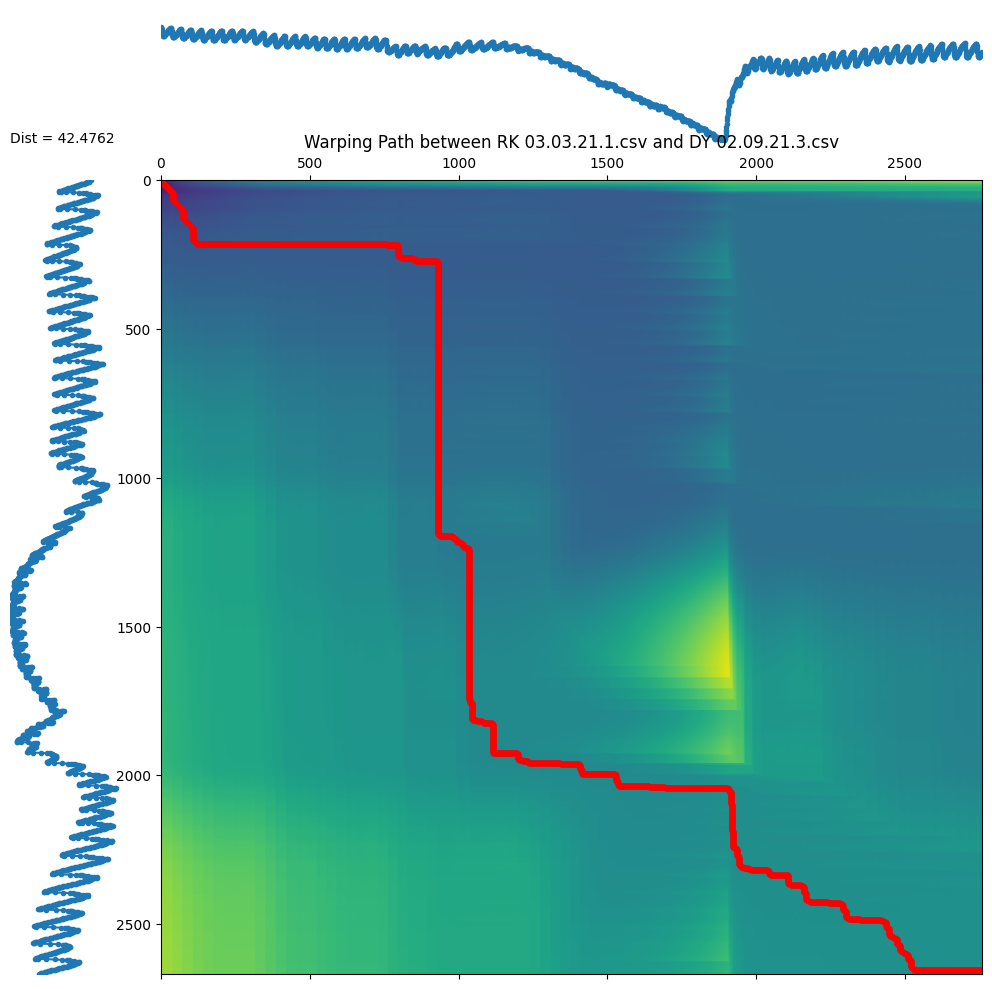

<Figure size 1000x600 with 0 Axes>

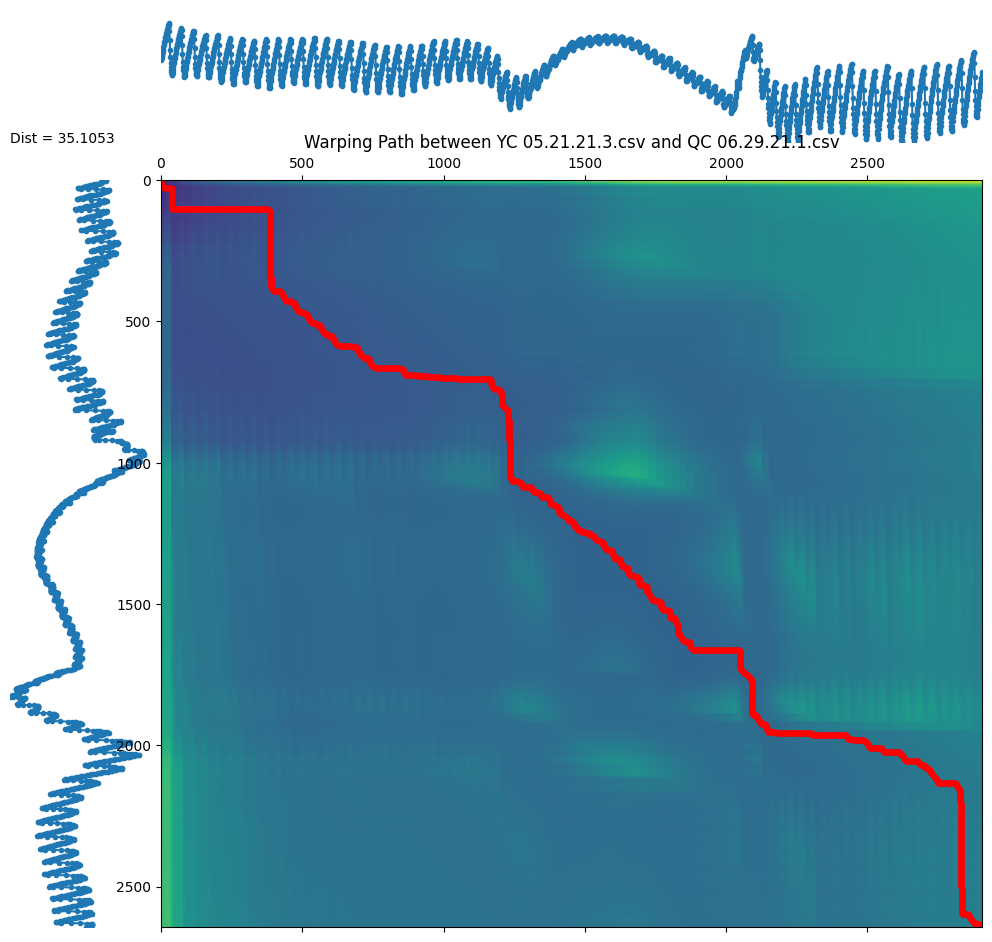

<Figure size 1000x600 with 0 Axes>

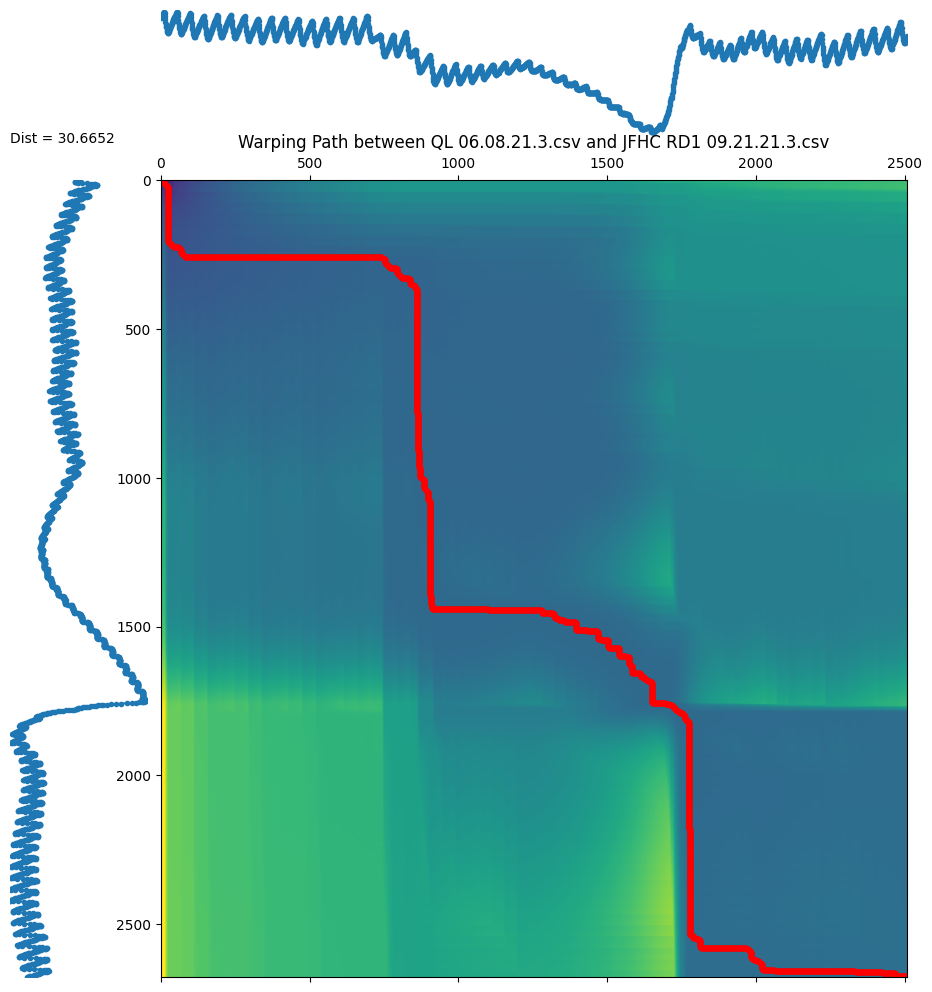

<Figure size 1000x600 with 0 Axes>

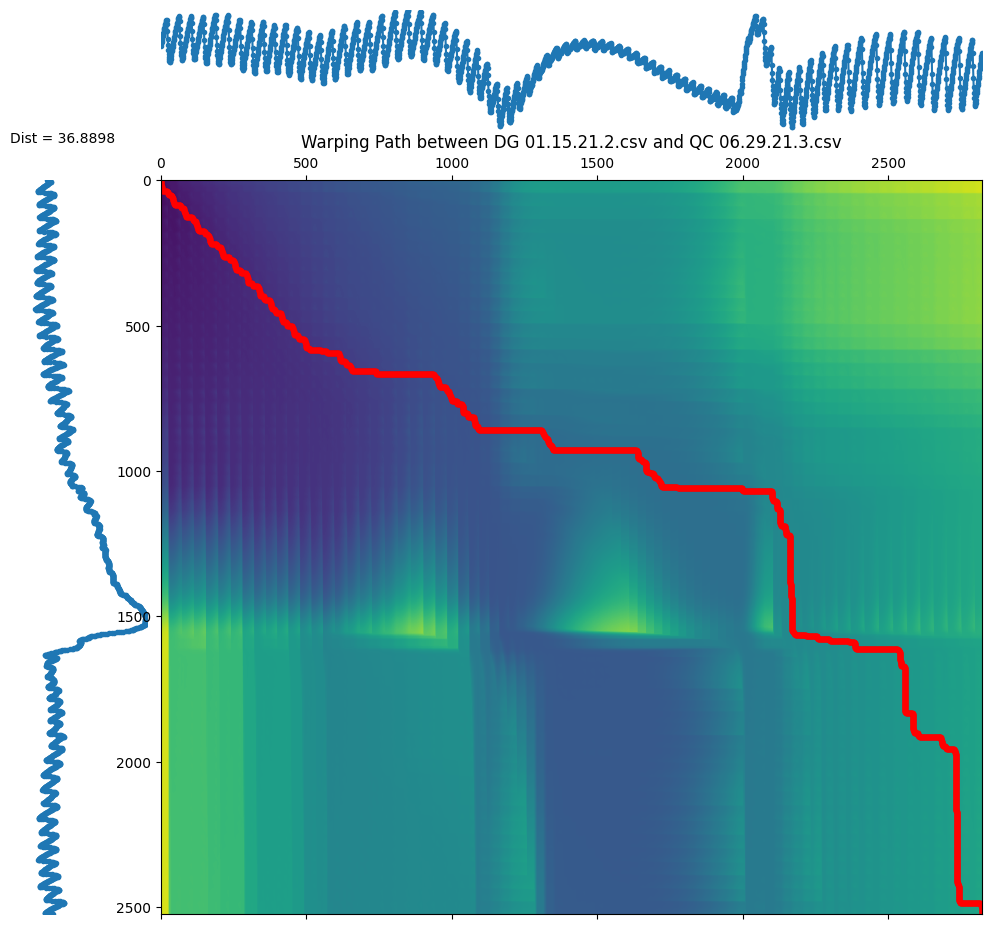

<Figure size 1000x600 with 0 Axes>

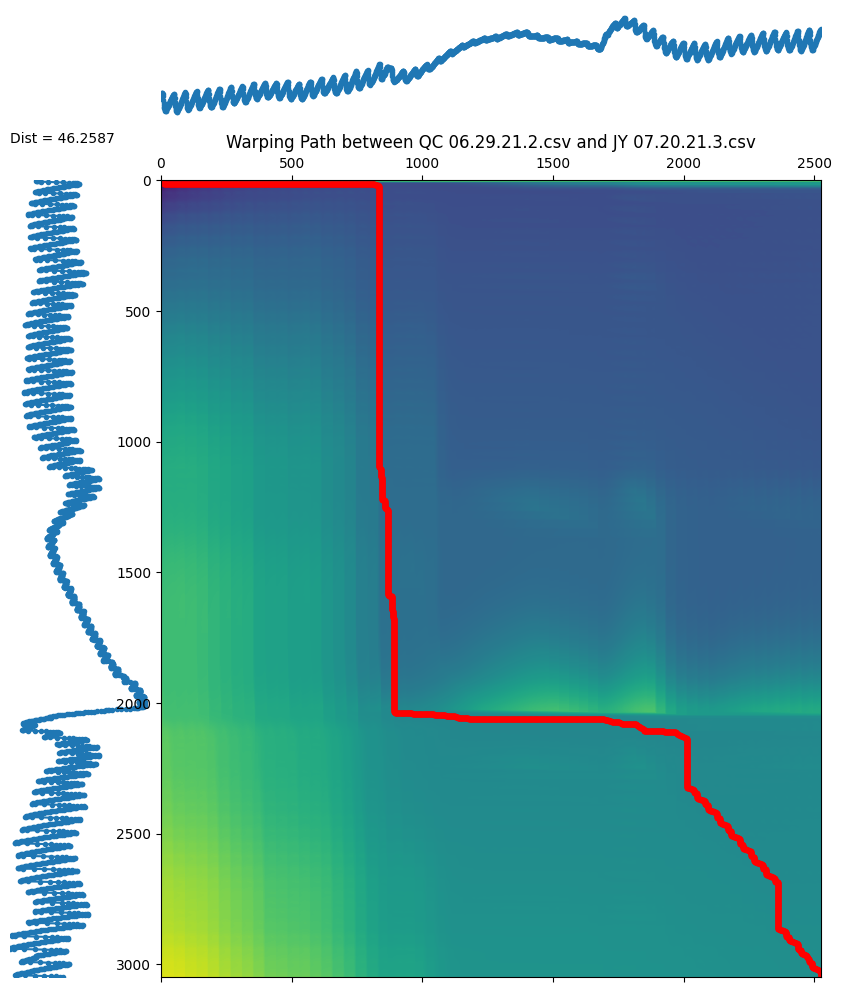

<Figure size 1000x600 with 0 Axes>

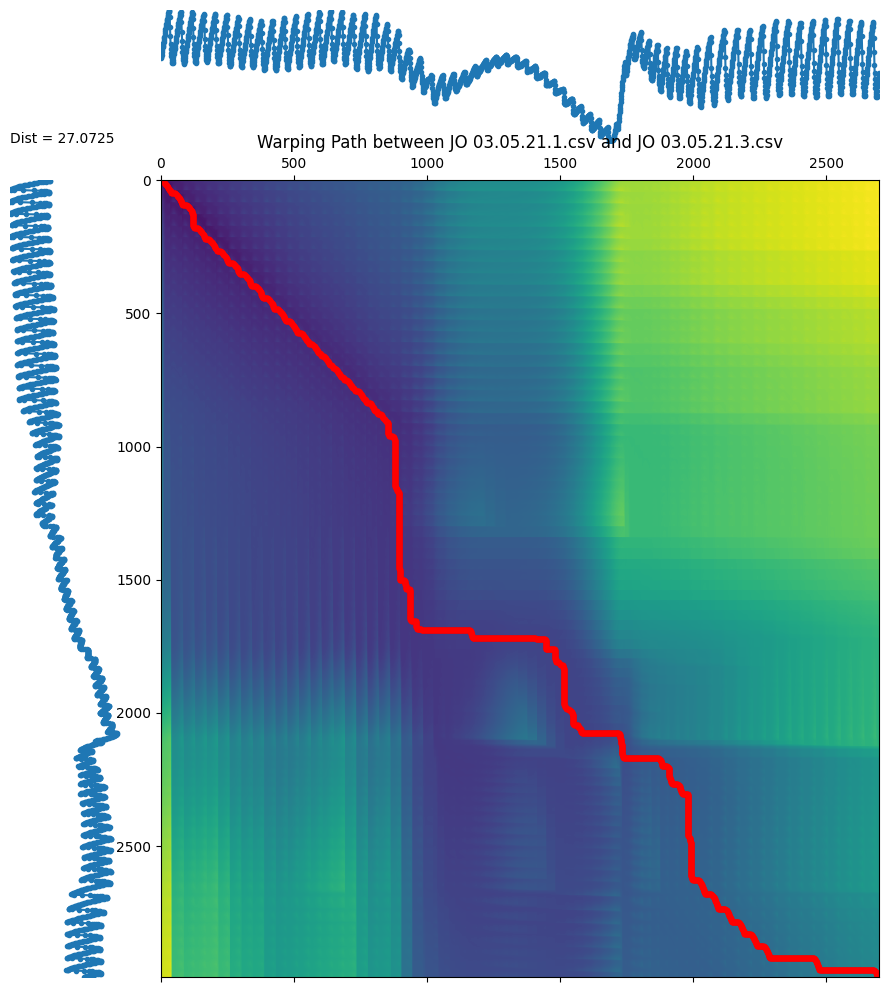

<Figure size 1000x600 with 0 Axes>

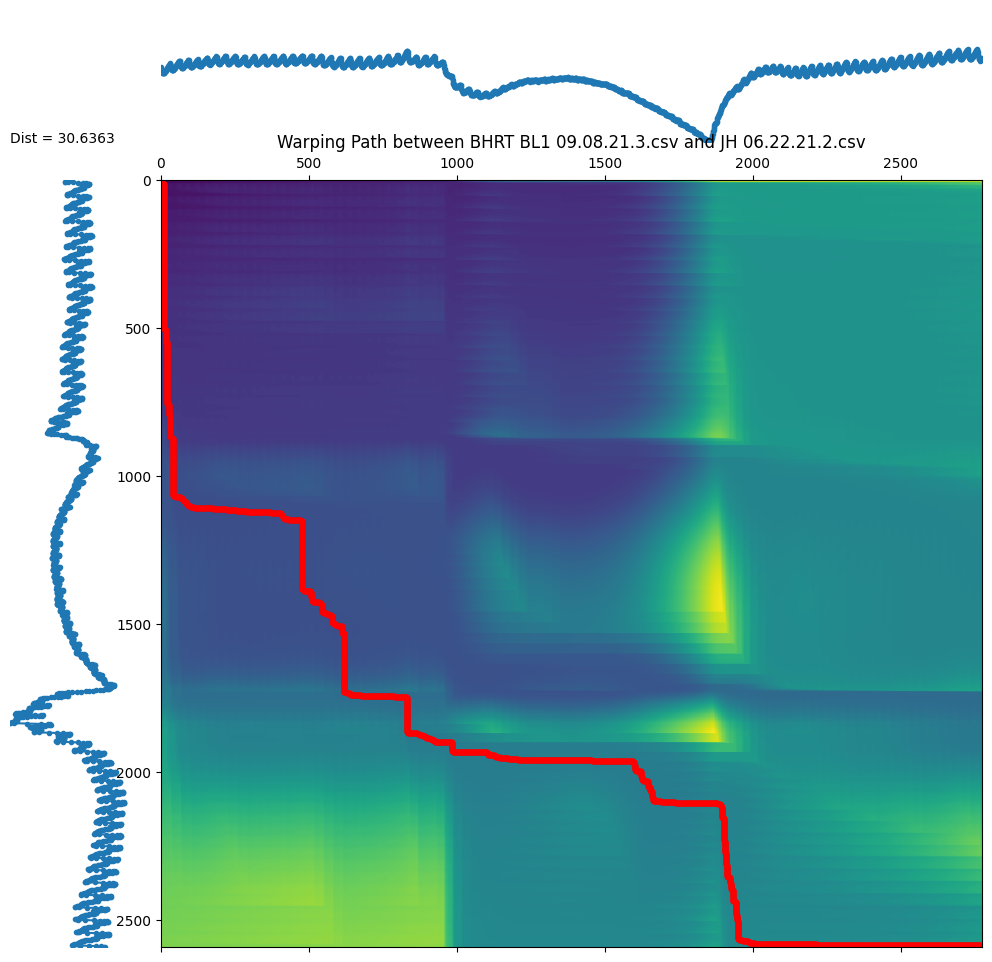

<Figure size 1000x600 with 0 Axes>

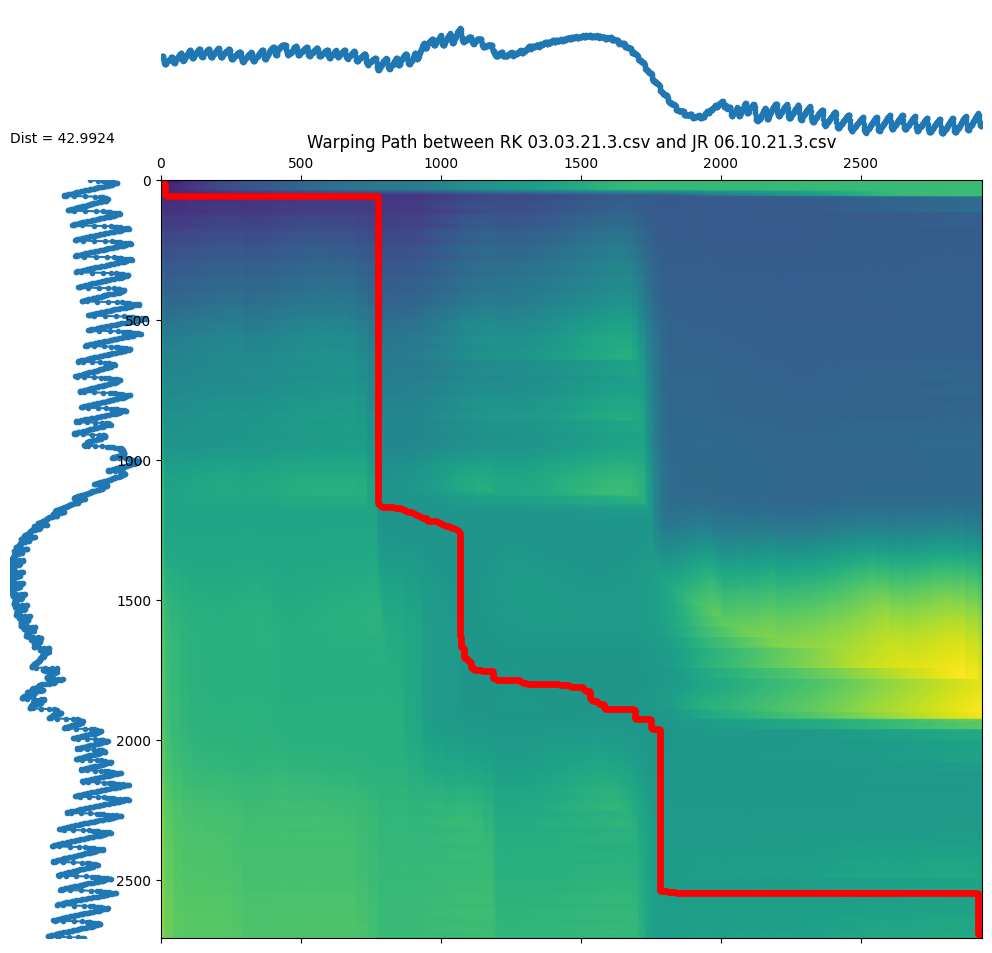

<Figure size 1000x600 with 0 Axes>

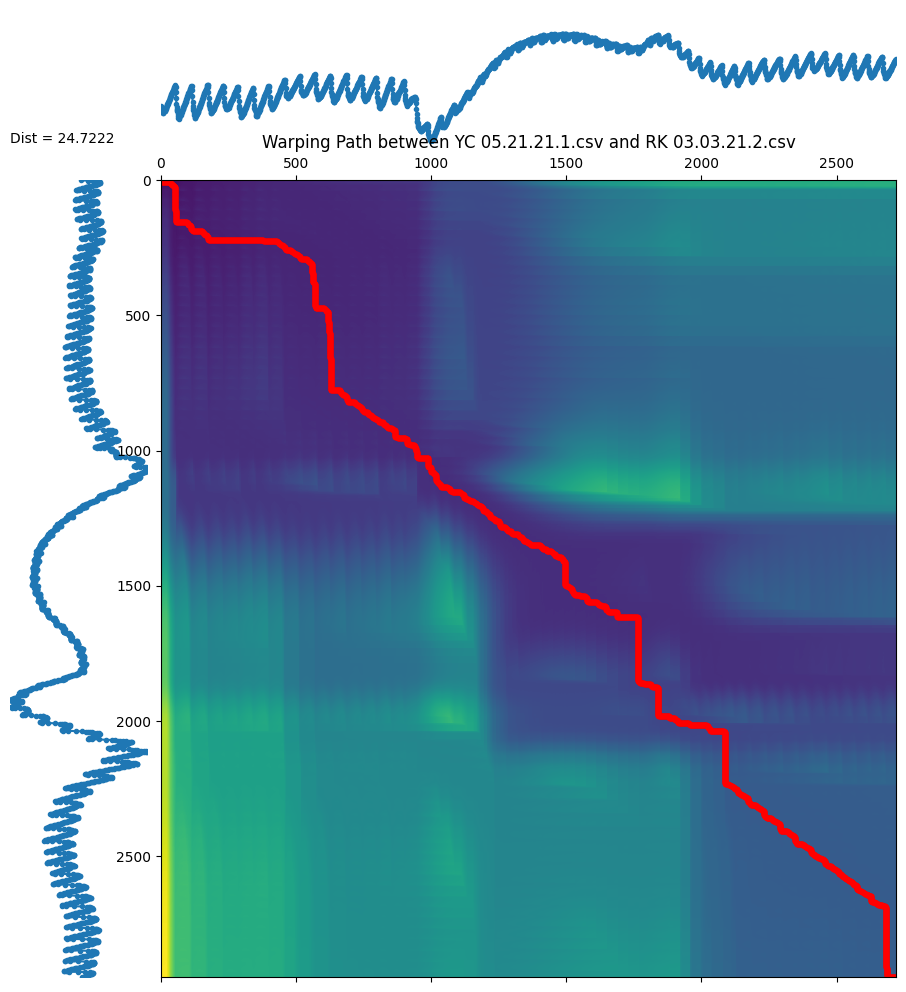

<Figure size 1000x600 with 0 Axes>

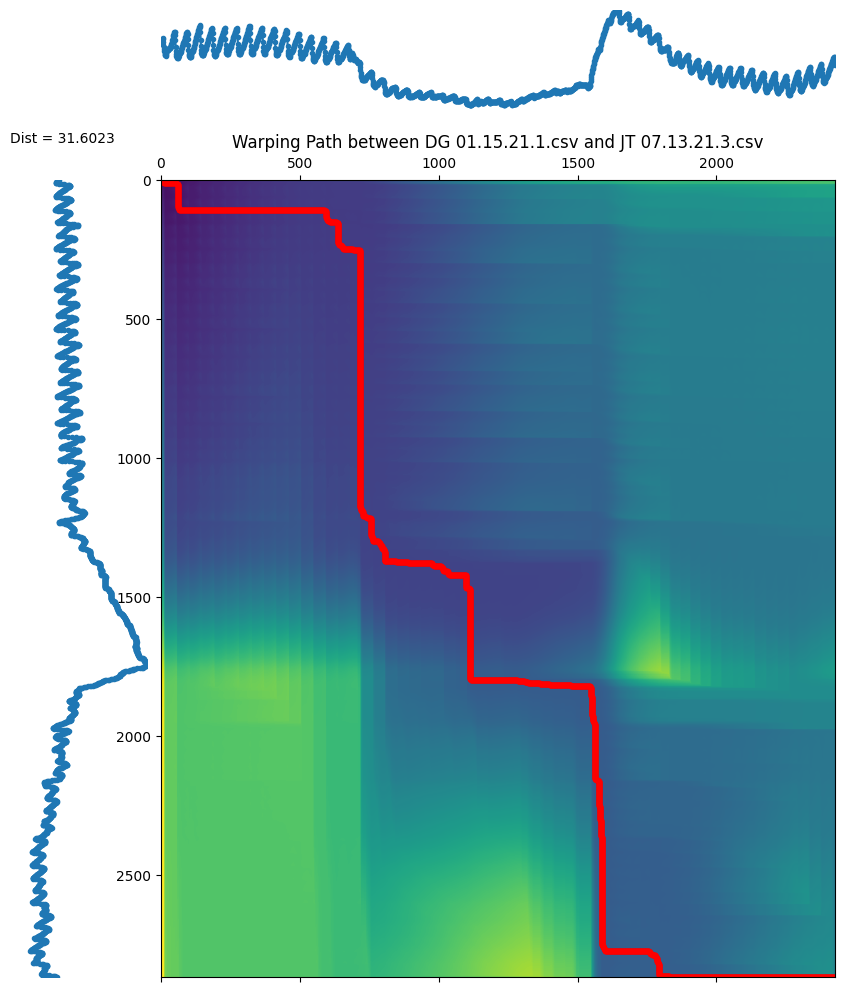

<Figure size 1000x600 with 0 Axes>

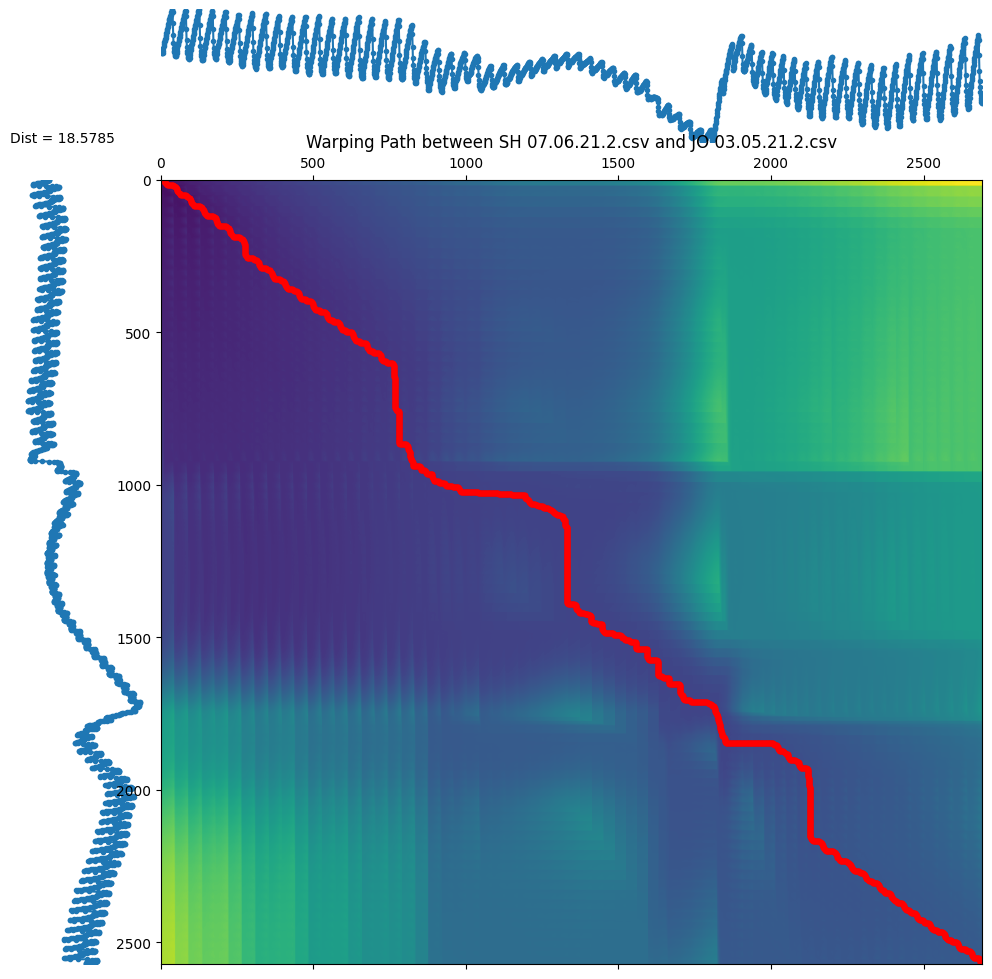

<Figure size 1000x600 with 0 Axes>

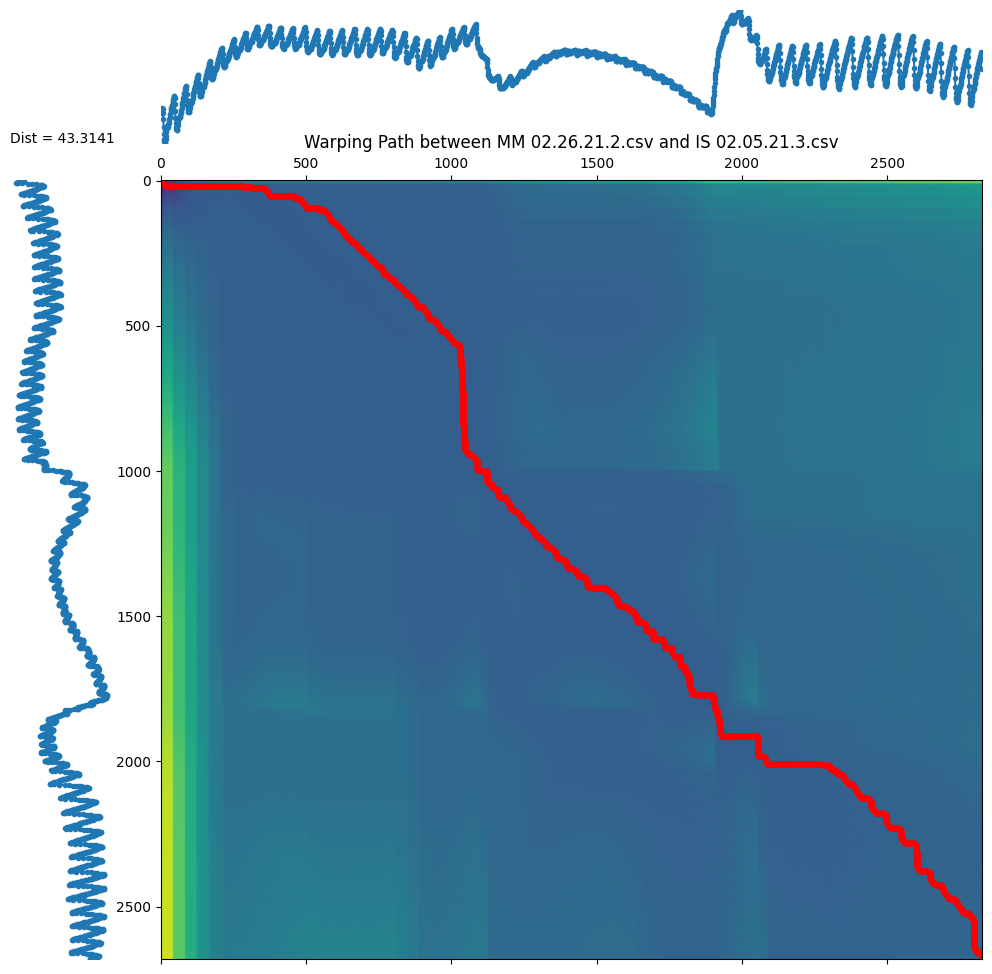

<Figure size 1000x600 with 0 Axes>

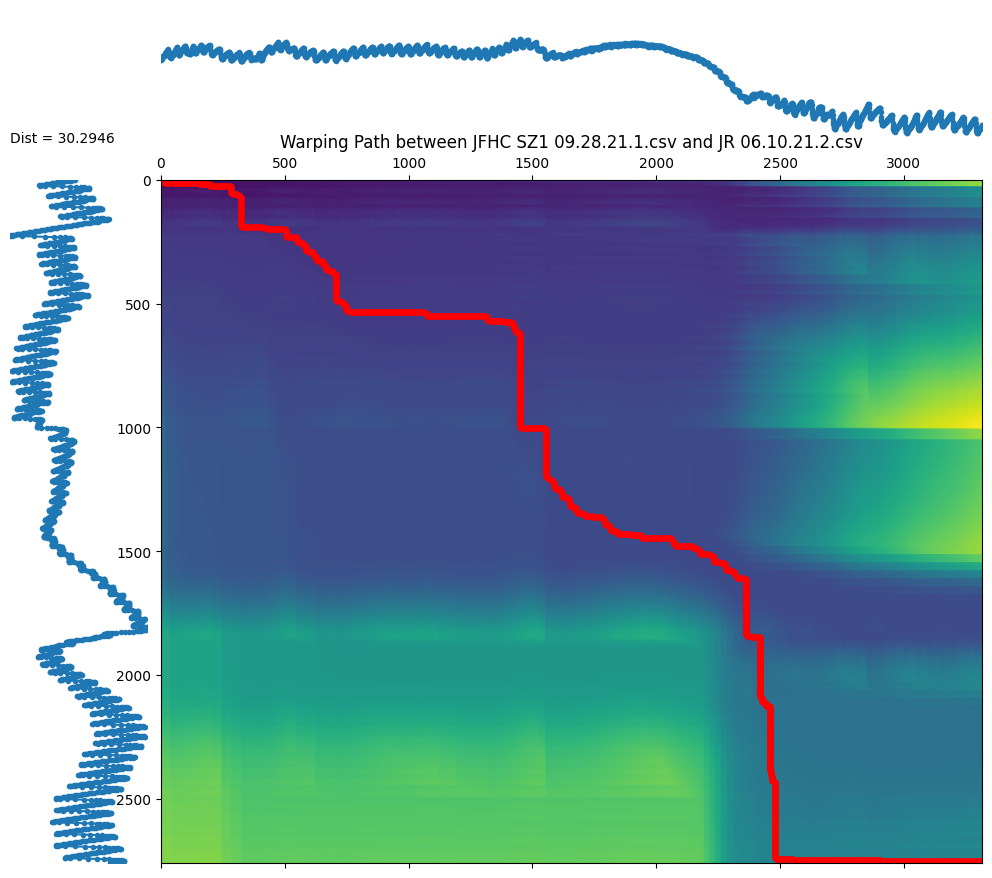

<Figure size 1000x600 with 0 Axes>

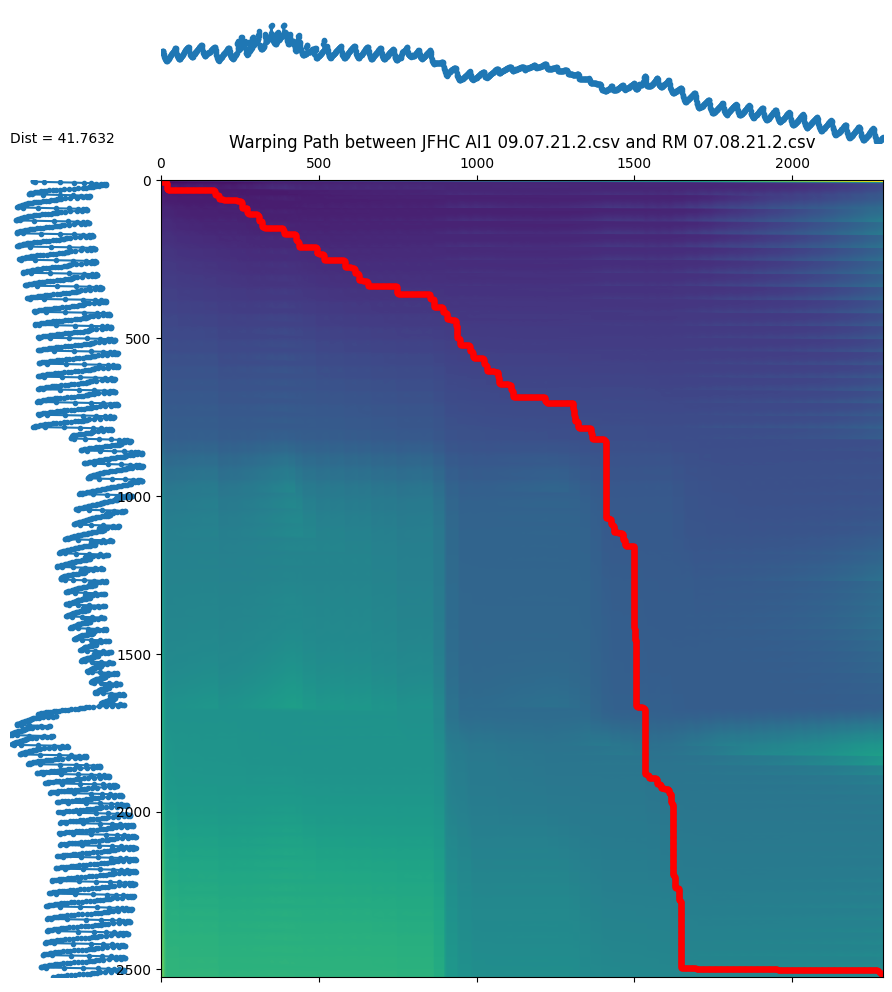

<Figure size 1000x600 with 0 Axes>

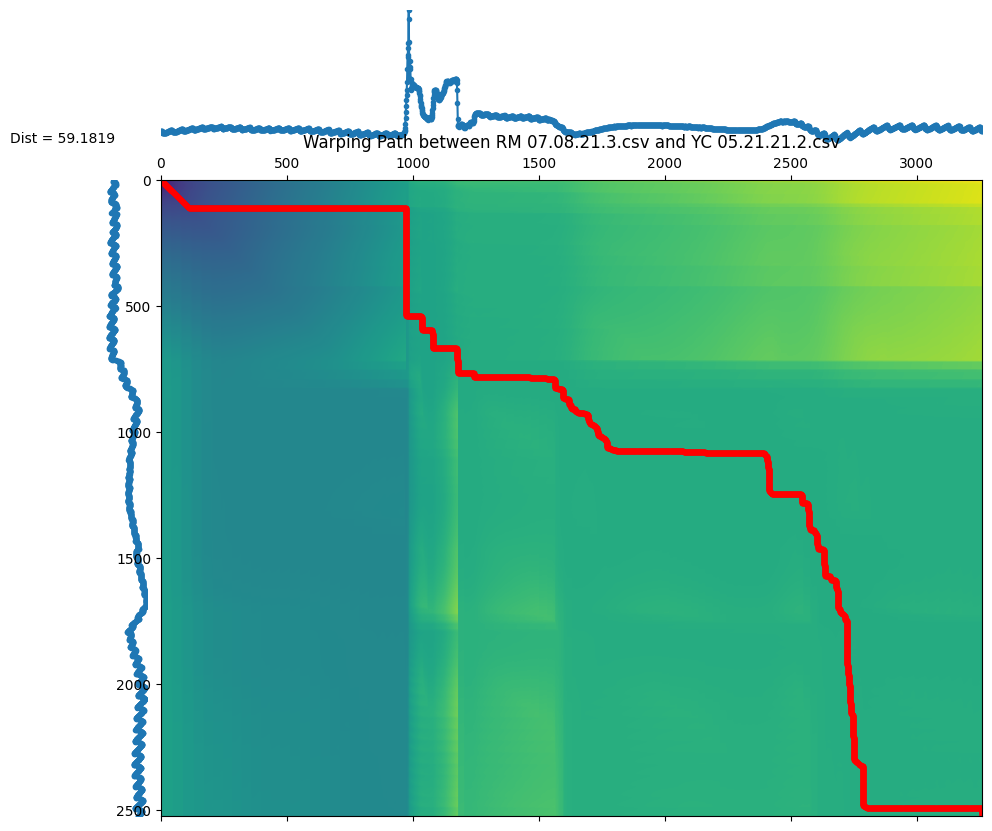

<Figure size 1000x600 with 0 Axes>

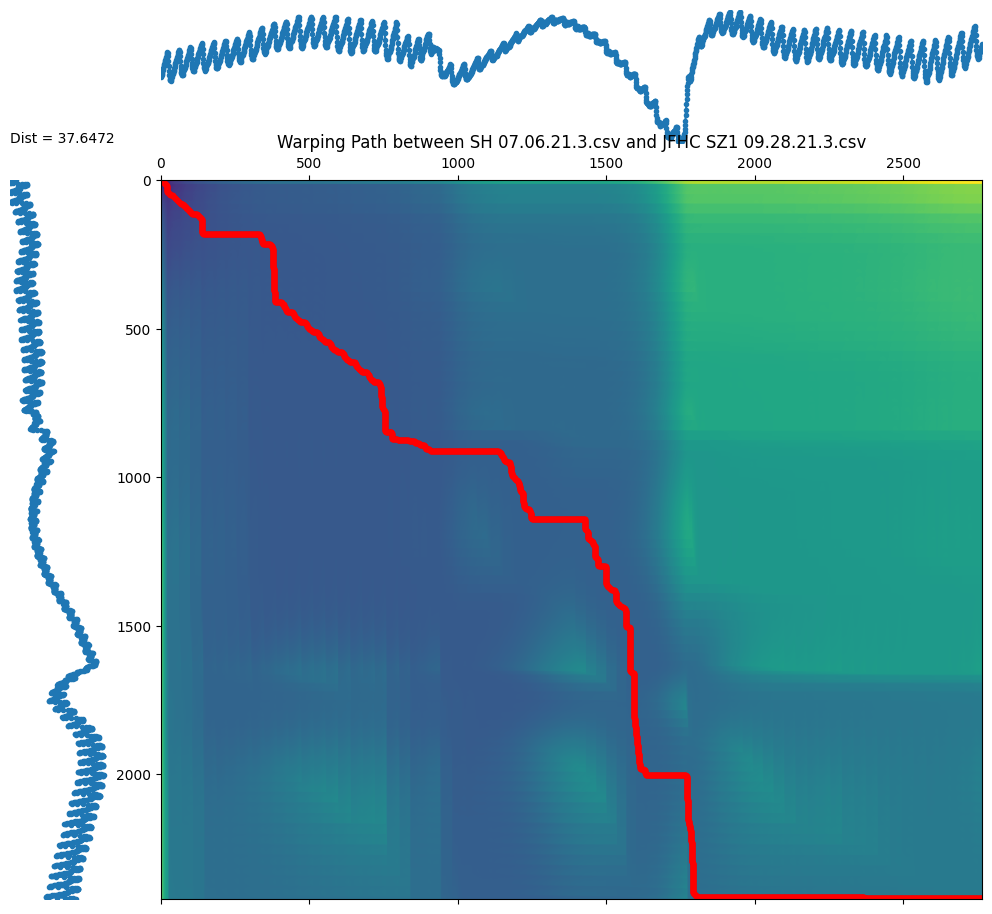

<Figure size 1000x600 with 0 Axes>

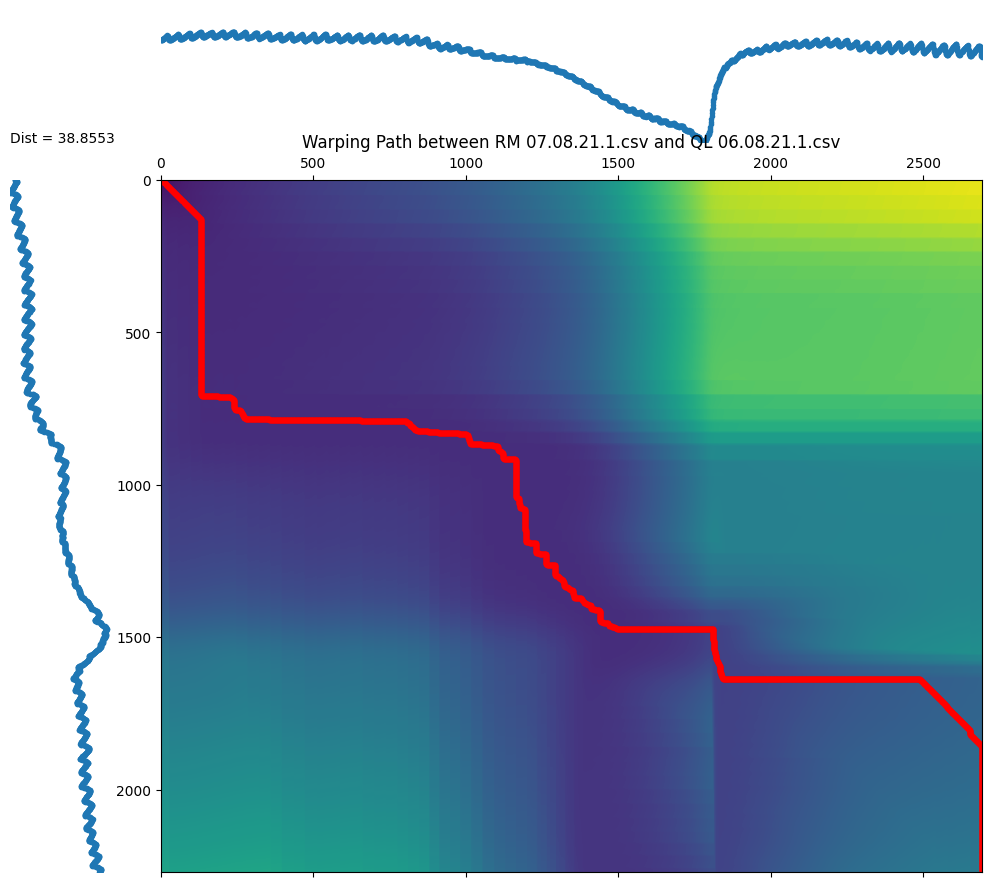

<Figure size 1000x600 with 0 Axes>

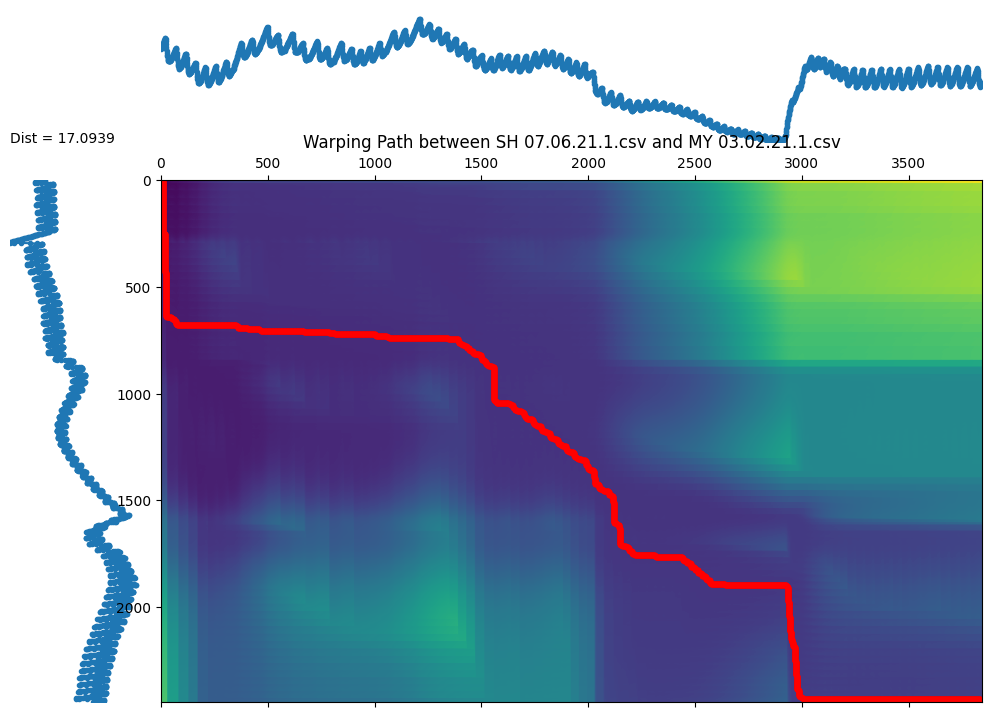

<Figure size 1000x600 with 0 Axes>

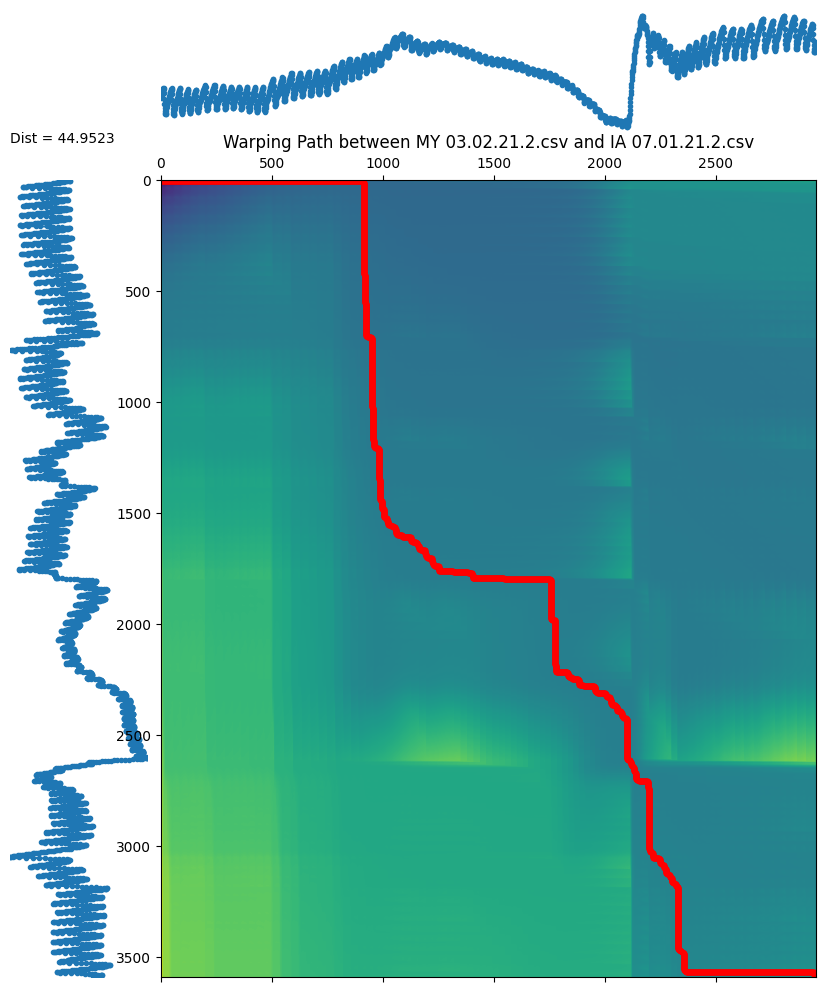

<Figure size 1000x600 with 0 Axes>

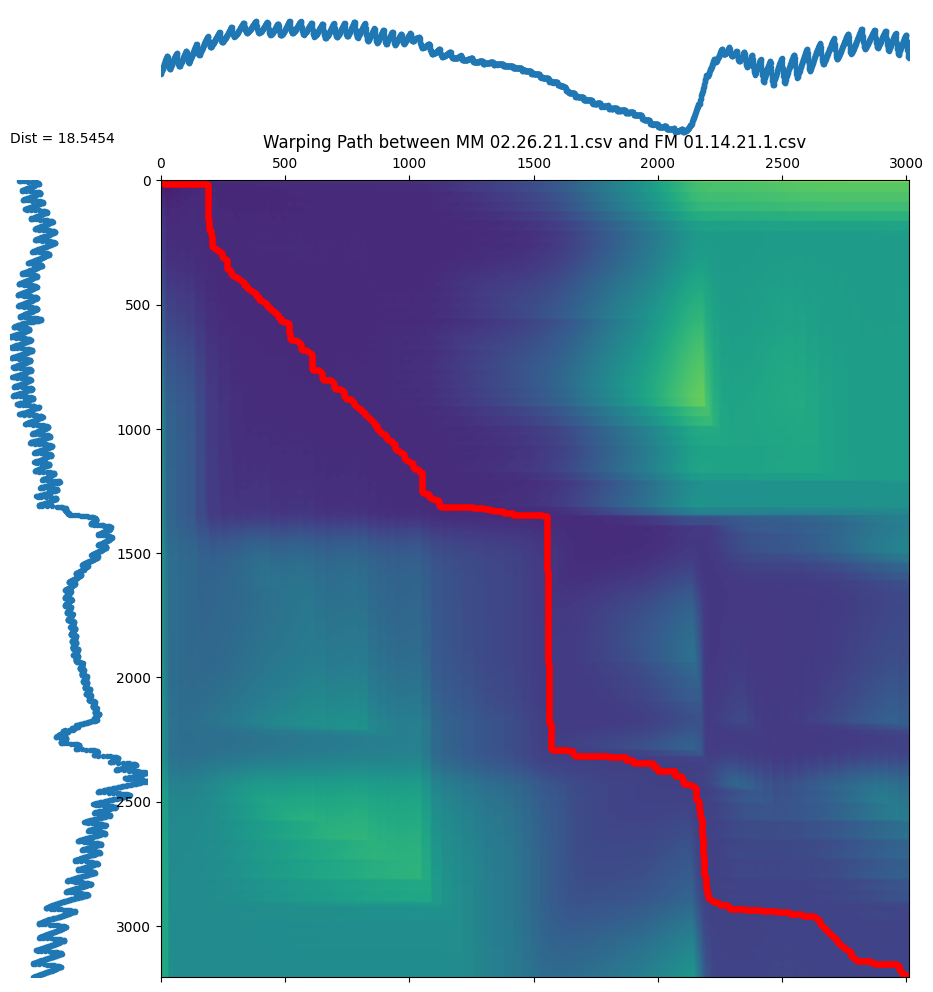

<Figure size 1000x600 with 0 Axes>

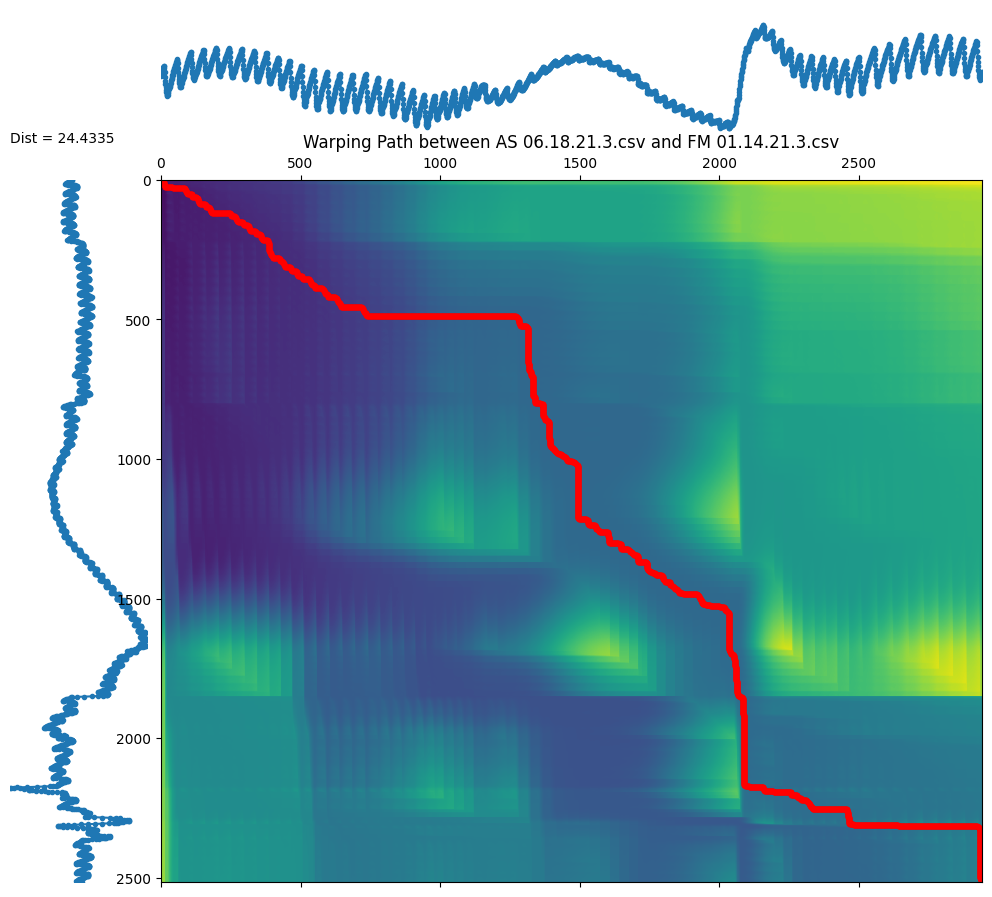

<Figure size 1000x600 with 0 Axes>

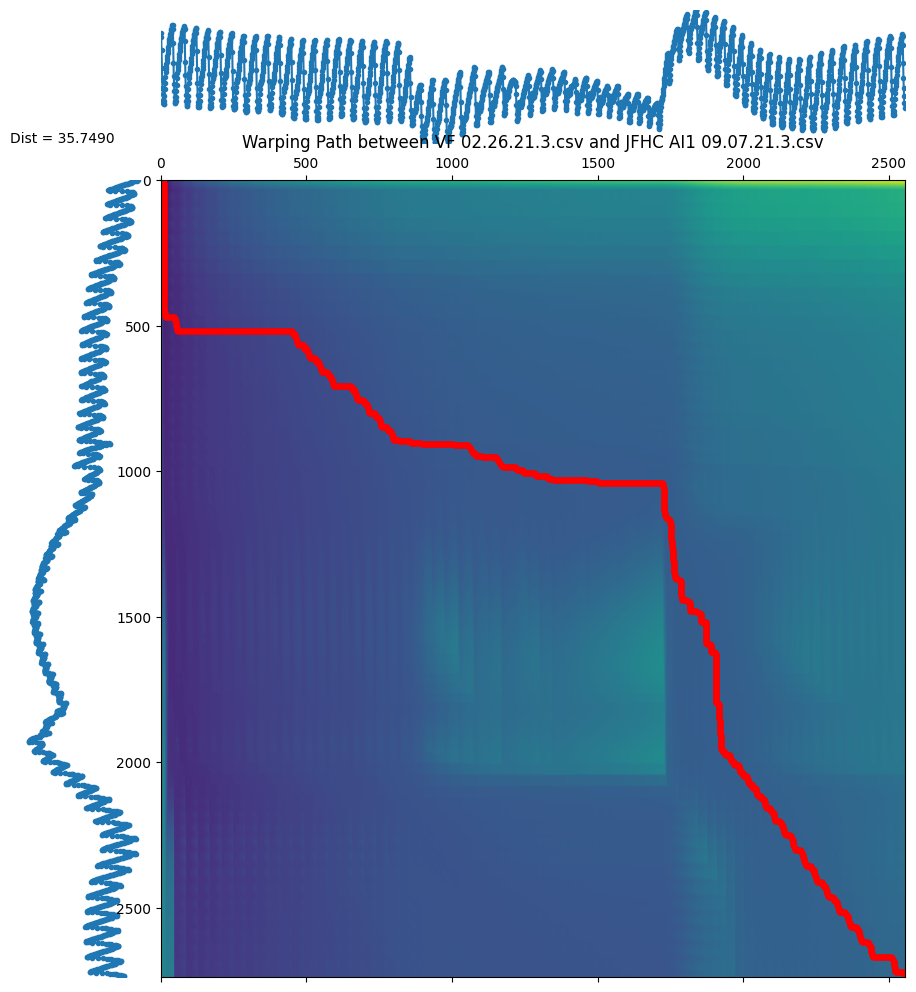

<Figure size 1000x600 with 0 Axes>

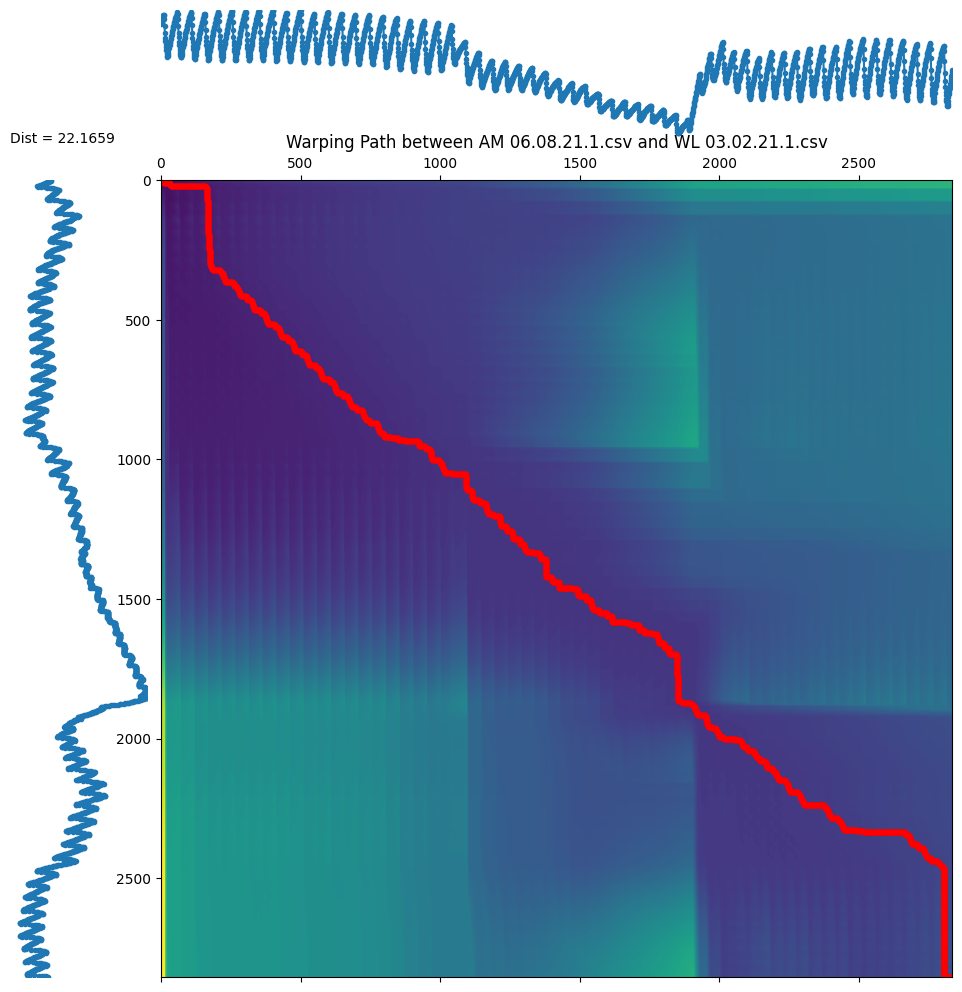

<Figure size 1000x600 with 0 Axes>

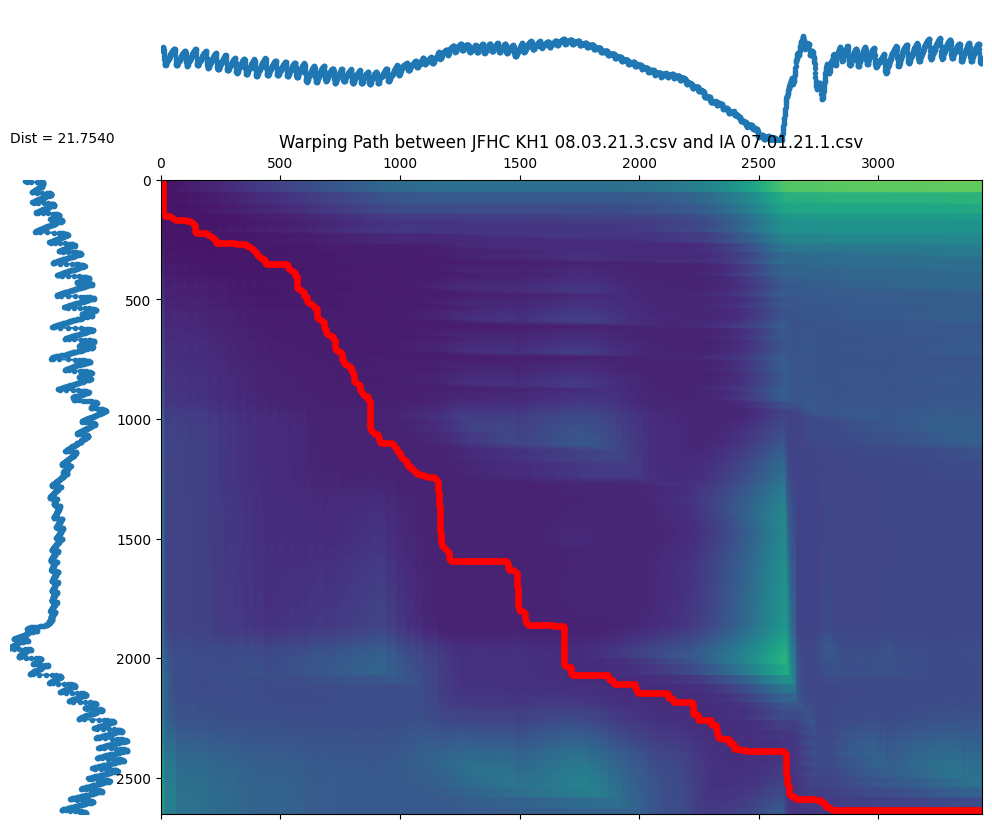

<Figure size 1000x600 with 0 Axes>

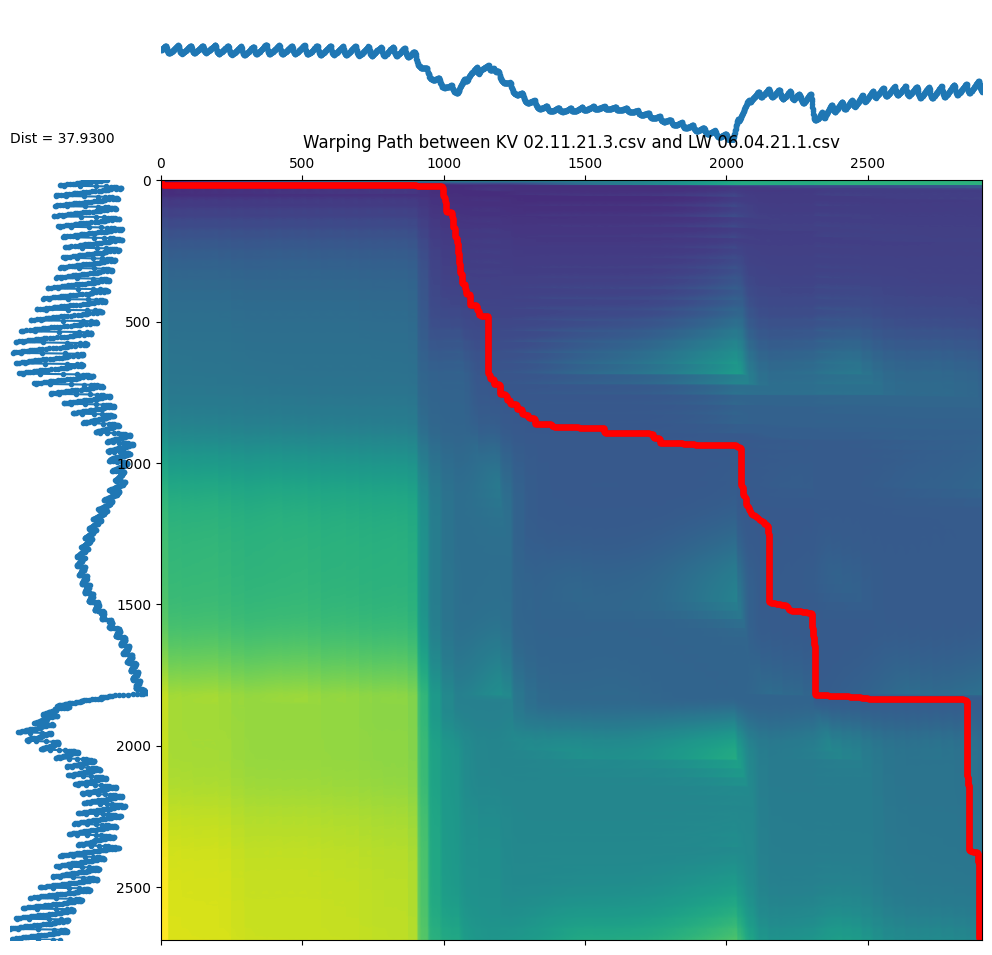

<Figure size 1000x600 with 0 Axes>

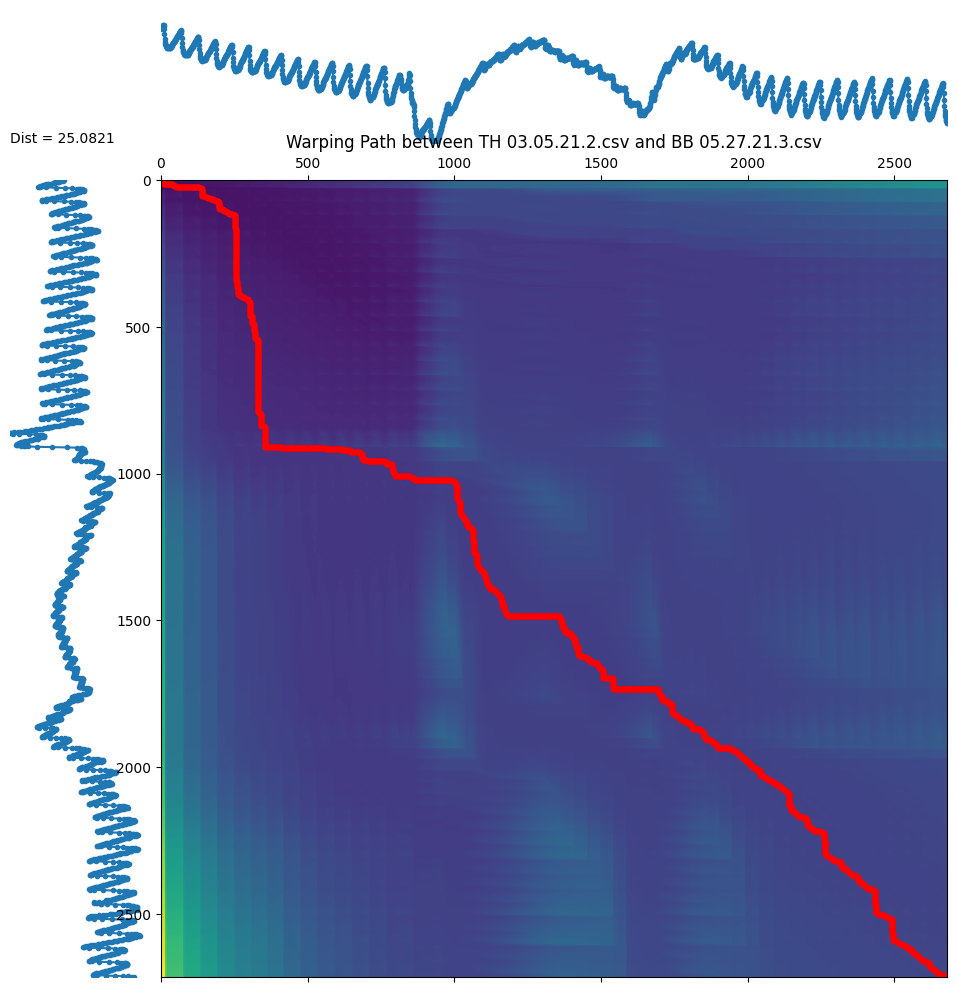

<Figure size 1000x600 with 0 Axes>

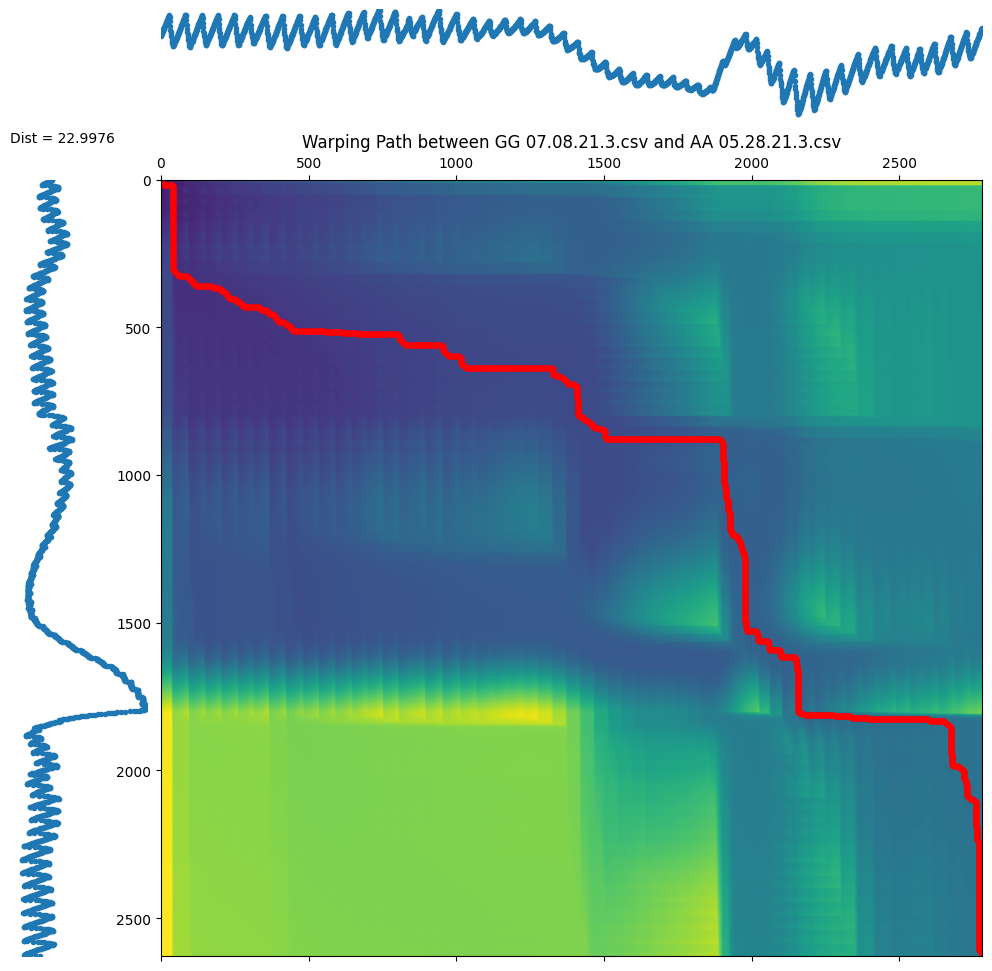

<Figure size 1000x600 with 0 Axes>

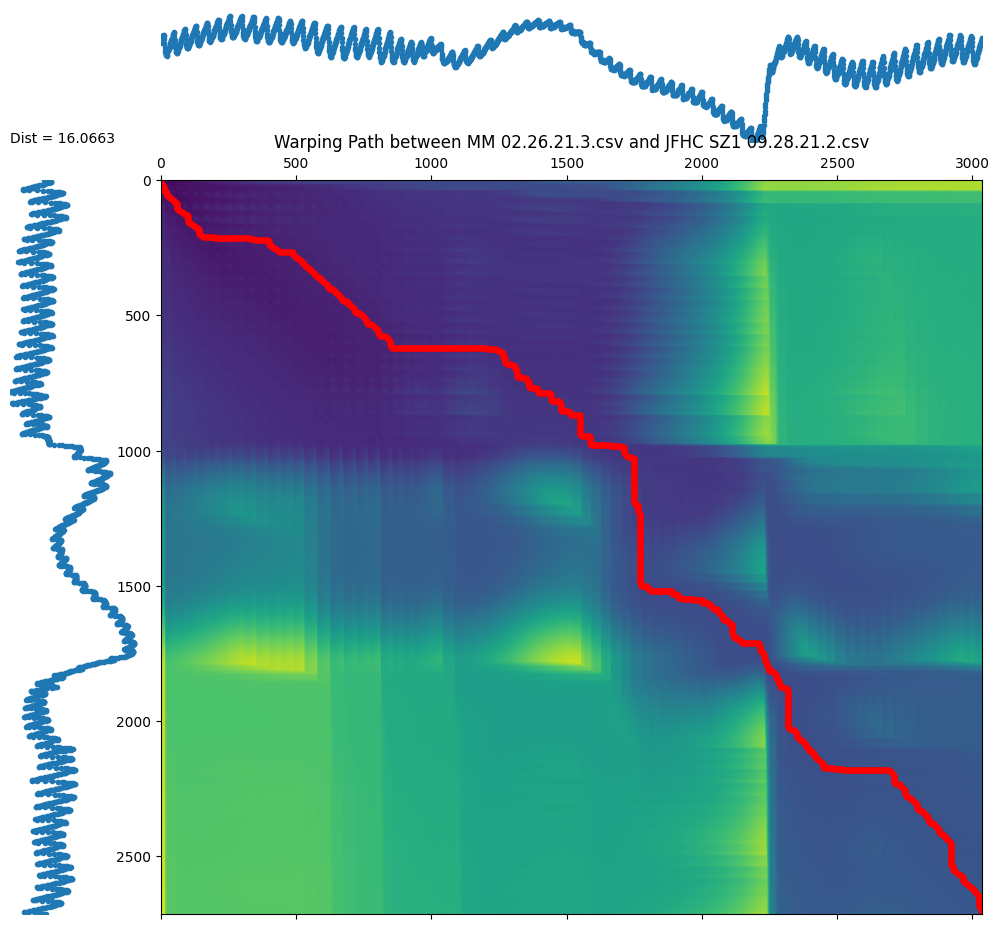

<Figure size 1000x600 with 0 Axes>

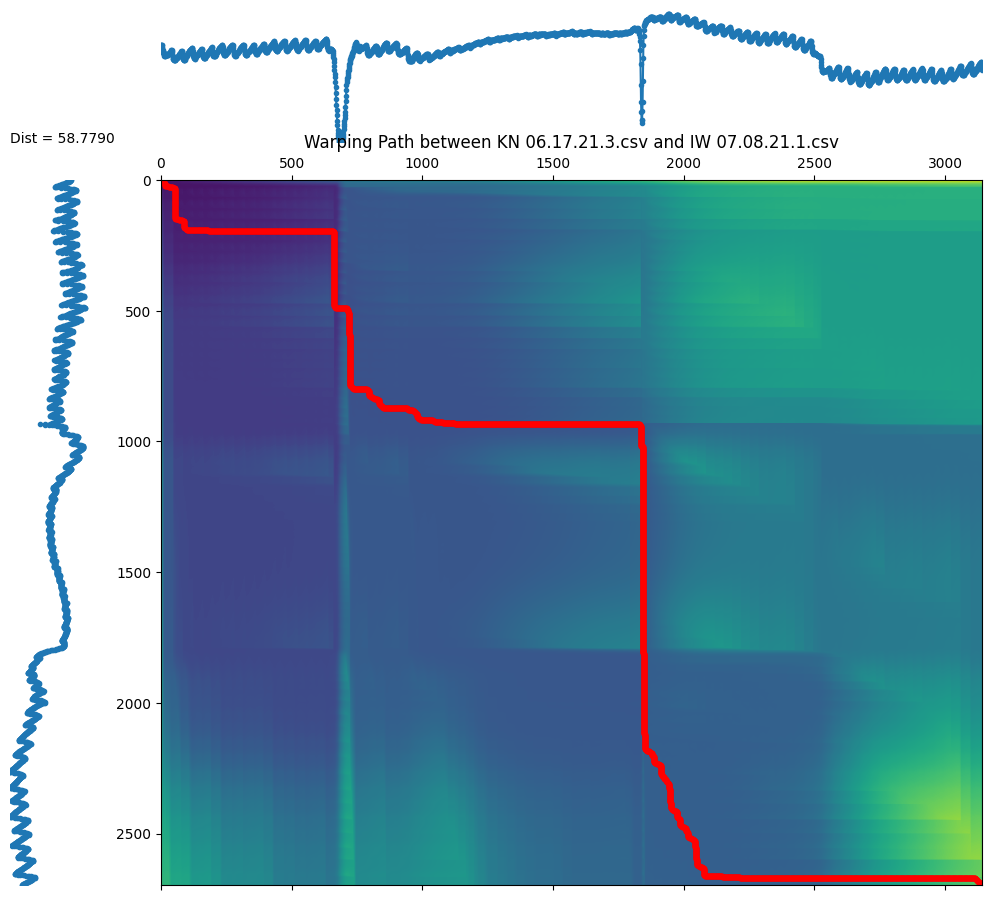

<Figure size 1000x600 with 0 Axes>

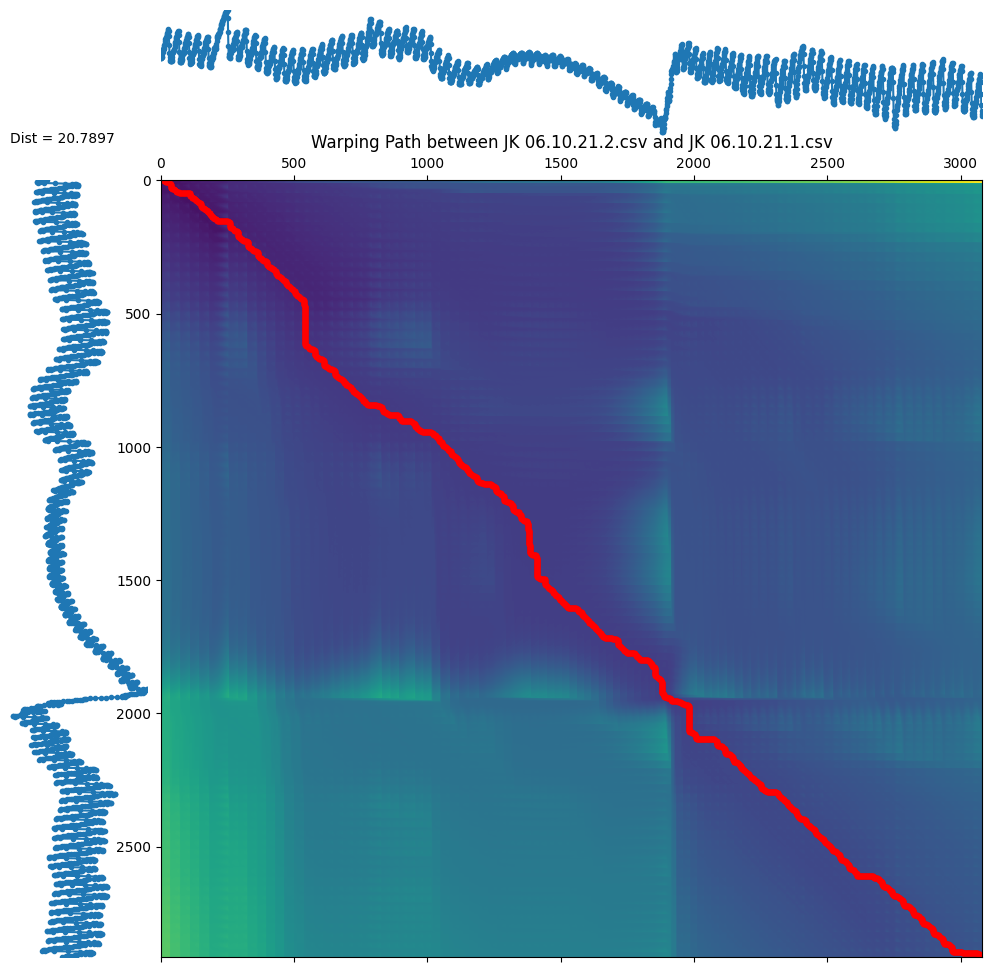

<Figure size 1000x600 with 0 Axes>

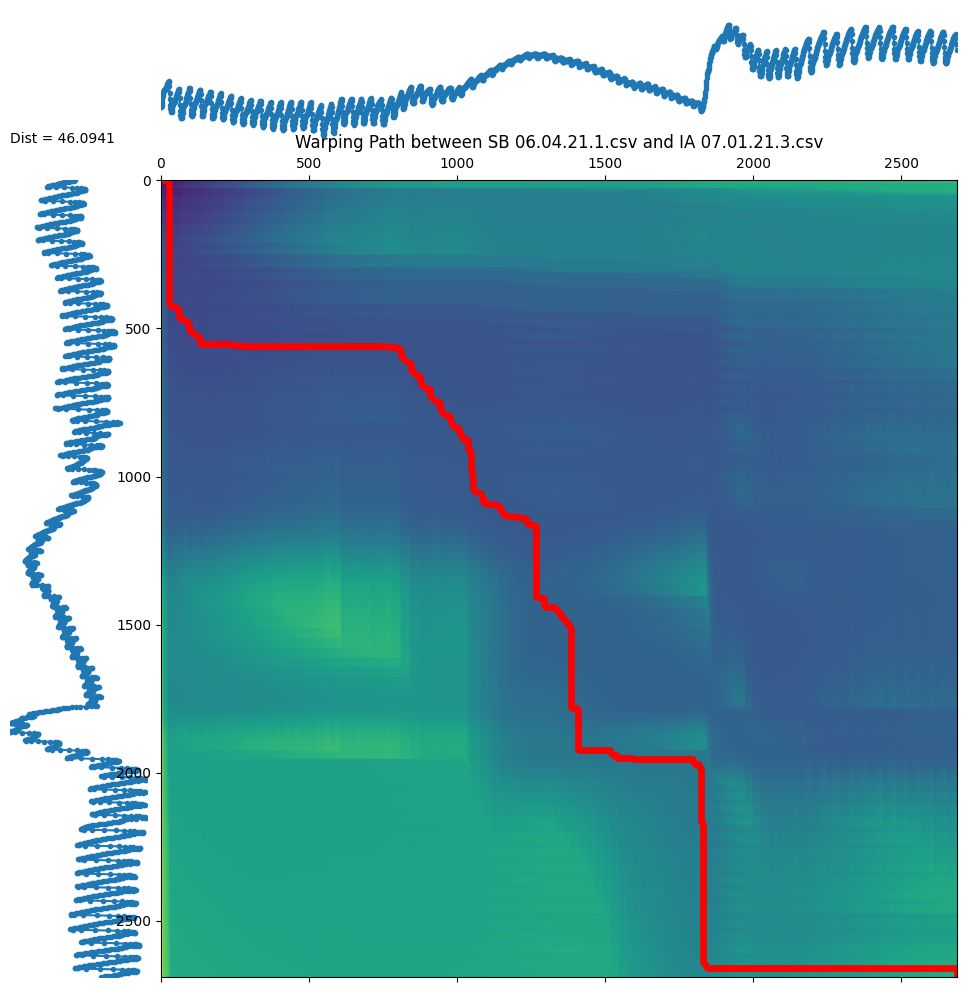

<Figure size 1000x600 with 0 Axes>

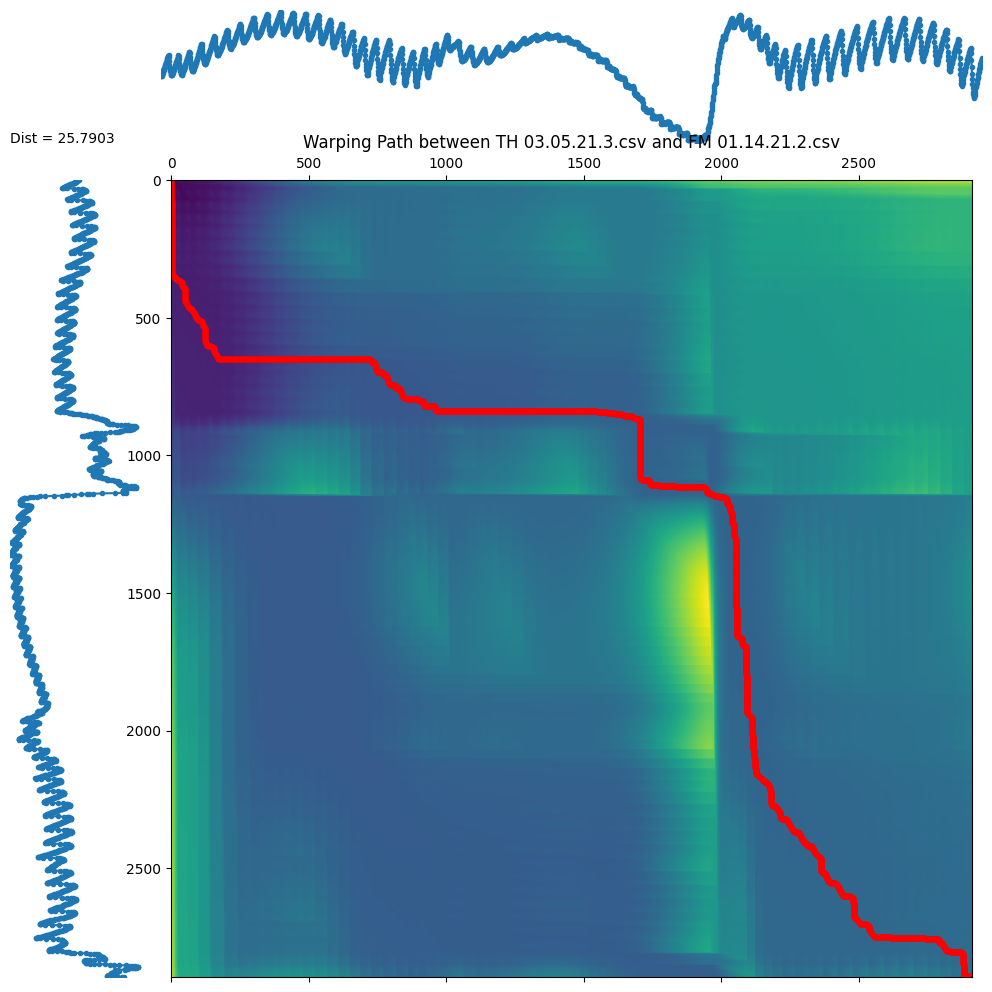

<Figure size 1000x600 with 0 Axes>

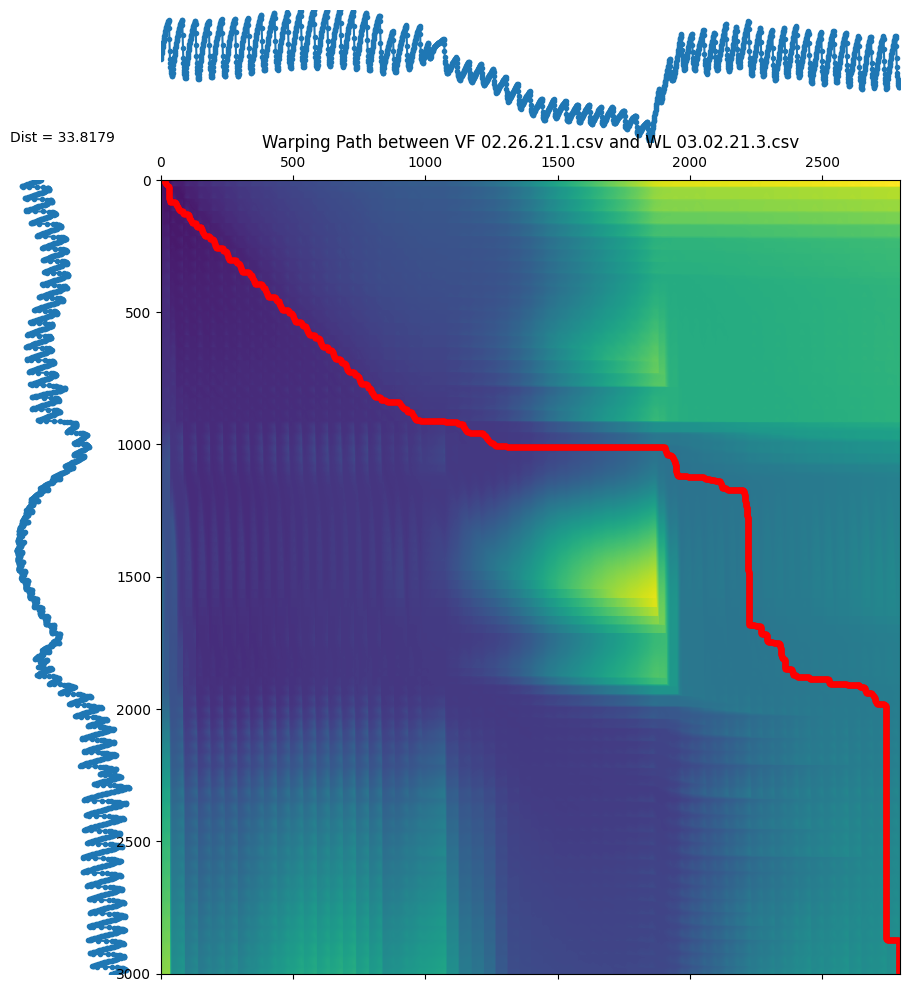

<Figure size 1000x600 with 0 Axes>

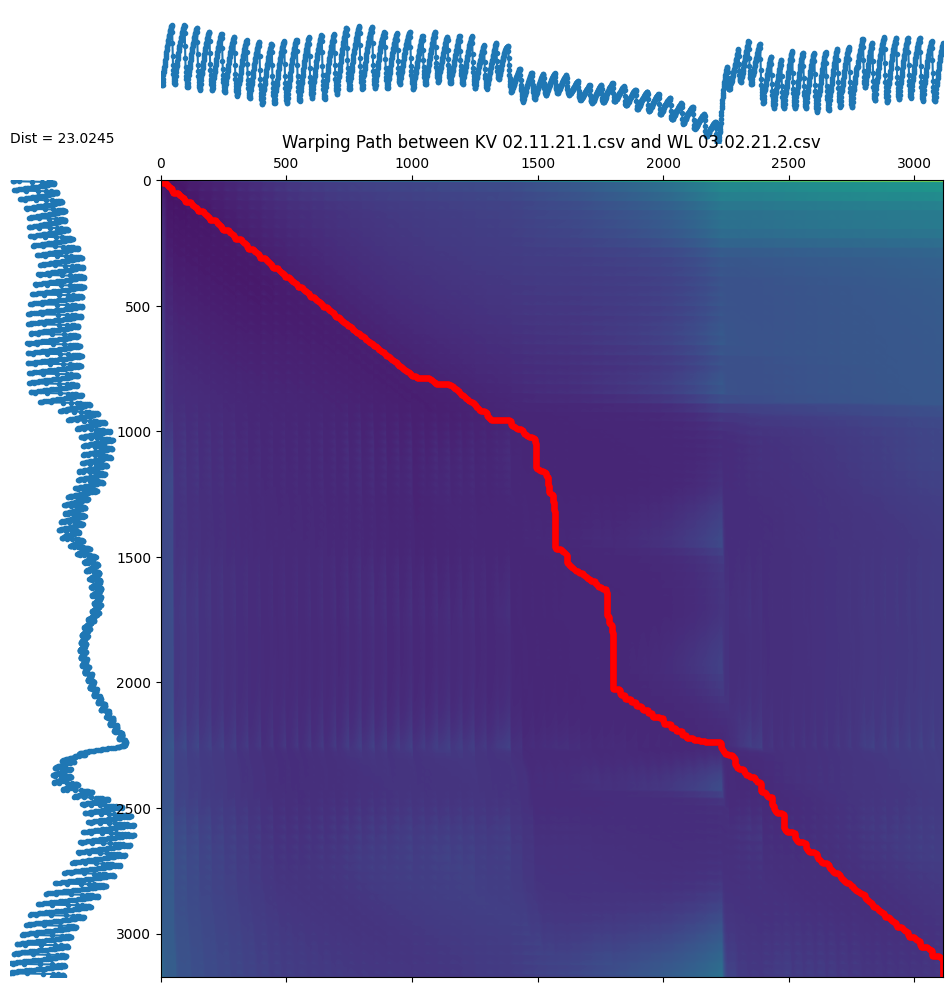

<Figure size 1000x600 with 0 Axes>

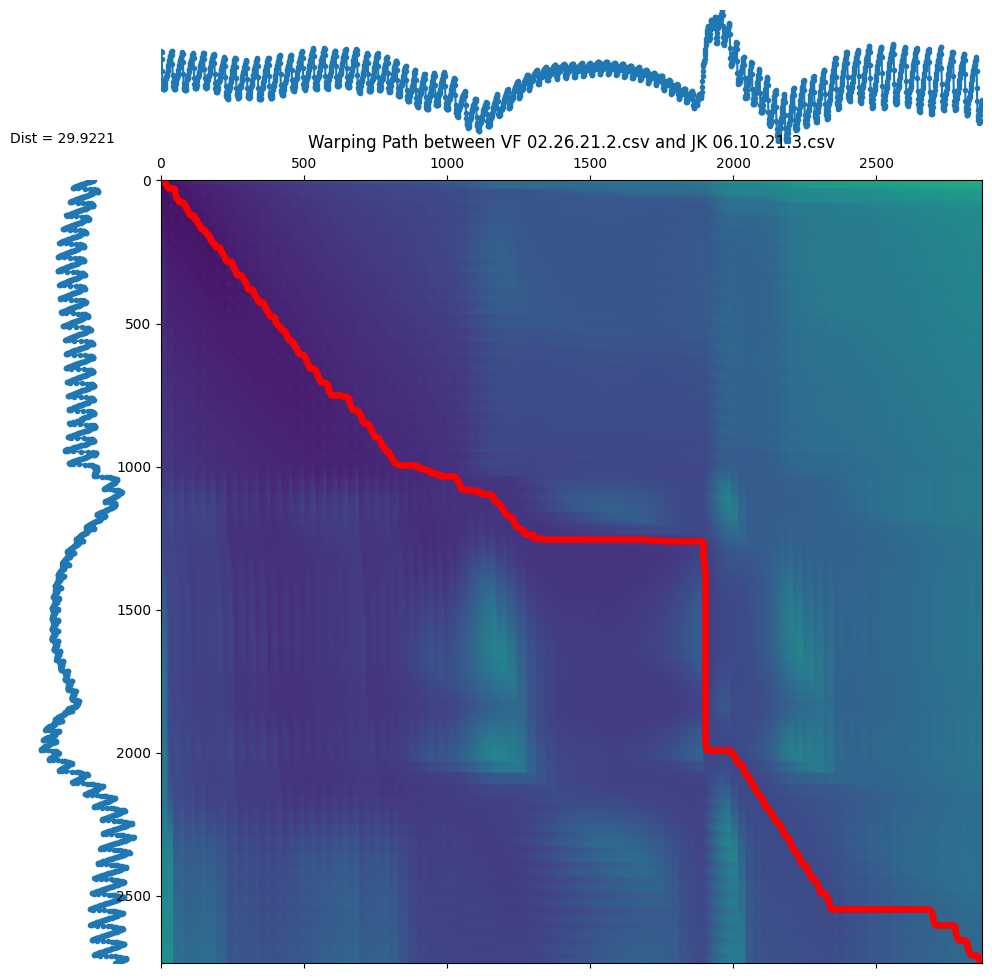

<Figure size 1000x600 with 0 Axes>

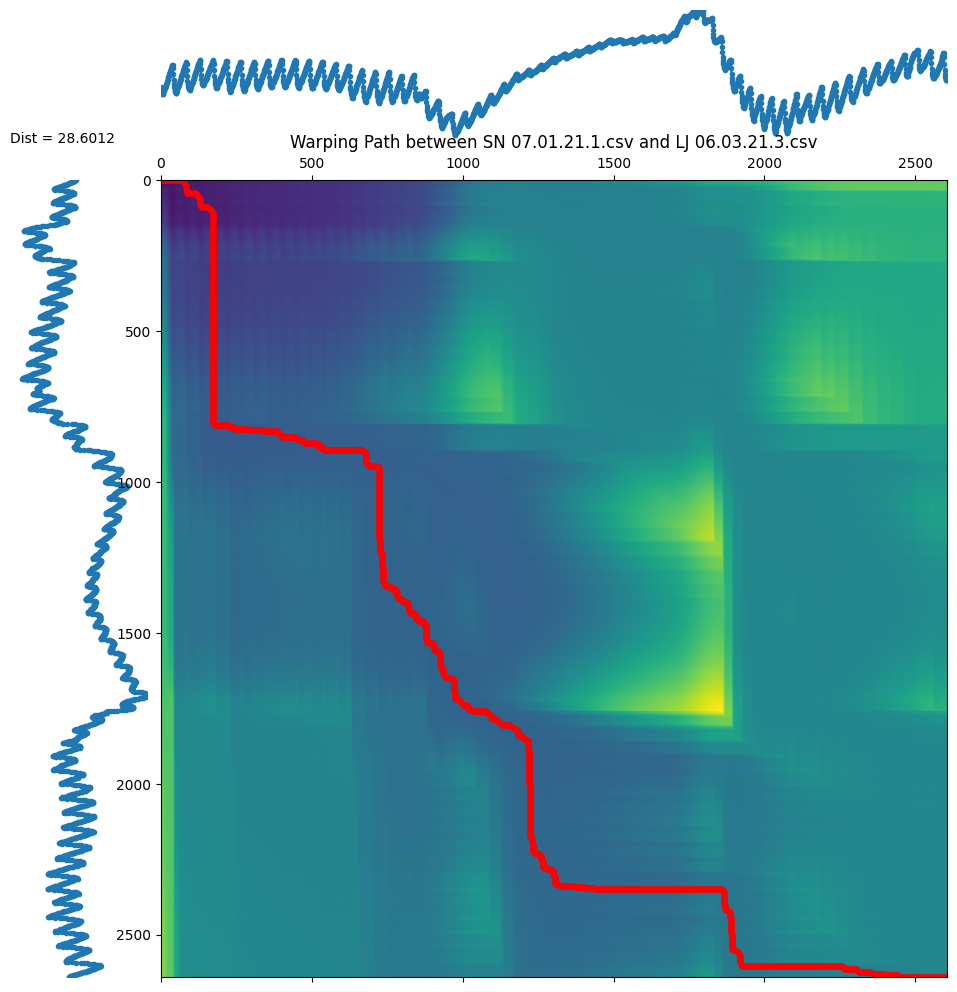

<Figure size 1000x600 with 0 Axes>

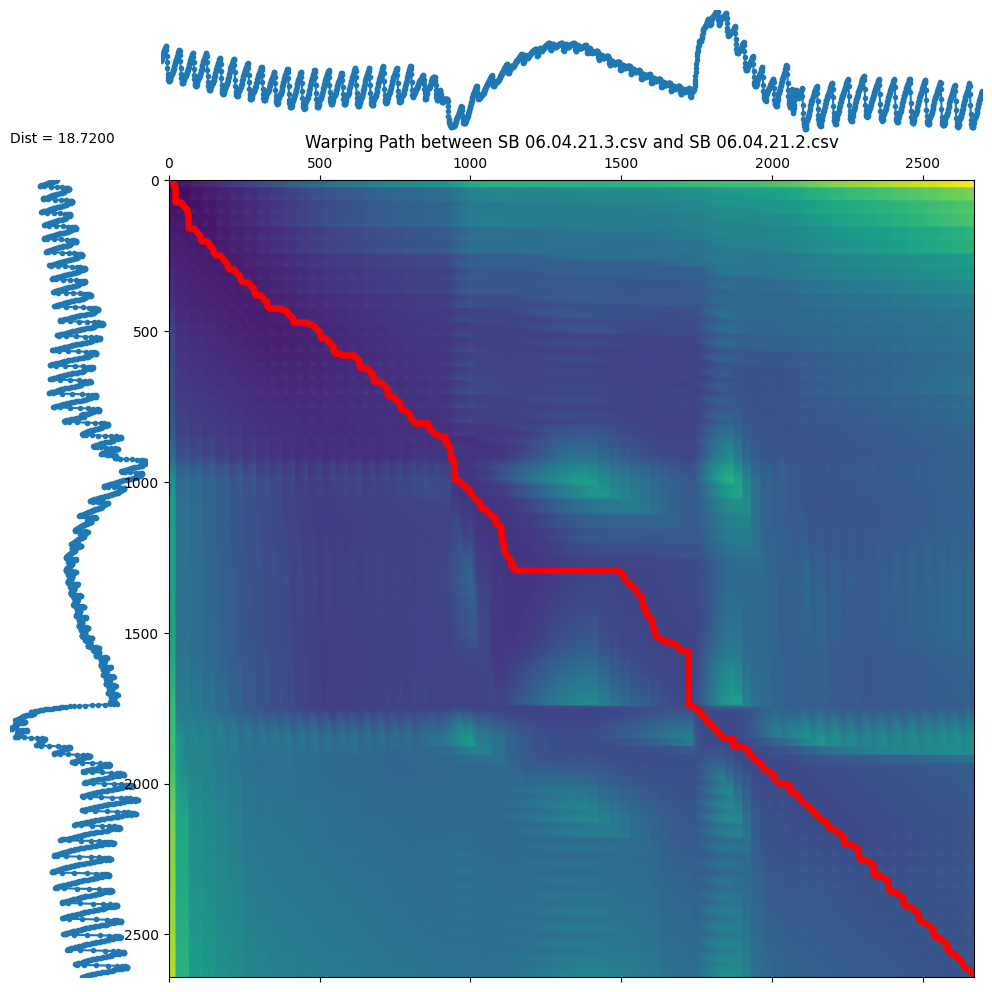

<Figure size 1000x600 with 0 Axes>

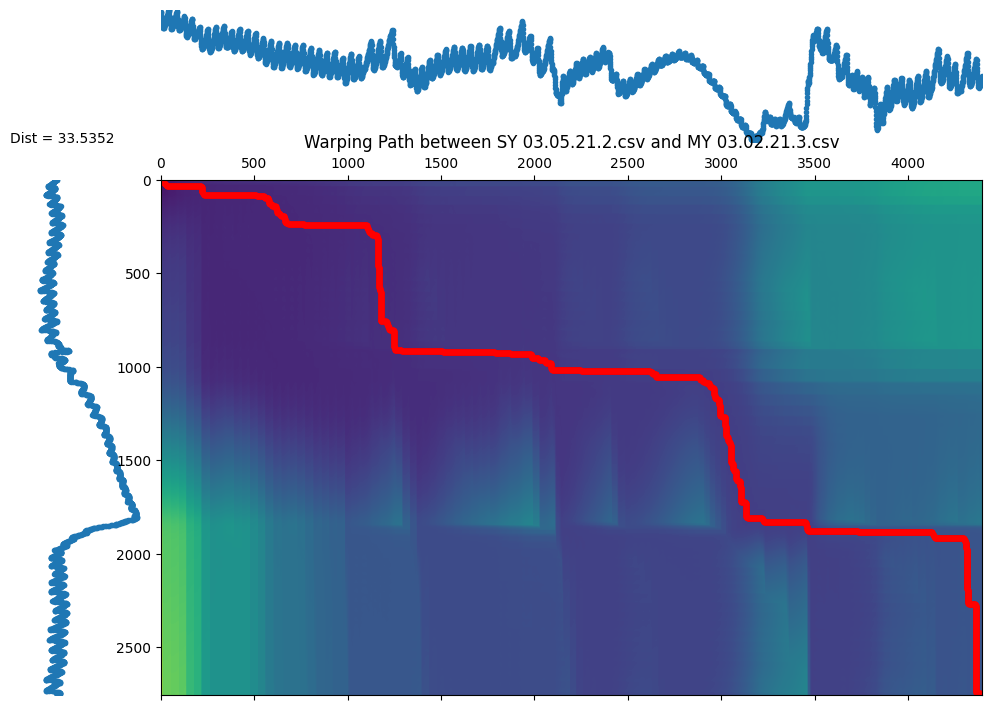

<Figure size 1000x600 with 0 Axes>

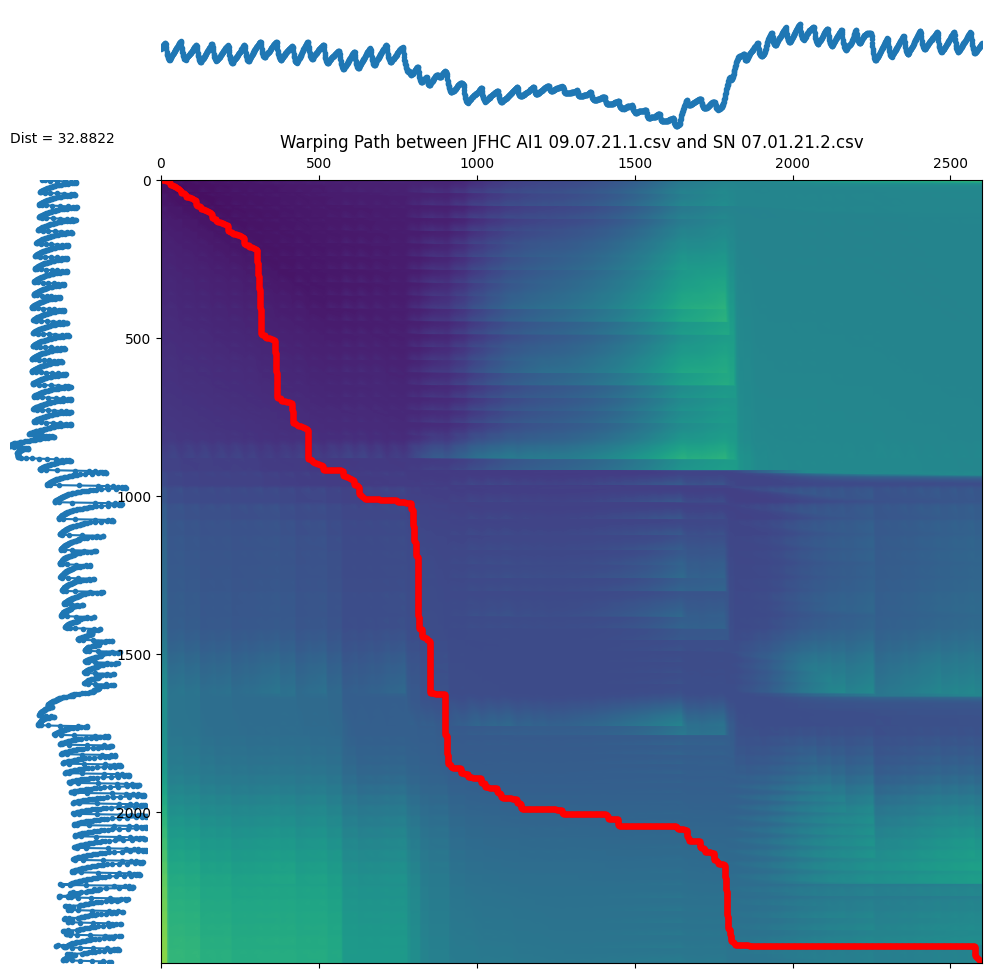

<Figure size 1000x600 with 0 Axes>

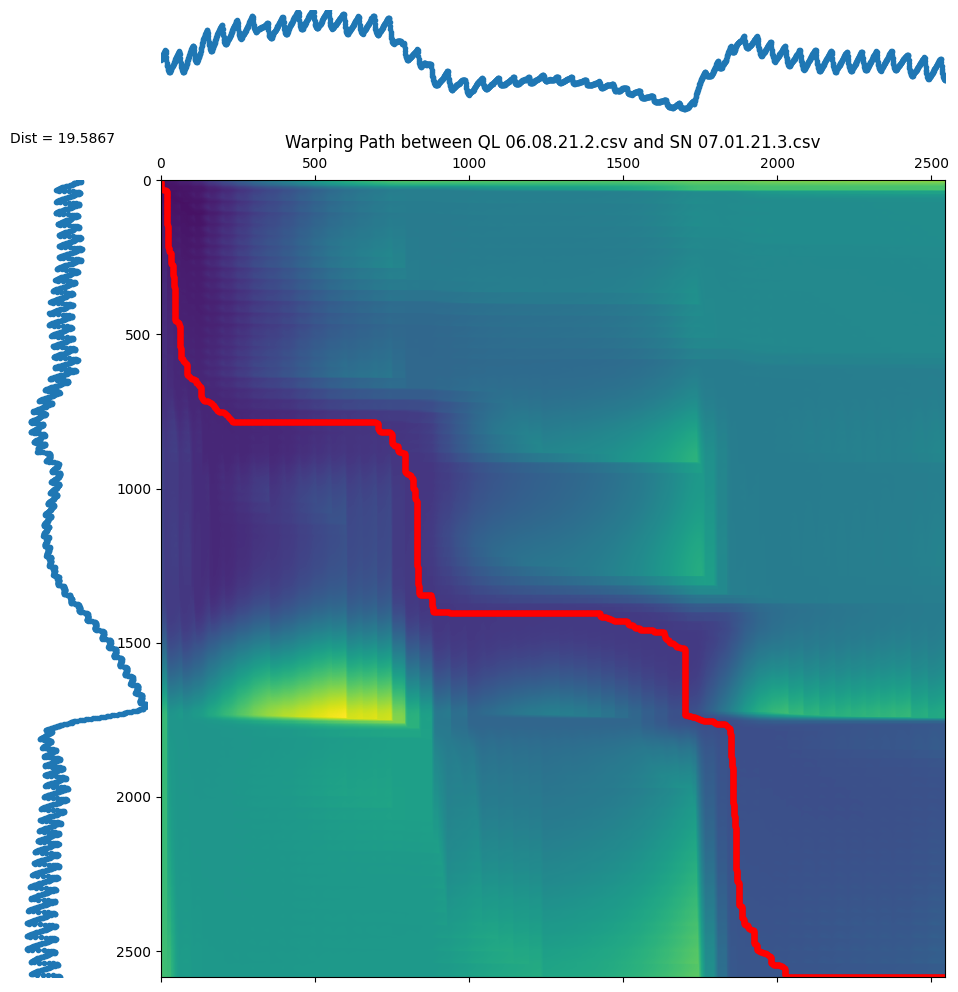

<Figure size 1000x600 with 0 Axes>

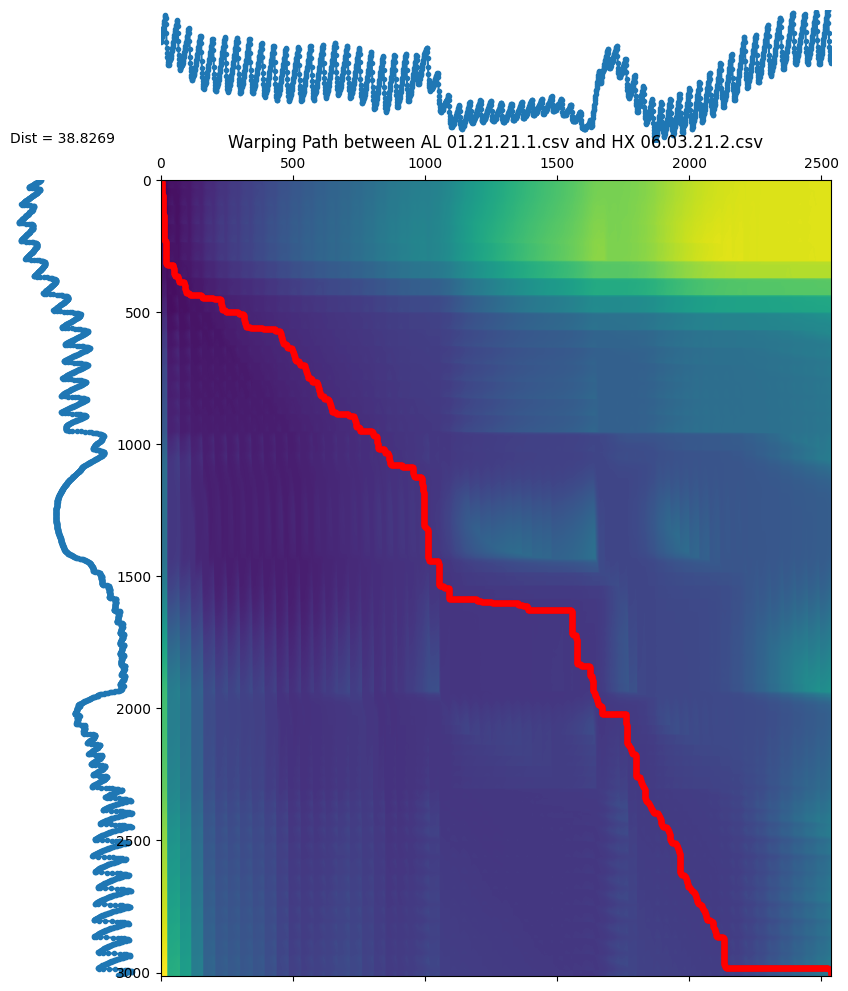

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Calculate 62 unique pairs
num_pairs = 41
selected_pairs = [(goodH_filenames[i], goodH_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals
    signal_1 = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2 = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2}')
    plt.show()


<Figure size 1000x600 with 0 Axes>

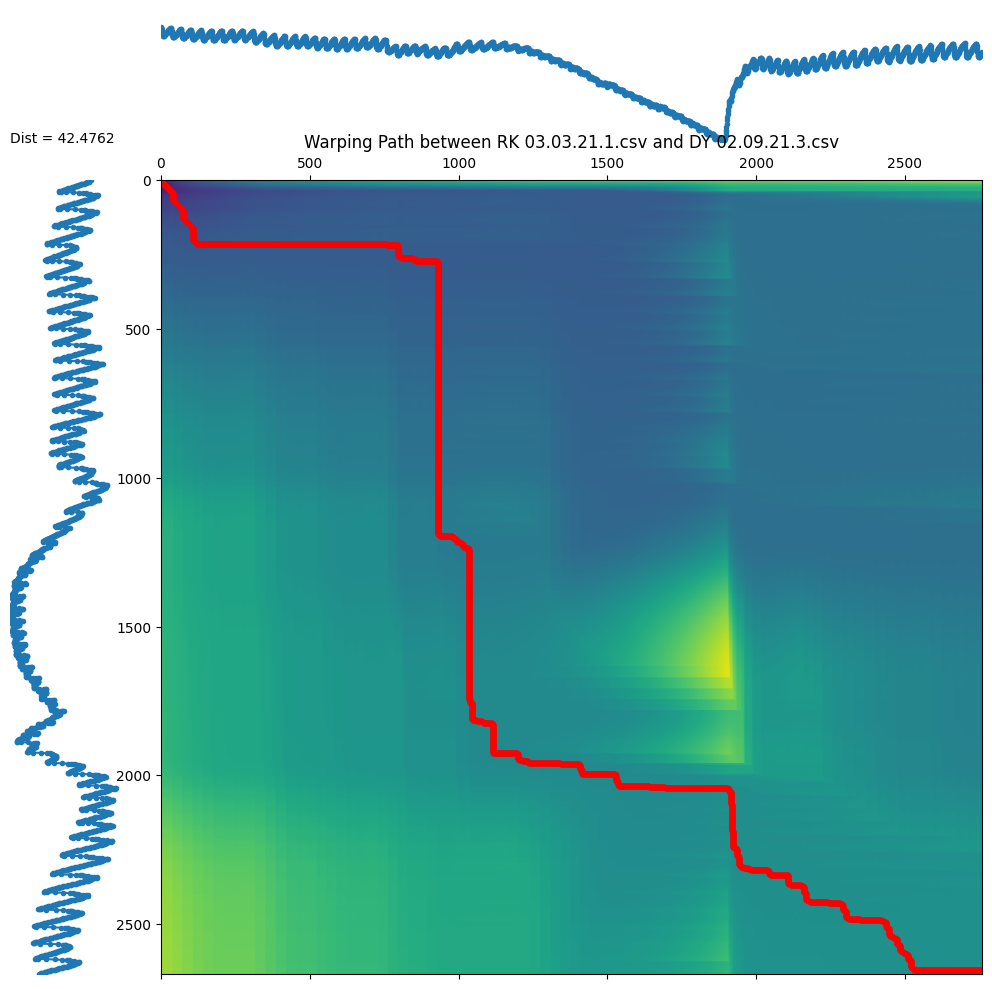

<Figure size 1000x600 with 0 Axes>

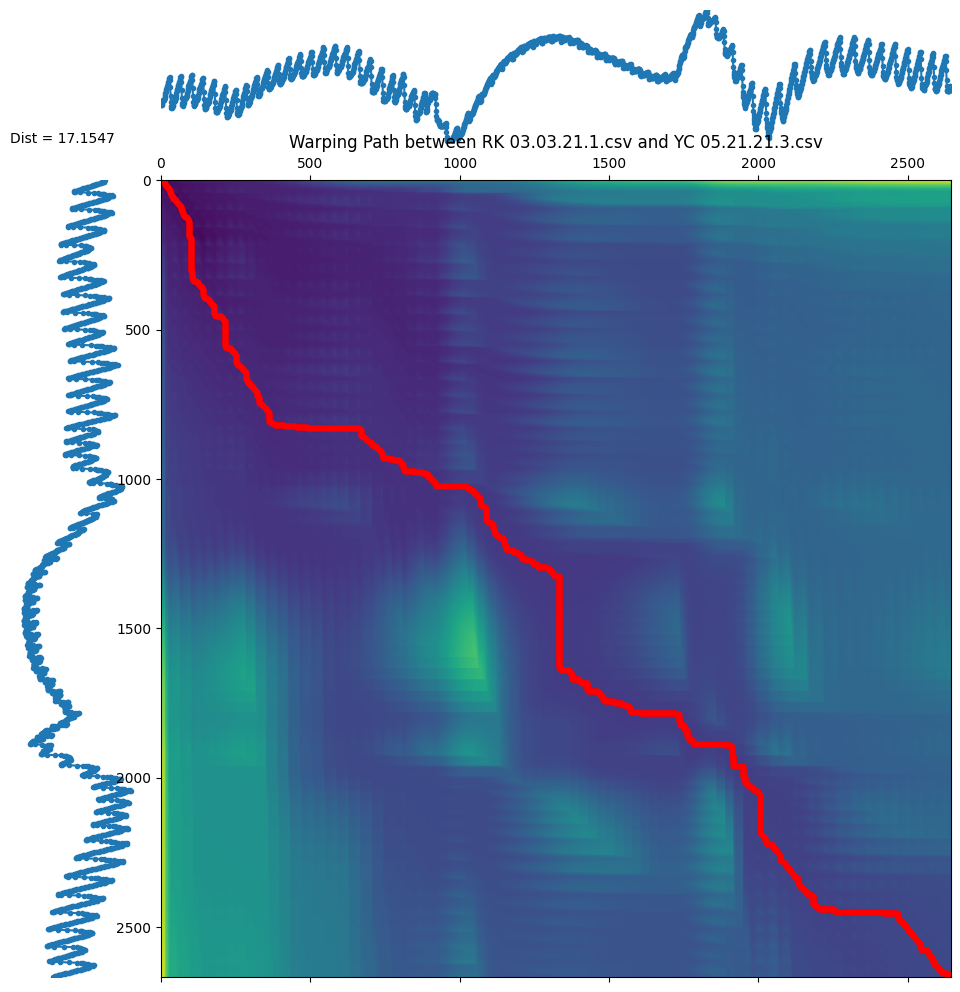

<Figure size 1000x600 with 0 Axes>

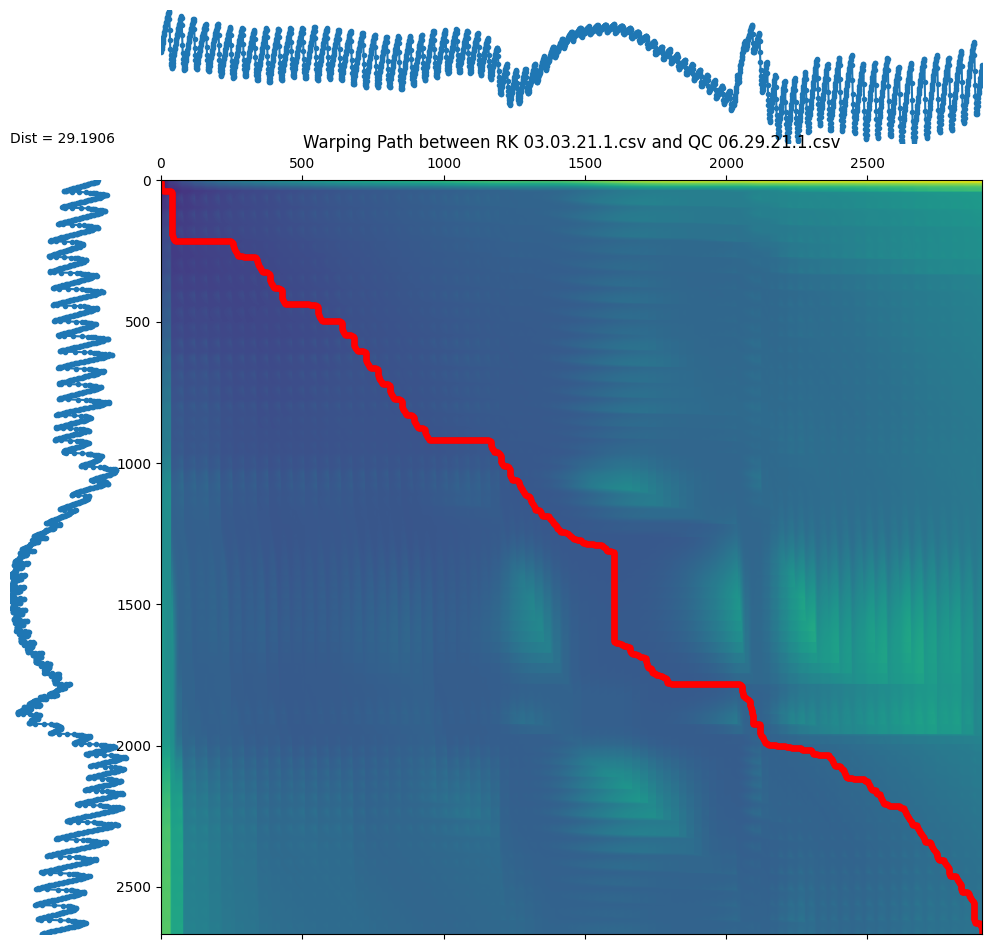

<Figure size 1000x600 with 0 Axes>

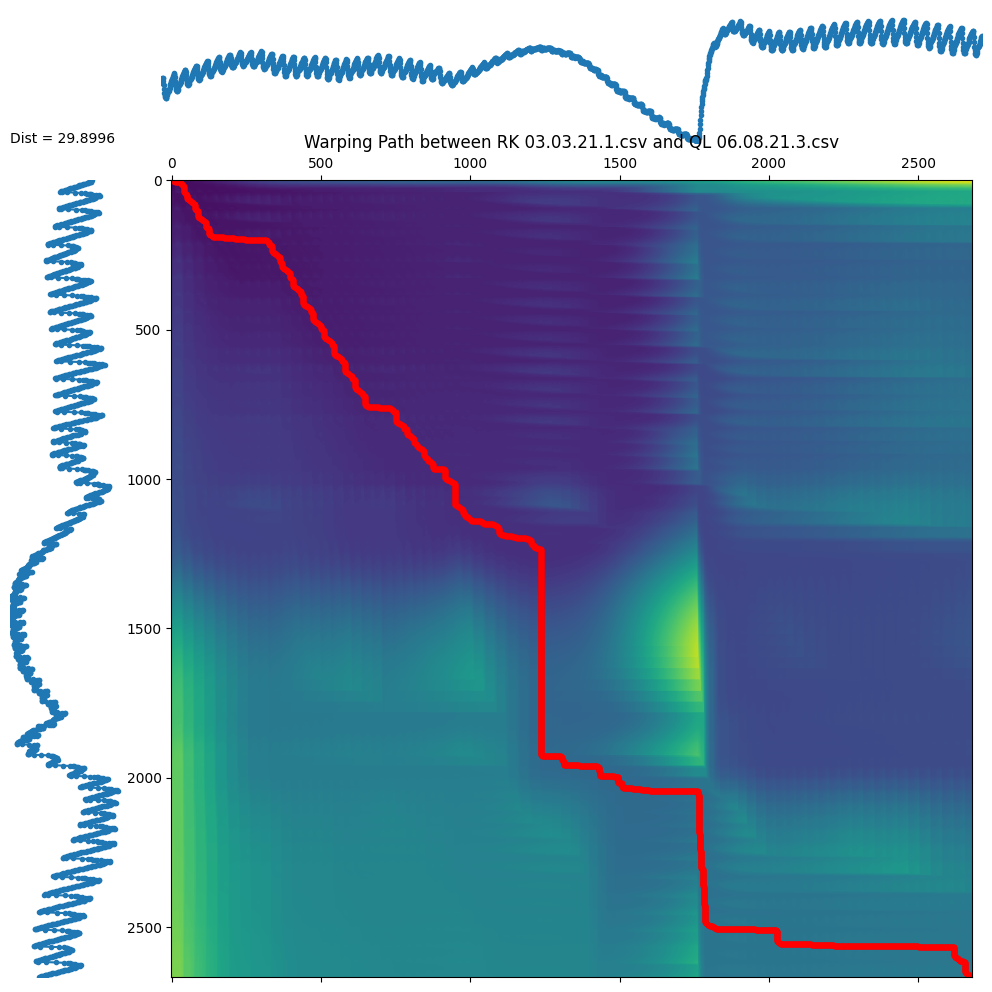

<Figure size 1000x600 with 0 Axes>

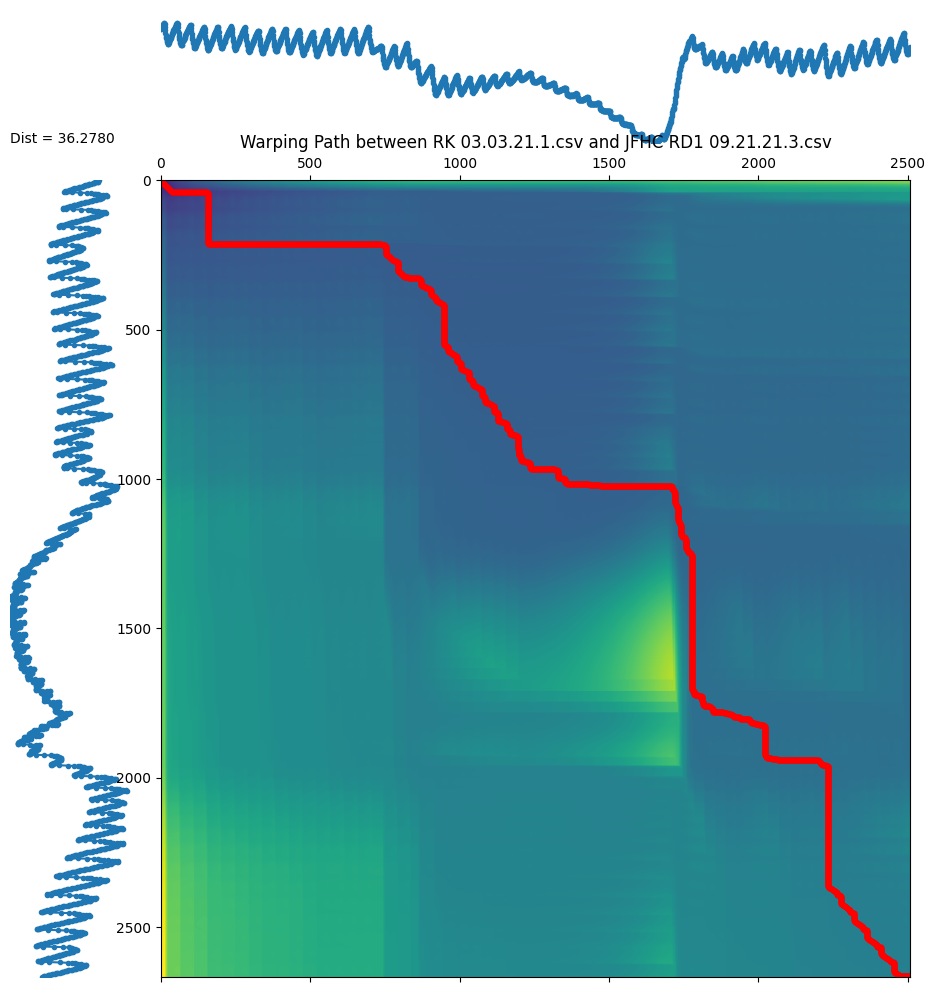

<Figure size 1000x600 with 0 Axes>

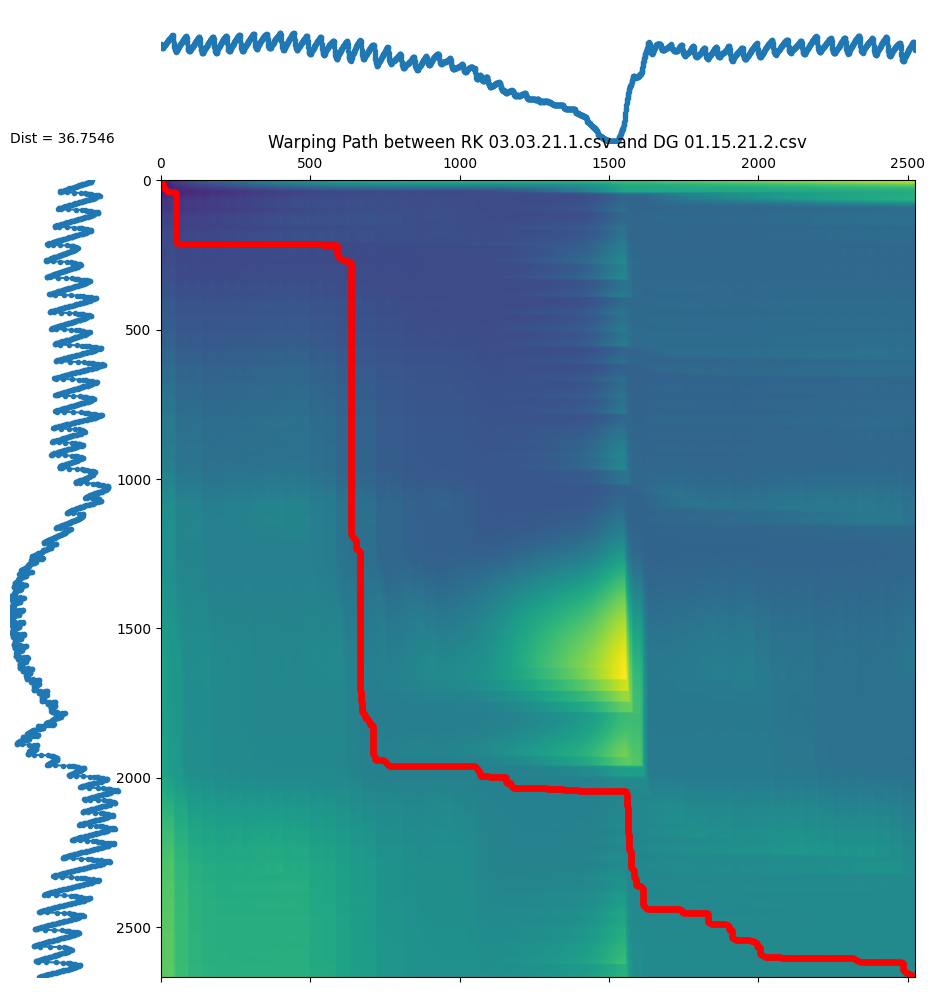

<Figure size 1000x600 with 0 Axes>

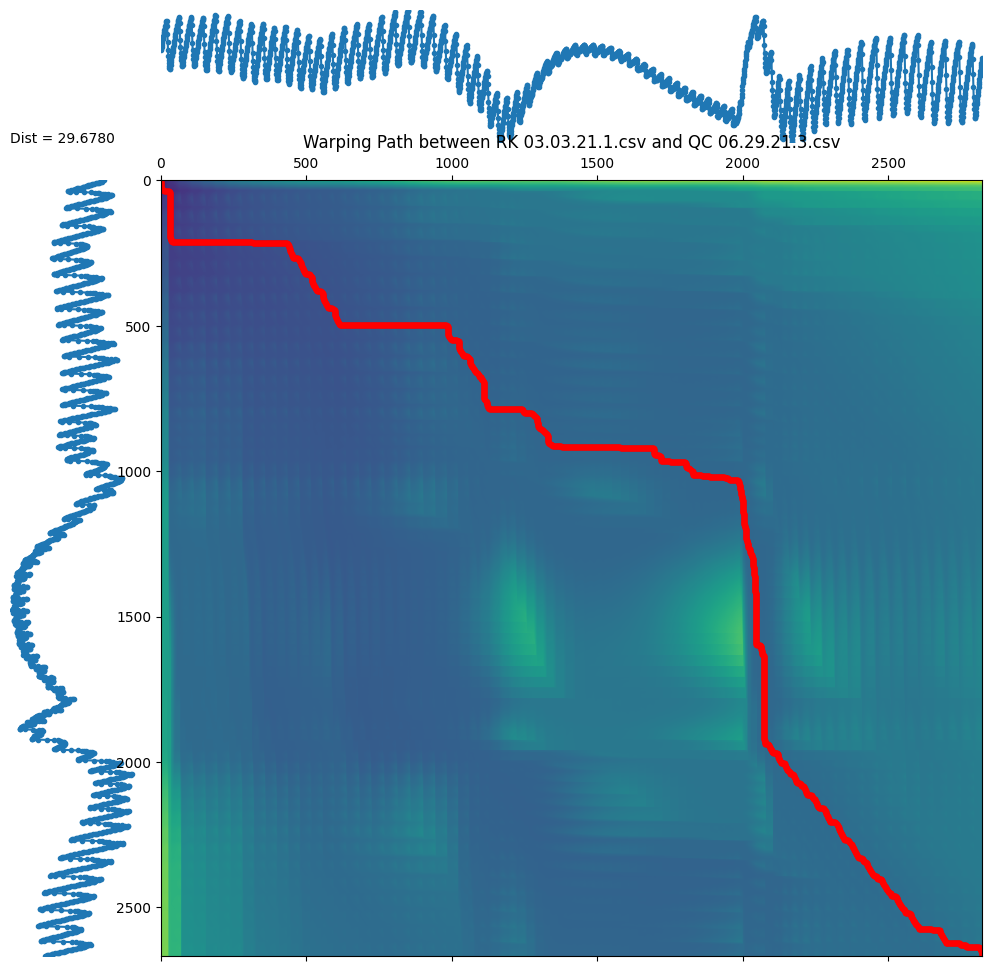

<Figure size 1000x600 with 0 Axes>

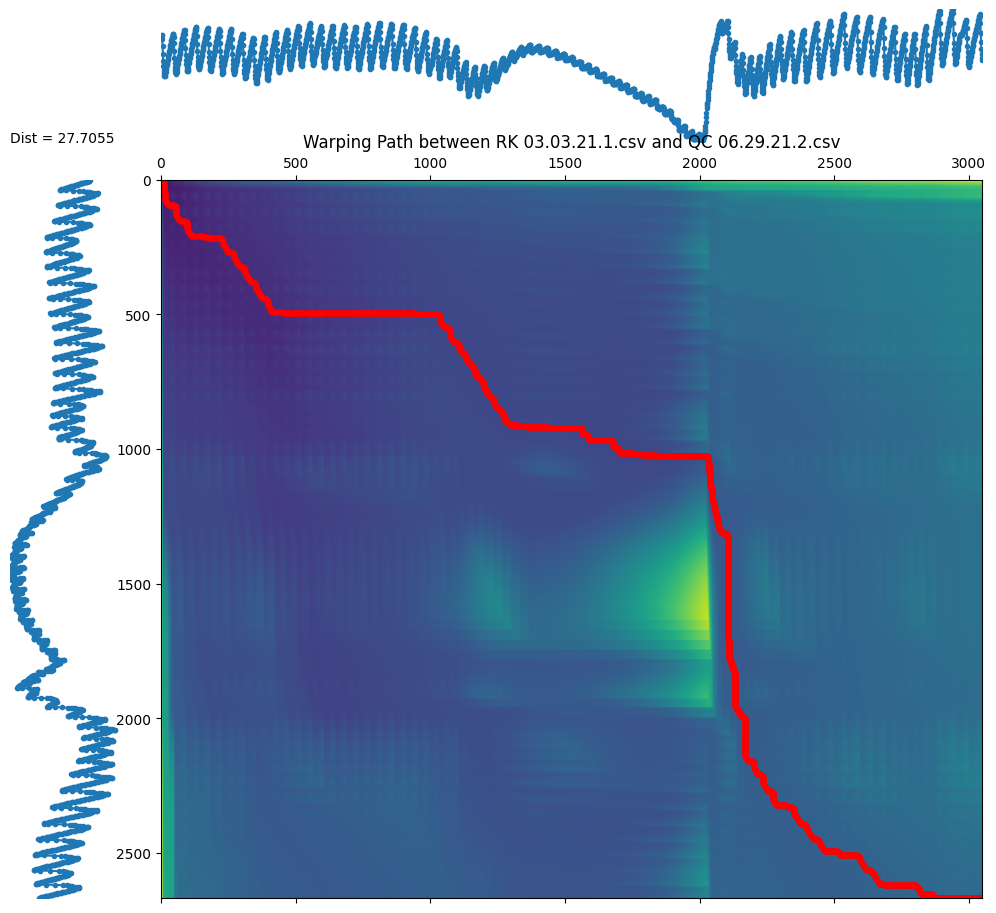

KeyboardInterrupt: 

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Iterate over multiple pairs of signals
for i in range(len(goodH_filenames)):
    for j in range(i + 1, len(goodH_filenames)):
        filename_1 = goodH_filenames[i]
        filename_2 = goodH_filenames[j]

        # Extract and normalize the signals
        signal_1 = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
        signal_2 = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

        # Calculate DTW distance and warping paths without window constraint
        d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

        # Find the best path
        best_path = dtw.best_path(paths)

        # Visualize the warping paths and include the filenames in the plot title
        plt.figure(figsize=(10, 6))
        dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
        plt.title(f'Warping Path between {filename_1} and {filename_2}')
        plt.show()


## Distribution

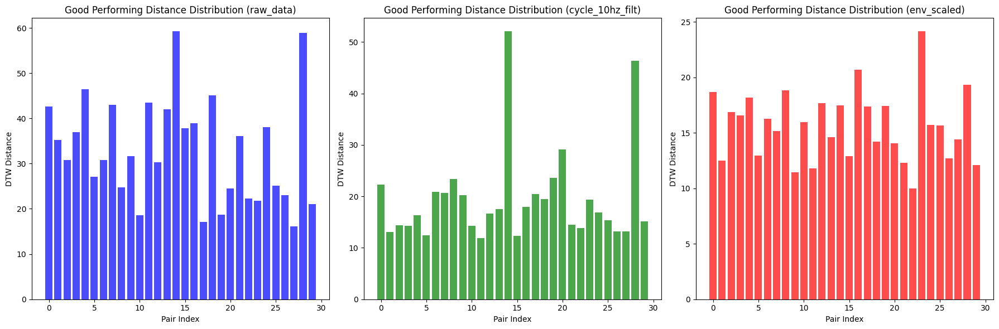

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 30
selected_pairs = [(goodH_filenames[i], goodH_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot bar charts
axes[0].bar(range(num_pairs), dtw_distances_raw, color='blue', alpha=0.7)
axes[0].set_title('Good Performing Distance Distribution (raw_data)')
axes[0].set_xlabel('Pair Index')
axes[0].set_ylabel('DTW Distance')

axes[1].bar(range(num_pairs), dtw_distances_cycle, color='green', alpha=0.7)
axes[1].set_title('Good Performing Distance Distribution (cycle_10hz_filt)')
axes[1].set_xlabel('Pair Index')
axes[1].set_ylabel('DTW Distance')

axes[2].bar(range(num_pairs), dtw_distances_env, color='red', alpha=0.7)
axes[2].set_title('Good Performing Distance Distribution (env_scaled)')
axes[2].set_xlabel('Pair Index')
axes[2].set_ylabel('DTW Distance')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


#Bad Performers

In [ ]:
dfst = df[df['z_score'] > 0].sort_values('z_score', ascending=False)
filtered_df = dfst[dfst['Data QA'] >= 0.4]  #Fitering out data from the data qa feature with above 0.6
filtered_df = filtered_df.dropna(subset=['z_score'])
filtered_df['Health Status'] = filtered_df['strain'].apply(lambda x: 'Healthy' if x > 14 else 'Unhealthy')

# Split the data into Healthy and Unhealthy categories
healthy = filtered_df[filtered_df['Health Status'] == 'Healthy']
unhealthy = filtered_df[filtered_df['Health Status'] == 'Unhealthy']

# Display the DataFrames for each category
display("Healthy Data:")
display(healthy)
display("Unhealthy Data:")
display(unhealthy)

BahH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
BahH_filenames

'Healthy Data:'

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656),Health Status
252,JFHC RG1 08.24.21.2.csv,19.0,8.60,0.90,6.94,3.72,0.25,0.46,NaN,NaN,...,NaN,7.94,7.02,NaN,8.61,9.66,8.92,9.45,NaN,Healthy
118,MN 06.24.21.1.csv,20.0,5.06,1.03,2.63,1.61,0.42,0.46,4.57,6.10,...,4.43,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.39,Healthy
165,TN 06.15.21.2.csv,21.0,4.91,1.25,2.05,1.52,0.71,0.46,7.06,5.72,...,3.88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.36,Healthy
108,LL 02.09.21.2.csv,24.0,5.25,1.53,1.89,1.73,1.08,0.62,6.46,6.03,...,2.80,5.57,4.68,NaN,NaN,NaN,NaN,NaN,4.31,Healthy
166,TN 06.15.21.3.csv,21.0,4.77,1.46,1.66,1.44,0.99,0.46,7.62,5.25,...,3.79,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.36,Healthy
56,IW 07.08.21.3.csv,16.0,4.23,1.15,1.63,1.12,0.58,0.46,2.35,4.64,...,4.32,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.60,Healthy
4,AG 07.06.21.2.csv,19.0,4.36,1.32,1.52,1.20,0.80,0.62,3.06,4.14,...,6.58,5.83,3.95,NaN,NaN,NaN,NaN,NaN,2.20,Healthy
275,MA 06.10.21.2.csv,17.0,3.49,0.77,1.48,0.68,0.08,0.46,NaN,NaN,...,NaN,2.20,2.64,NaN,3.99,3.99,4.20,3.95,NaN,Healthy
107,LL 02.09.21.1.csv,24.0,5.11,1.94,1.42,1.64,1.62,0.62,6.83,8.44,...,2.44,4.14,3.18,NaN,NaN,NaN,NaN,NaN,4.31,Healthy
69,JFHC JC1 08.24.21.3.csv,17.0,4.21,1.33,1.40,1.11,0.82,0.46,3.00,4.89,...,5.61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.24,Healthy


'Unhealthy Data:'

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656),Health Status
82,JFHC SL1 10.12.21.1.csv,8.0,8.14,1.26,4.59,3.45,0.72,0.62,5.75,9.17,...,7.92,9.29,9.54,NaN,NaN,NaN,NaN,NaN,8.99,Unhealthy
81,JFHC SL1 10.12.21.2.csv,8.0,8.44,1.51,4.03,3.62,1.05,0.46,6.35,8.49,...,7.98,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.79,Unhealthy
80,JFHC SL1 10.12.21.3.csv,8.0,8.29,1.60,3.71,3.54,1.17,0.92,5.40,6.35,...,9.50,7.79,8.46,NaN,10.61,10.84,8.55,7.84,9.79,Unhealthy
25,BHRT KH1 10.06.21.3.csv,10.0,4.64,0.66,3.47,1.36,-0.07,0.46,3.60,5.69,...,4.55,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.01,Unhealthy
26,BHRT KH1 10.06.21.2.csv,10.0,4.30,1.08,1.80,1.16,0.49,0.46,3.12,4.00,...,5.31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.13,Unhealthy
23,BHRT KH1 09.15.21.2.csv,10.0,5.73,2.00,1.69,2.01,1.70,0.46,7.47,7.94,...,3.37,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.81,Unhealthy
21,BHRT KH1 09.15.21.3.csv,10.0,5.78,2.17,1.58,2.04,1.92,0.46,5.89,8.78,...,3.39,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.40,Unhealthy
210,BHRT RE1 10.13.21.3.csv,13.0,2.86,0.32,1.58,0.30,-0.51,0.46,NaN,NaN,...,NaN,3.26,3.01,NaN,3.22,2.58,2.42,2.64,NaN,Unhealthy
76,JFHC RM1 10.05.21.3.csv,9.0,6.17,2.92,1.31,2.27,2.91,0.46,8.17,8.73,...,5.70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.90,Unhealthy
24,BHRT KH1 10.06.21.1.csv,10.0,4.17,1.66,1.09,1.08,1.25,0.46,1.24,5.33,...,4.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.01,Unhealthy


['JFHC RG1 08.24.21.2.csv',
 'MN 06.24.21.1.csv',
 'TN 06.15.21.2.csv',
 'LL 02.09.21.2.csv',
 'TN 06.15.21.3.csv',
 'IW 07.08.21.3.csv',
 'AG 07.06.21.2.csv',
 'MA 06.10.21.2.csv',
 'LL 02.09.21.1.csv',
 'JFHC JC1 08.24.21.3.csv',
 'JFHC GY1 10.12.21.3.csv',
 'AG 07.06.21.3.csv',
 'MW 02.10.21.1.csv',
 'MW 02.10.21.3.csv',
 'LL 02.09.21.3.csv',
 'TN 06.15.21.1.csv',
 'QM 02.09.21.2.csv',
 'MW 02.10.21.2.csv',
 'AG 07.06.21.1.csv',
 'AL 01.21.21.3.csv',
 'MN 06.24.21.3.csv',
 'QM 02.09.21.3.csv',
 'CM 02.25.21.3.csv',
 'JFHC GY1 10.12.21.2.csv',
 'MN 06.24.21.2.csv',
 'JFHC GY1 10.12.21.1.csv',
 'IW 07.08.21.2.csv',
 'HX 06.03.21.3.csv',
 'AL 01.21.21.2.csv',
 'AM 06.08.21.2.csv',
 'GG 02.10.21.3.csv',
 'QN 06.29.21.1.csv',
 'HX 06.03.21.1.csv',
 'QM 02.09.21.1.csv',
 'JFHC JV1 08.03.21.3.csv',
 'QN 06.29.21.3.csv',
 'MP 06.08.21.3.csv',
 'KV 02.11.21.2.csv',
 'LW 06.04.21.3.csv',
 'AA 05.28.21.2.csv',
 'MP 06.08.21.2.csv',
 'KD 06.25.21.3.csv',
 'JFHC JC1 08.24.21.2.csv',
 'HY 03.02.2

In [ ]:
num_healthy_patients = len(BahH_filenames)
print(f"Number of healthy patients: {num_healthy_patients}")

Number of healthy patients: 47


In [ ]:
sample_filename = BahH_filenames[0]
sample_data = ppg_signals_df[sample_filename]['raw_data']
print(f"Sample data for {sample_filename}:")
print(sample_data.describe())

Sample data for JFHC RG1 08.24.21.2.csv:
count     2556.000000
mean     22639.615415
std        540.491388
min      21559.000000
25%      22228.750000
50%      22425.000000
75%      23170.250000
max      23625.000000
Name: raw_data, dtype: float64


In [ ]:
signal_lengths = [len(ppg_signals_df[filename]['raw_data']) for filename in BahH_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

Average signal length: 2722.40 data points


In [ ]:
shortest_signal = min(signal_lengths)
longest_signal = max(signal_lengths)
print(f"Shortest signal: {shortest_signal} data points")
print(f"Longest signal: {longest_signal} data points")

Shortest signal: 2388 data points
Longest signal: 3389 data points


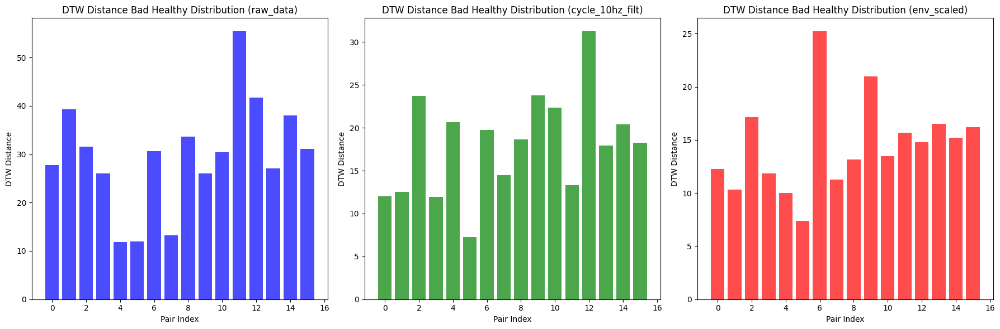

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
BahH_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Ensure num_pairs is within the available filenames range
num_pairs = min(30, len(BahH_filenames) // 2)  # Adjust to available pairs

# Select the pairs based on available filenames
selected_pairs = [(BahH_filenames[i], BahH_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot bar charts
axes[0].bar(range(num_pairs), dtw_distances_raw, color='blue', alpha=0.7)
axes[0].set_title('DTW Distance Bad Healthy Distribution (raw_data)')
axes[0].set_xlabel('Pair Index')
axes[0].set_ylabel('DTW Distance')

axes[1].bar(range(num_pairs), dtw_distances_cycle, color='green', alpha=0.7)
axes[1].set_title('DTW Distance Bad Healthy Distribution (cycle_10hz_filt)')
axes[1].set_xlabel('Pair Index')
axes[1].set_ylabel('DTW Distance')

axes[2].bar(range(num_pairs), dtw_distances_env, color='red', alpha=0.7)
axes[2].set_title('DTW Distance Bad Healthy Distribution (env_scaled)')
axes[2].set_xlabel('Pair Index')
axes[2].set_ylabel('DTW Distance')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


# Unhealthy

In [ ]:
unhealthy_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
unhealthy_filenames

In [ ]:
num_unhealthy_patients = len(unhealthy_filenames)
print(f"Number of healthy patients: {num_unhealthy_patients}")

In [ ]:
sample_filename = unhealthy_filenames[0]
sample_data = ppg_signals_df[sample_filename]['raw_data']
print(f"Sample data for {sample_filename}:")
print(sample_data.describe())

In [ ]:
signal_lengths = [len(ppg_signals_df[filename]['raw_data']) for filename in unhealthy_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

In [ ]:
shortest_signal = min(signal_lengths)
longest_signal = max(signal_lengths)
print(f"Shortest signal: {shortest_signal} data points")
print(f"Longest signal: {longest_signal} data points")

## Raw data

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
unhealthy_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Extract and normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Calculate 31 unique pairs
num_pairs = 31
selected_pairs = [(unhealthy_filenames[i], unhealthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

In [ ]:
# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals
    signal_1 = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2 = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2}')
    plt.show()


## Cycle

In [ ]:
# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals
    signal_1 = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2 = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2}')
    plt.show()

## Env

In [ ]:
# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals
    signal_1 = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2 = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distance and warping paths without window constraint
    d, paths = dtw.warping_paths(signal_1, signal_2, psi=2)

    # Find the best path
    best_path = dtw.best_path(paths)

    # Visualize the warping paths and include the filenames in the plot title
    plt.figure(figsize=(10, 6))
    dtwvis.plot_warpingpaths(signal_1, signal_2, paths, best_path)
    plt.title(f'Warping Path between {filename_1} and {filename_2}')
    plt.show()

## DISTRIBUTION

In [ ]:
# prompt: add density=true

import matplotlib.pyplot as plt
# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot histograms with density=True
axes[0].hist(dtw_distances_raw, color='blue', alpha=0.7, density=True)
axes[0].set_title('Good Performing Distance Distribution (raw_data)')
axes[0].set_xlabel('DTW Distance')
axes[0].set_ylabel('Density')

axes[1].hist(dtw_distances_cycle, color='green', alpha=0.7, density=True)
axes[1].set_title('Good Performing Distance Distribution (cycle_10hz_filt)')
axes[1].set_xlabel('DTW Distance')
axes[1].set_ylabel('Density')

axes[2].hist(dtw_distances_env, color='red', alpha=0.7, density=True)
axes[2].set_title('Good Performing Distance Distribution (env_scaled)')
axes[2].set_xlabel('DTW Distance')
axes[2].set_ylabel('Density')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 30
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot bar charts
axes[0].bar(range(num_pairs), dtw_distances_raw, color='blue', alpha=0.7)
axes[0].set_title('DTW Distance Unhealthy Distribution (raw_data)')
axes[0].set_xlabel('Pair Index')
axes[0].set_ylabel('DTW Distance')

axes[1].bar(range(num_pairs), dtw_distances_cycle, color='green', alpha=0.7)
axes[1].set_title('DTW Distance Unhealthy Distribution (cycle_10hz_filt)')
axes[1].set_xlabel('Pair Index')
axes[1].set_ylabel('DTW Distance')

axes[2].bar(range(num_pairs), dtw_distances_env, color='red', alpha=0.7)
axes[2].set_title('DTW Distance Unhealthy Distribution (env_scaled)')
axes[2].set_xlabel('Pair Index')
axes[2].set_ylabel('DTW Distance')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

### Whistle region


In [ ]:
import pickle
import pandas as pd  #density=true
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
healthy_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 30
selected_pairs = [(healthy_filenames[i], healthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Filter the signals to focus on the "Whistle" category
    whistle_1 = ppg_signals_df[filename_1][ppg_signals_df[filename_1]['Category'] == 'Whistle']
    whistle_2 = ppg_signals_df[filename_2][ppg_signals_df[filename_2]['Category'] == 'Whistle']

    # Extract and normalize the signals for each channel in the "Whistle" region
    signal_1_raw = normalize_signal(whistle_1['raw_data'].values)
    signal_2_raw = normalize_signal(whistle_2['raw_data'].values)

    signal_1_cycle = normalize_signal(whistle_1['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(whistle_2['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(whistle_1['env_scaled'].values)
    signal_2_env = normalize_signal(whistle_2['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot bar charts
axes[0].bar(range(num_pairs), dtw_distances_raw, color='blue', alpha=0.7)
axes[0].set_title('DTW Distance Distribution (raw_data) - Whistle Region')
axes[0].set_xlabel('Pair Index')
axes[0].set_ylabel('DTW Distance')

axes[1].bar(range(num_pairs), dtw_distances_cycle, color='green', alpha=0.7)
axes[1].set_title('DTW Distance Distribution (cycle_10hz_filt) - Whistle Region')
axes[1].set_xlabel('Pair Index')
axes[1].set_ylabel('DTW Distance')

axes[2].bar(range(num_pairs), dtw_distances_env, color='red', alpha=0.7)
axes[2].set_title('DTW Distance Distribution (env_scaled) - Whistle Region')
axes[2].set_xlabel('Pair Index')
axes[2].set_ylabel('DTW Distance')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


## Statistics

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import skew, kurtosis

# Assuming ppg_signals_df is loaded from the signal_data
unhealthy_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 30
selected_pairs = [(unhealthy_filenames[i], unhealthy_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Convert lists to numpy arrays for easier computation
dtw_distances_raw = np.array(dtw_distances_raw)
dtw_distances_cycle = np.array(dtw_distances_cycle)
dtw_distances_env = np.array(dtw_distances_env)

# Define a function to calculate relevant statistics
def calculate_statistics(dtw_distances):
    stats = {
        'Mean': np.mean(dtw_distances),
        'Median': np.median(dtw_distances),
        'Standard Deviation': np.std(dtw_distances),
        'Min': np.min(dtw_distances),
        'Max': np.max(dtw_distances),
        'Range': np.ptp(dtw_distances),
        'Variance': np.var(dtw_distances),
        'Q1': np.percentile(dtw_distances, 25),
        'Q3': np.percentile(dtw_distances, 75),
        'Skewness': skew(dtw_distances),
        'Kurtosis': kurtosis(dtw_distances)
    }
    return stats

# Calculate statistics for each channel
stats_raw = calculate_statistics(dtw_distances_raw)
stats_cycle = calculate_statistics(dtw_distances_cycle)
stats_env = calculate_statistics(dtw_distances_env)

# Convert statistics dictionaries to DataFrames for tabulation
stats_raw_df = pd.DataFrame(stats_raw.items(), columns=['Statistic', 'Value'])
stats_cycle_df = pd.DataFrame(stats_cycle.items(), columns=['Statistic', 'Value'])
stats_env_df = pd.DataFrame(stats_env.items(), columns=['Statistic', 'Value'])

# Display the DataFrames as tables
print("Statistics for raw_data DTW distances:")
display(stats_raw_df)

print("\nStatistics for cycle_10hz_filt DTW distances:")
display(stats_cycle_df)

print("\nStatistics for env_scaled DTW distances:")
display(stats_env_df)

# Calculate correlation between the channels
correlation_raw_cycle = np.corrcoef(dtw_distances_raw, dtw_distances_cycle)[0, 1]
correlation_raw_env = np.corrcoef(dtw_distances_raw, dtw_distances_env)[0, 1]
correlation_cycle_env = np.corrcoef(dtw_distances_cycle, dtw_distances_env)[0, 1]

# Create a DataFrame for correlation values
correlation_df = pd.DataFrame({
    'Channel Pair': ['raw_data vs cycle_10hz_filt', 'raw_data vs env_scaled', 'cycle_10hz_filt vs env_scaled'],
    'Correlation': [correlation_raw_cycle, correlation_raw_env, correlation_cycle_env]
})

# Display the correlation DataFrame as a table
print("\nCorrelation between DTW distances:")
display(correlation_df)


# Good performers

In [ ]:
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
goodU_filenames

['JFHC SL1 10.12.21.1.csv',
 'JFHC SL1 10.12.21.2.csv',
 'JFHC SL1 10.12.21.3.csv',
 'BHRT KH1 10.06.21.3.csv',
 'BHRT KH1 10.06.21.2.csv',
 'BHRT KH1 09.15.21.2.csv',
 'BHRT KH1 09.15.21.3.csv',
 'BHRT RE1 10.13.21.3.csv',
 'JFHC RM1 10.05.21.3.csv',
 'BHRT KH1 10.06.21.1.csv',
 'JFHC RM1 10.05.21.2.csv',
 'JFHC RM1 10.05.21.1.csv',
 'BHRT GW1 10.06.21.3.csv',
 'BHRT TH1 11.03.21.2.csv',
 'BHRT SB1 09.08.21.2.csv',
 'BHRT SB1 09.08.21.3.csv',
 'BHRT TH1 11.03.21.1.csv',
 'BHRT KH1 09.15.21.1.csv',
 'BHRT TH1 11.03.21.3.csv',
 'JFHC SI1 10.12.21.3.csv',
 'JH 03.02.21.2.csv',
 'BHRT AS1 10.20.21.3.csv',
 'JFHC SI1 10.12.21.2.csv',
 'BHRT ML1 09.15.21.1.csv',
 'BHRT AS1 10.20.21.2.csv',
 'BHRT MT1 10.20.21.2.csv',
 'BHRT KR1 09.29.21.2.csv',
 'BHRT SB1 09.08.21.1.csv',
 'BHRT DS1 09.29.21.3.csv',
 'BHRT ML1 09.15.21.2.csv',
 'BHRT MT1 10.20.21.3.csv',
 'JA 06.11.21.2.csv',
 'BHRT MT1 10.20.21.1.csv']

In [ ]:
num_healthy_patients = len(goodU_filenames)
print(f"Number of healthy patients: {num_healthy_patients}") # 46.77%

Number of healthy patients: 33


In [ ]:
sample_filename = goodU_filenames[0]
sample_data = ppg_signals_df[sample_filename]['raw_data']
print(f"Sample data for {sample_filename}:")
print(sample_data.describe())

Sample data for JFHC SL1 10.12.21.1.csv:
count     2534.000000
mean     22721.092344
std        423.531250
min      21376.000000
25%      22456.250000
50%      22759.500000
75%      23045.750000
max      23610.000000
Name: raw_data, dtype: float64


In [ ]:
signal_lengths = [len(ppg_signals_df[filename]['raw_data']) for filename in goodU_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

Average signal length: 2571.21 data points


In [ ]:
shortest_signal = min(signal_lengths)
longest_signal = max(signal_lengths)
print(f"Shortest signal: {shortest_signal} data points")
print(f"Longest signal: {longest_signal} data points")

Shortest signal: 2257 data points
Longest signal: 2987 data points


## Distribution

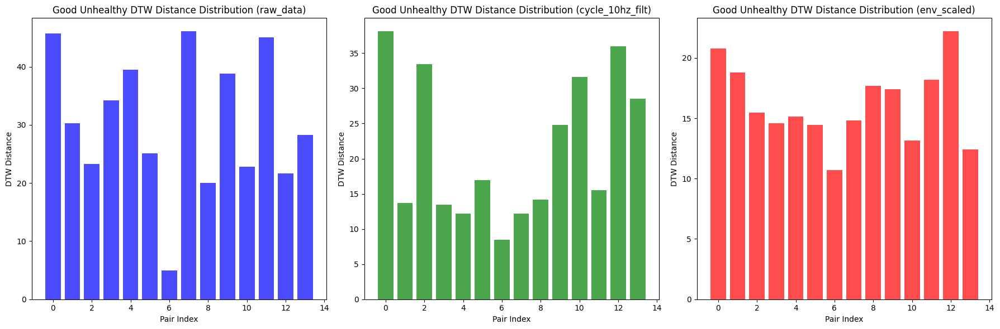

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 14
selected_pairs = [(goodU_filenames[i], goodU_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot bar charts
axes[0].bar(range(num_pairs), dtw_distances_raw, color='blue', alpha=0.7)
axes[0].set_title('Good Unhealthy DTW Distance Distribution (raw_data)')
axes[0].set_xlabel('Pair Index')
axes[0].set_ylabel('DTW Distance')

axes[1].bar(range(num_pairs), dtw_distances_cycle, color='green', alpha=0.7)
axes[1].set_title('Good Unhealthy DTW Distance Distribution (cycle_10hz_filt)')
axes[1].set_xlabel('Pair Index')
axes[1].set_ylabel('DTW Distance')

axes[2].bar(range(num_pairs), dtw_distances_env, color='red', alpha=0.7)
axes[2].set_title('Good Unhealthy DTW Distance Distribution (env_scaled)')
axes[2].set_xlabel('Pair Index')
axes[2].set_ylabel('DTW Distance')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


## Statistics

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import skew, kurtosis

# Assuming ppg_signals_df is loaded from the signal_data
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Adjust num_pairs based on available filenames
num_pairs = min(30, len(goodU_filenames) // 2)  # Ensure there are enough filenames

# Select pairs of filenames
selected_pairs = [(goodU_filenames[i], goodU_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Convert lists to numpy arrays for easier computation
dtw_distances_raw = np.array(dtw_distances_raw)
dtw_distances_cycle = np.array(dtw_distances_cycle)
dtw_distances_env = np.array(dtw_distances_env)

# Define a function to calculate relevant statistics
def calculate_statistics(dtw_distances):
    stats = {
        'Mean': np.mean(dtw_distances),
        'Median': np.median(dtw_distances),
        'Standard Deviation': np.std(dtw_distances),
        'Min': np.min(dtw_distances),
        'Max': np.max(dtw_distances),
        'Range': np.ptp(dtw_distances),
        'Variance': np.var(dtw_distances),
        'Q1': np.percentile(dtw_distances, 25),
        'Q3': np.percentile(dtw_distances, 75),
        'Skewness': skew(dtw_distances),
        'Kurtosis': kurtosis(dtw_distances)
    }
    return stats

# Calculate statistics for each channel
stats_raw = calculate_statistics(dtw_distances_raw)
stats_cycle = calculate_statistics(dtw_distances_cycle)
stats_env = calculate_statistics(dtw_distances_env)

# Convert statistics dictionaries to DataFrames for tabulation
stats_raw_df = pd.DataFrame(stats_raw.items(), columns=['Statistic', 'Value'])
stats_cycle_df = pd.DataFrame(stats_cycle.items(), columns=['Statistic', 'Value'])
stats_env_df = pd.DataFrame(stats_env.items(), columns=['Statistic', 'Value'])

# Display the DataFrames as tables
print("Statistics for raw_data DTW distances:")
display(stats_raw_df)

print("\nStatistics for cycle_10hz_filt DTW distances:")
display(stats_cycle_df)

print("\nStatistics for env_scaled DTW distances:")
display(stats_env_df)

# Calculate correlation between the channels
correlation_raw_cycle = np.corrcoef(dtw_distances_raw, dtw_distances_cycle)[0, 1]
correlation_raw_env = np.corrcoef(dtw_distances_raw, dtw_distances_env)[0, 1]
correlation_cycle_env = np.corrcoef(dtw_distances_cycle, dtw_distances_env)[0, 1]

# Create a DataFrame for correlation values
correlation_df = pd.DataFrame({
    'Channel Pair': ['raw_data vs cycle_10hz_filt', 'raw_data vs env_scaled', 'cycle_10hz_filt vs env_scaled'],
    'Correlation': [correlation_raw_cycle, correlation_raw_env, correlation_cycle_env]
})

# Display the correlation DataFrame as a table
print("\nCorrelation between DTW distances:")
display(correlation_df)


Statistics for raw_data DTW distances:


,Statistic,Value
0,Mean,26.665574
1,Median,25.057021
2,Standard Deviation,10.949707
3,Min,4.996579
4,Max,46.076261
5,Range,41.079682
6,Variance,119.896094
7,Q1,19.314372
8,Q3,33.078133
9,Skewness,0.222331



Statistics for cycle_10hz_filt DTW distances:


,Statistic,Value
0,Mean,20.633294
1,Median,16.246616
2,Standard Deviation,8.757348
3,Min,8.480033
4,Max,38.091370
5,Range,29.611337
6,Variance,76.691142
7,Q1,13.992089
8,Q3,26.636649
9,Skewness,0.731506



Statistics for env_scaled DTW distances:


,Statistic,Value
0,Mean,16.653629
1,Median,15.985050
2,Standard Deviation,3.054363
3,Min,10.702461
4,Max,22.851966
5,Range,12.149505
6,Variance,9.329133
7,Q1,14.709222
8,Q3,18.487411
9,Skewness,0.206958



Correlation between DTW distances:


,Channel Pair,Correlation
0,raw_data vs cycle_10hz_filt,0.039067
1,raw_data vs env_scaled,0.201212
2,cycle_10hz_filt vs env_scaled,0.298634


# Bad performers

In [ ]:
dfst = df[df['z_score'] > 0].sort_values('z_score', ascending=True)
filtered_df = dfst[dfst['Data QA'] >= 0.4]  #Fitering out data from the data qa feature with above 0.6
filtered_df = filtered_df.dropna(subset=['z_score'])
filtered_df['Health Status'] = filtered_df['strain'].apply(lambda x: 'Healthy' if x > 14 else 'Unhealthy')

# Split the data into Healthy and Unhealthy categories
healthy = filtered_df[filtered_df['Health Status'] == 'Healthy']
unhealthy = filtered_df[filtered_df['Health Status'] == 'Unhealthy']

# Display the DataFrames for each category
display("Healthy Data:")
display(healthy)
display("Unhealthy Data:")
display(unhealthy)

BadU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
BadU_filenames

'Healthy Data:'

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656),Health Status
11,AM 06.08.21.3.csv,19.0,2.39,1.53,0.02,0.02,1.08,0.92,4.39,3.11,...,4.44,0.60,1.22,NaN,0.87,1.77,1.19,0.74,1.76,Healthy
113,LW 06.04.21.2.csv,19.0,2.42,1.52,0.04,0.04,1.07,0.46,1.27,3.07,...,3.24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.37,Healthy
225,GT 03.04.21.3.csv,20.0,2.44,1.79,0.05,0.05,1.42,0.46,NaN,NaN,...,NaN,0.25,0.22,NaN,2.51,2.61,5.10,3.96,NaN,Healthy
228,HY 03.02.21.3.csv,21.0,2.48,1.58,0.08,0.08,1.15,0.46,NaN,NaN,...,NaN,0.48,0.58,NaN,2.26,2.87,4.63,4.06,NaN,Healthy
68,JFHC JC1 08.24.21.2.csv,17.0,2.52,1.14,0.15,0.10,0.57,0.46,3.45,0.34,...,3.64,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.24,Healthy
265,KD 06.25.21.3.csv,15.0,2.59,1.49,0.16,0.14,1.03,0.46,NaN,NaN,...,NaN,1.42,0.95,NaN,2.69,1.39,4.83,4.25,NaN,Healthy
121,MP 06.08.21.2.csv,20.0,2.72,2.00,0.18,0.22,1.70,0.46,6.62,NaN,...,0.75,NaN,NaN,2.00,NaN,NaN,NaN,NaN,1.50,Healthy
0,AA 05.28.21.2.csv,16.0,2.71,1.71,0.21,0.21,1.32,0.54,1.46,5.29,...,4.33,NaN,NaN,0.58,NaN,NaN,NaN,NaN,3.90,Healthy
114,LW 06.04.21.3.csv,19.0,2.84,2.23,0.22,0.29,2.00,0.46,0.59,1.28,...,4.33,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.14,Healthy
106,KV 02.11.21.2.csv,18.0,2.72,1.45,0.25,0.22,0.98,0.62,3.83,1.74,...,3.10,4.68,4.14,NaN,NaN,NaN,NaN,NaN,0.18,Healthy


'Unhealthy Data:'

,filenames,strain,mean,std_dev,z_score,mean_z_score,std_dev_z_score,Data QA,XCMPlus (zany-dust-13457),XCMPlus (radiant-sweep-1),...,InceptionTimePlus (zesty-dust-10100),InceptionTimePlus (daily-sweep-188),InceptionTimePlus (glamorous-sweep-103),MultiInceptionTimePlus (peachy-darkness-6716),MultiInceptionTimePlus (eager-breeze-5002),MultiInceptionTimePlus (vital-sunset-5008),MultiInceptionTimePlus (proud-fire-5143),MultiInceptionTimePlus (comic-morning-5149),MultiInceptionTimePlus (super-dew-6656),Health Status
33,BHRT MT1 10.20.21.1.csv,12.0,2.45,2.04,0.05,0.06,1.75,0.46,0.48,5.47,...,0.76,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.05,Unhealthy
59,JA 06.11.21.2.csv,14.0,2.53,1.31,0.14,0.11,0.79,0.46,0.29,3.64,...,3.52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.90,Unhealthy
35,BHRT MT1 10.20.21.3.csv,12.0,2.85,2.25,0.22,0.30,2.03,0.46,1.75,6.02,...,0.67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.11,Unhealthy
32,BHRT ML1 09.15.21.2.csv,10.0,2.95,2.40,0.25,0.36,2.23,0.54,6.94,5.72,...,0.48,NaN,NaN,1.48,NaN,NaN,NaN,NaN,1.29,Unhealthy
198,BHRT DS1 09.29.21.3.csv,12.0,2.72,1.18,0.31,0.22,0.62,0.46,NaN,NaN,...,NaN,1.16,1.43,NaN,3.51,4.47,2.39,3.35,NaN,Unhealthy
36,BHRT SB1 09.08.21.1.csv,9.0,2.97,1.72,0.36,0.37,1.33,0.54,5.45,3.19,...,0.76,NaN,NaN,1.76,NaN,NaN,NaN,NaN,3.74,Unhealthy
28,BHRT KR1 09.29.21.2.csv,10.0,2.72,1.00,0.37,0.22,0.38,0.62,3.92,2.64,...,2.40,4.22,3.33,NaN,NaN,NaN,NaN,NaN,1.44,Unhealthy
34,BHRT MT1 10.20.21.2.csv,12.0,3.42,2.78,0.38,0.64,2.73,0.46,2.91,6.92,...,1.16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.05,Unhealthy
13,BHRT AS1 10.20.21.2.csv,6.0,3.98,3.87,0.42,0.97,4.16,0.54,10.72,8.24,...,0.15,NaN,NaN,0.60,NaN,NaN,NaN,NaN,2.24,Unhealthy
30,BHRT ML1 09.15.21.1.csv,10.0,3.58,2.76,0.44,0.73,2.70,0.54,6.35,6.26,...,1.49,NaN,NaN,1.48,NaN,NaN,NaN,NaN,1.52,Unhealthy


['BHRT MT1 10.20.21.1.csv',
 'JA 06.11.21.2.csv',
 'BHRT MT1 10.20.21.3.csv',
 'BHRT ML1 09.15.21.2.csv',
 'BHRT DS1 09.29.21.3.csv',
 'BHRT SB1 09.08.21.1.csv',
 'BHRT KR1 09.29.21.2.csv',
 'BHRT MT1 10.20.21.2.csv',
 'BHRT AS1 10.20.21.2.csv',
 'BHRT ML1 09.15.21.1.csv',
 'JFHC SI1 10.12.21.2.csv',
 'BHRT AS1 10.20.21.3.csv',
 'JH 03.02.21.2.csv',
 'JFHC SI1 10.12.21.3.csv',
 'BHRT TH1 11.03.21.3.csv',
 'BHRT KH1 09.15.21.1.csv',
 'BHRT TH1 11.03.21.1.csv',
 'BHRT SB1 09.08.21.3.csv',
 'BHRT SB1 09.08.21.2.csv',
 'BHRT TH1 11.03.21.2.csv',
 'BHRT GW1 10.06.21.3.csv',
 'JFHC RM1 10.05.21.1.csv',
 'JFHC RM1 10.05.21.2.csv',
 'BHRT KH1 10.06.21.1.csv',
 'JFHC RM1 10.05.21.3.csv',
 'BHRT KH1 09.15.21.3.csv',
 'BHRT RE1 10.13.21.3.csv',
 'BHRT KH1 09.15.21.2.csv',
 'BHRT KH1 10.06.21.2.csv',
 'BHRT KH1 10.06.21.3.csv',
 'JFHC SL1 10.12.21.3.csv',
 'JFHC SL1 10.12.21.2.csv',
 'JFHC SL1 10.12.21.1.csv']

In [ ]:
num_healthy_patients = len(BadU_filenames)
print(f"Number of healthy patients: {num_healthy_patients}")

Number of healthy patients: 33


In [ ]:
sample_filename = BadU_filenames[0]
sample_data = ppg_signals_df[sample_filename]['raw_data']
print(f"Sample data for {sample_filename}:")
print(sample_data.describe())

Sample data for BHRT MT1 10.20.21.1.csv:
count     2656.000000
mean     21793.495105
std        728.667997
min      20068.000000
25%      21301.000000
50%      21771.500000
75%      22323.500000
max      23372.000000
Name: raw_data, dtype: float64


In [ ]:
signal_lengths = [len(ppg_signals_df[filename]['raw_data']) for filename in BadU_filenames]
avg_signal_length = sum(signal_lengths) / len(signal_lengths)
print(f"Average signal length: {avg_signal_length:.2f} data points")

Average signal length: 2571.21 data points


In [ ]:
shortest_signal = min(signal_lengths)
longest_signal = max(signal_lengths)
print(f"Shortest signal: {shortest_signal} data points")
print(f"Longest signal: {longest_signal} data points")

Shortest signal: 2257 data points
Longest signal: 2987 data points


## Distribution

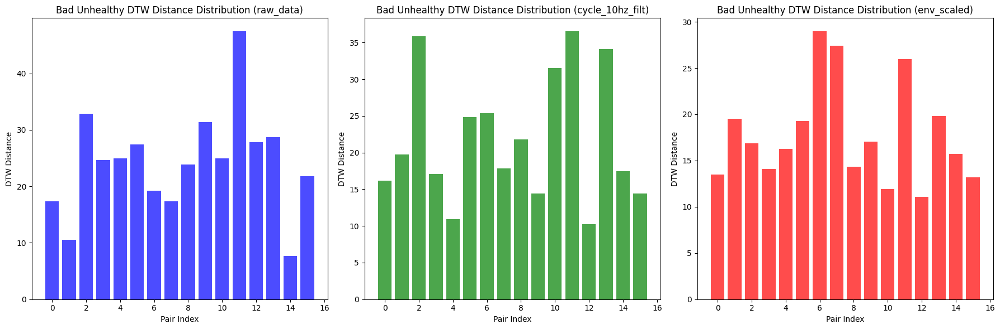

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt

# Assuming ppg_signals_df is loaded from the signal_data
BadU_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 16
selected_pairs = [(BadU_filenames[i], BadU_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Create a 1x3 subplot to show the distribution of DTW distances
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot bar charts
axes[0].bar(range(num_pairs), dtw_distances_raw, color='blue', alpha=0.7)
axes[0].set_title('Bad Unhealthy DTW Distance Distribution (raw_data)')
axes[0].set_xlabel('Pair Index')
axes[0].set_ylabel('DTW Distance')

axes[1].bar(range(num_pairs), dtw_distances_cycle, color='green', alpha=0.7)
axes[1].set_title('Bad Unhealthy DTW Distance Distribution (cycle_10hz_filt)')
axes[1].set_xlabel('Pair Index')
axes[1].set_ylabel('DTW Distance')

axes[2].bar(range(num_pairs), dtw_distances_env, color='red', alpha=0.7)
axes[2].set_title('Bad Unhealthy DTW Distance Distribution (env_scaled)')
axes[2].set_xlabel('Pair Index')
axes[2].set_ylabel('DTW Distance')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


### Statistics

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import skew, kurtosis

# Assuming ppg_signals_df is loaded from the signal_data
BadU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Select the first 30 pairs
num_pairs = 30
selected_pairs = [(BadU_filenames[i], BadU_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

# Initialize lists to store DTW distances for each channel
dtw_distances_raw = []
dtw_distances_cycle = []
dtw_distances_env = []

# Iterate over the selected pairs
for filename_1, filename_2 in selected_pairs:
    # Extract and normalize the signals for each channel
    signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
    signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

    signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
    signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

    signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
    signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

    # Calculate DTW distances using dtaidistance
    d_raw = dtw.distance(signal_1_raw, signal_2_raw)
    d_cycle = dtw.distance(signal_1_cycle, signal_2_cycle)
    d_env = dtw.distance(signal_1_env, signal_2_env)

    # Append distances to the respective lists
    dtw_distances_raw.append(d_raw)
    dtw_distances_cycle.append(d_cycle)
    dtw_distances_env.append(d_env)

# Convert lists to numpy arrays for easier computation
dtw_distances_raw = np.array(dtw_distances_raw)
dtw_distances_cycle = np.array(dtw_distances_cycle)
dtw_distances_env = np.array(dtw_distances_env)

# Define a function to calculate relevant statistics
def calculate_statistics(dtw_distances):
    stats = {
        'Mean': np.mean(dtw_distances),
        'Median': np.median(dtw_distances),
        'Standard Deviation': np.std(dtw_distances),
        'Min': np.min(dtw_distances),
        'Max': np.max(dtw_distances),
        'Range': np.ptp(dtw_distances),
        'Variance': np.var(dtw_distances),
        'Q1': np.percentile(dtw_distances, 25),
        'Q3': np.percentile(dtw_distances, 75),
        'Skewness': skew(dtw_distances),
        'Kurtosis': kurtosis(dtw_distances)
    }
    return stats

# Calculate statistics for each channel
stats_raw = calculate_statistics(dtw_distances_raw)
stats_cycle = calculate_statistics(dtw_distances_cycle)
stats_env = calculate_statistics(dtw_distances_env)

# Convert statistics dictionaries to DataFrames for tabulation
stats_raw_df = pd.DataFrame(stats_raw.items(), columns=['Statistic', 'Value'])
stats_cycle_df = pd.DataFrame(stats_cycle.items(), columns=['Statistic', 'Value'])
stats_env_df = pd.DataFrame(stats_env.items(), columns=['Statistic', 'Value'])

# Display the DataFrames as tables
print("Statistics for raw_data DTW distances:")
display(stats_raw_df)

print("\nStatistics for cycle_10hz_filt DTW distances:")
display(stats_cycle_df)

print("\nStatistics for env_scaled DTW distances:")
display(stats_env_df)

# Calculate correlation between the channels
correlation_raw_cycle = np.corrcoef(dtw_distances_raw, dtw_distances_cycle)[0, 1]
correlation_raw_env = np.corrcoef(dtw_distances_raw, dtw_distances_env)[0, 1]
correlation_cycle_env = np.corrcoef(dtw_distances_cycle, dtw_distances_env)[0, 1]

# Create a DataFrame for correlation values
correlation_df = pd.DataFrame({
    'Channel Pair': ['raw_data vs cycle_10hz_filt', 'raw_data vs env_scaled', 'cycle_10hz_filt vs env_scaled'],
    'Correlation': [correlation_raw_cycle, correlation_raw_env, correlation_cycle_env]
})

# Display the correlation DataFrame as a table
print("\nCorrelation between DTW distances:")
display(correlation_df)


#Hierarchical Clustering

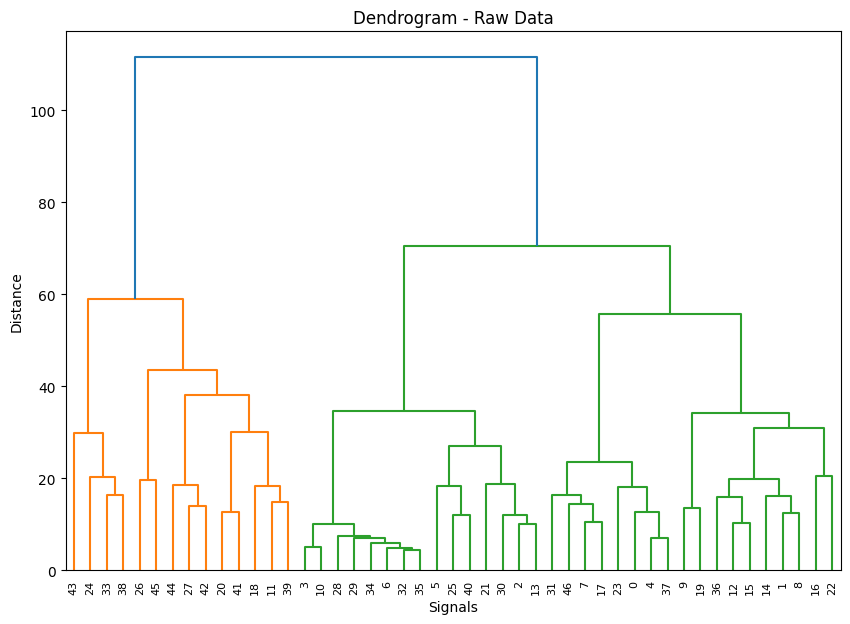

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:1006: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


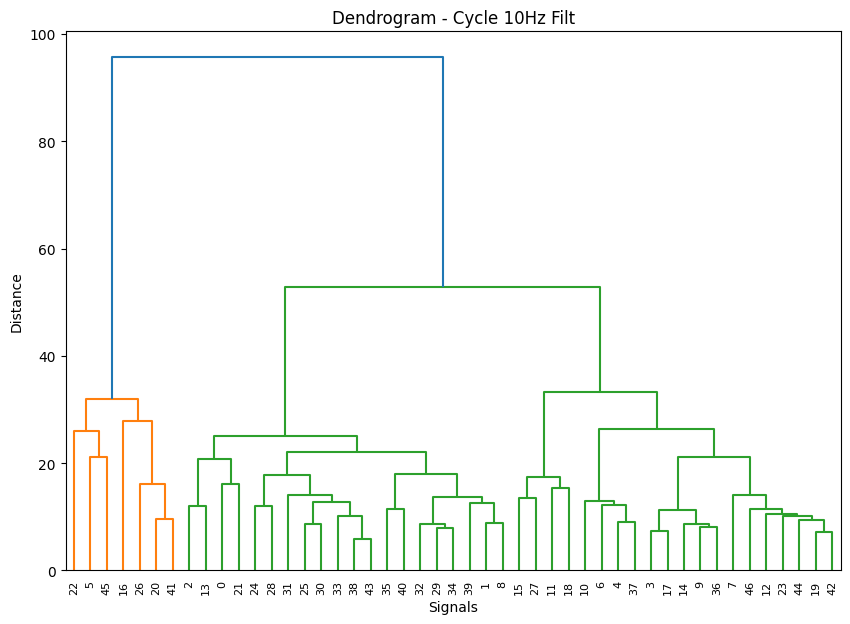

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:1006: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


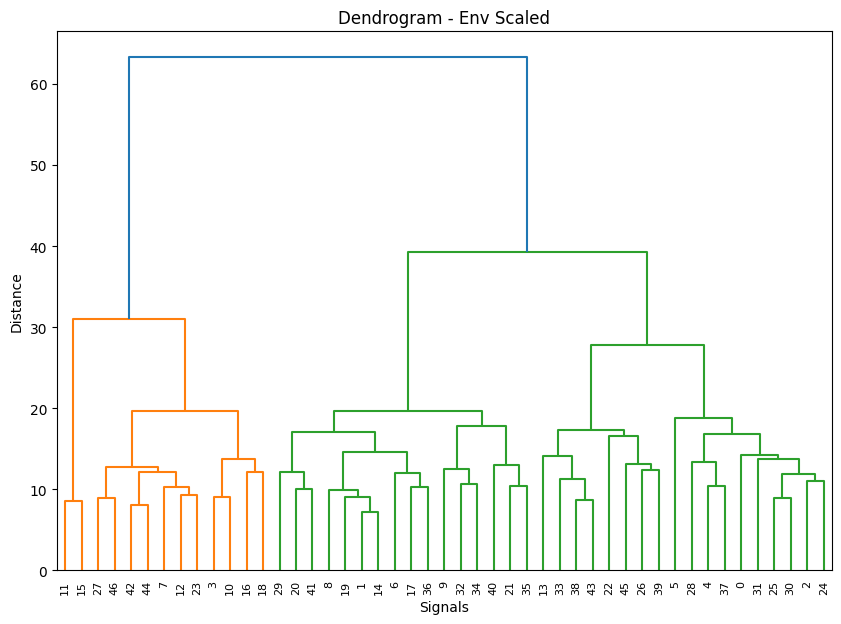

Raw Data Clusters: [1 1 1 1 1 1 1 2 1 1 1 3 1 1 1 1 1 2 3 1 3 1 1 2 0 1 0 3 1 1 1 2 1 0 1 1 1
 1 0 3 1 3 3 0 3 0 2]
Cycle 10Hz Filt Clusters: [2 2 2 1 1 0 1 1 2 1 1 3 1 2 1 1 0 1 3 1 0 1 0 1 2 2 0 1 2 2 2 2 2 2 2 2 1
 1 2 2 2 0 1 2 1 0 1]
Env Scaled Clusters: [1 1 1 0 1 1 1 0 0 1 0 2 0 3 1 2 0 0 0 1 1 1 3 0 1 1 1 0 1 1 1 1 1 3 1 1 0
 1 3 1 1 1 0 3 0 1 0]


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:1006: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


In [ ]:
import numpy as np
import pandas as pd
from dtaidistance import dtw
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering
from scipy.spatial.distance import squareform

# Assuming ppg_signals_df is loaded and contains signals for all categories
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Extract and normalize all signals
normalized_signals_raw = [normalize_signal(ppg_signals_df[filename]['raw_data'].values) for filename in goodH_filenames]
normalized_signals_cycle = [normalize_signal(ppg_signals_df[filename]['cycle_10hz_filt'].values) for filename in goodH_filenames]
normalized_signals_env = [normalize_signal(ppg_signals_df[filename]['env_scaled'].values) for filename in goodH_filenames]

# Compute the DTW distance matrices using the fast method
dtw_distance_matrix_raw = dtw.distance_matrix_fast(normalized_signals_raw, parallel=True, use_mp=False)
dtw_distance_matrix_cycle = dtw.distance_matrix_fast(normalized_signals_cycle, parallel=True, use_mp=False)
dtw_distance_matrix_env = dtw.distance_matrix_fast(normalized_signals_env, parallel=True, use_mp=False)

# Function to perform hierarchical clustering
def perform_clustering(distance_matrix, title):
    # Convert the distance matrix to a condensed form for clustering
    condensed_dist_matrix = squareform(distance_matrix)

    # Plot dendrogram
    plt.figure(figsize=(10, 7))
    sch.dendrogram(sch.linkage(condensed_dist_matrix, method='ward'))
    plt.title(f'Dendrogram - {title}')
    plt.xlabel('Signals')
    plt.ylabel('Distance')
    plt.show()

    # Apply Agglomerative Clustering
    cluster = AgglomerativeClustering(n_clusters=4, affinity='precomputed', linkage='complete')
    cluster_labels = cluster.fit_predict(distance_matrix)

    return cluster_labels

# Perform clustering for each signal type
raw_clusters = perform_clustering(dtw_distance_matrix_raw, 'Raw Data')
cycle_clusters = perform_clustering(dtw_distance_matrix_cycle, 'Cycle 10Hz Filt')
env_clusters = perform_clustering(dtw_distance_matrix_env, 'Env Scaled')

# Show cluster labels
print("Raw Data Clusters:", raw_clusters)
print("Cycle 10Hz Filt Clusters:", cycle_clusters)
print("Env Scaled Clusters:", env_clusters)


In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to calculate DTW distance for all three channels
def calculate_dtw_distances(group_filenames, num_pairs, ppg_signals_df):
    # Ensure that num_pairs does not exceed the available filenames
    num_pairs = min(num_pairs, len(group_filenames) // 2)

    # Initialize lists to store DTW distances for each channel
    dtw_distances_raw = []
    dtw_distances_cycle = []
    dtw_distances_env = []

    # Select pairs
    selected_pairs = [(group_filenames[i], group_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

    # Iterate over the selected pairs
    for filename_1, filename_2 in selected_pairs:
        # Extract and normalize the signals for each channel
        signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
        signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

        signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
        signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

        signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
        signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

        # Calculate DTW distances for each channel
        d_raw, _ = dtw.warping_paths(signal_1_raw, signal_2_raw, psi=2)
        d_cycle, _ = dtw.warping_paths(signal_1_cycle, signal_2_cycle, psi=2)
        d_env, _ = dtw.warping_paths(signal_1_env, signal_2_env, psi=2)

        # Append distances to the respective lists
        dtw_distances_raw.append(d_raw)
        dtw_distances_cycle.append(d_cycle)
        dtw_distances_env.append(d_env)

    return dtw_distances_raw, dtw_distances_cycle, dtw_distances_env

# Lists for each group
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Ensure the number of pairs is dynamically limited based on available filenames
goodH_dtw_raw, goodH_dtw_cycle, goodH_dtw_env = calculate_dtw_distances(goodH_filenames, 41, ppg_signals_df)
badH_dtw_raw, badH_dtw_cycle, badH_dtw_env = calculate_dtw_distances(badH_filenames, 30, ppg_signals_df)
goodU_dtw_raw, goodU_dtw_cycle, goodU_dtw_env = calculate_dtw_distances(goodU_filenames, 14, ppg_signals_df)
badU_dtw_raw, badU_dtw_cycle, badU_dtw_env = calculate_dtw_distances(badU_filenames, 16, ppg_signals_df)


In [ ]:
# Print results
def print_dtw_summary(group_name, dtw_raw, dtw_cycle, dtw_env):
    print(f"\nDTW Distance Summary for {group_name}:")
    print(f"  Raw Channel:   Mean = {np.mean(dtw_raw):.4f}, Std = {np.std(dtw_raw):.4f}")
    print(f"  Cycle Channel: Mean = {np.mean(dtw_cycle):.4f}, Std = {np.std(dtw_cycle):.4f}")
    print(f"  Env Channel:   Mean = {np.mean(dtw_env):.4f}, Std = {np.std(dtw_env):.4f}")

print_dtw_summary("Good Healthy", goodH_dtw_raw, goodH_dtw_cycle, goodH_dtw_env)
print_dtw_summary("Bad Healthy", badH_dtw_raw, badH_dtw_cycle, badH_dtw_env)
print_dtw_summary("Good Unhealthy", goodU_dtw_raw, goodU_dtw_cycle, goodU_dtw_env)
print_dtw_summary("Bad Unhealthy", badU_dtw_raw, badU_dtw_cycle, badU_dtw_env)


DTW Distance Summary for Good Healthy:
  Raw Channel:   Mean = 25.1225, Std = 10.3045
  Cycle Channel: Mean = 20.9392, Std = 9.1753
  Env Channel:   Mean = 16.8141, Std = 4.7435

DTW Distance Summary for Bad Healthy:
  Raw Channel:   Mean = 25.1225, Std = 10.3045
  Cycle Channel: Mean = 20.9392, Std = 9.1753
  Env Channel:   Mean = 16.8141, Std = 4.7435

DTW Distance Summary for Good Unhealthy:
  Raw Channel:   Mean = 25.3282, Std = 9.3969
  Cycle Channel: Mean = 17.8742, Std = 4.2525
  Env Channel:   Mean = 16.0117, Std = 4.0325

DTW Distance Summary for Bad Unhealthy:
  Raw Channel:   Mean = 24.9884, Std = 9.3050
  Cycle Channel: Mean = 17.6357, Std = 4.2838
  Env Channel:   Mean = 15.3600, Std = 4.1475


In [ ]:
import scipy.stats as stats
def display_dtw_summary(group_name, dtw_raw, dtw_cycle, dtw_env):
    print(f"\nDTW Distance Summary for {group_name}:")
    for channel_name, distances in [("Raw", dtw_raw), ("Cycle", dtw_cycle), ("Env", dtw_env)]:
        display(f"  {channel_name} Channel:")
        display(f"    Mean = {np.mean(distances):.4f}")
        display(f"    Median = {np.median(distances):.4f}")
        display(f"    Std Dev = {np.std(distances):.4f}")
        display(f"    Min = {np.min(distances):.4f}, Max = {np.max(distances):.4f}")
        display(f"    IQR = {np.percentile(distances, 75) - np.percentile(distances, 25):.4f}")
        display(f"    Skewness = {stats.skew(distances):.4f}")

# Call the function for each group
display_dtw_summary("Good Healthy", goodH_dtw_raw, goodH_dtw_cycle, goodH_dtw_env)
display_dtw_summary("Bad Healthy", badH_dtw_raw, badH_dtw_cycle, badH_dtw_env)
display_dtw_summary("Good Unhealthy", goodU_dtw_raw, goodU_dtw_cycle, goodU_dtw_env)
display_dtw_summary("Bad Unhealthy", badU_dtw_raw, badU_dtw_cycle, badU_dtw_env)


DTW Distance Summary for Good Healthy:


'  Raw Channel:'

'    Mean = 25.1225'

'    Median = 24.9034'

'    Std Dev = 10.3045'

'    Min = 4.6508, Max = 47.2428'

'    IQR = 12.9002'

'    Skewness = 0.0127'

'  Cycle Channel:'

'    Mean = 20.9392'

'    Median = 16.9301'

'    Std Dev = 9.1753'

'    Min = 9.9055, Max = 39.2555'

'    IQR = 14.0750'

'    Skewness = 0.6793'

'  Env Channel:'

'    Mean = 16.8141'

'    Median = 16.0071'

'    Std Dev = 4.7435'

'    Min = 10.9861, Max = 28.9031'

'    IQR = 5.6579'

'    Skewness = 1.1546'


DTW Distance Summary for Bad Healthy:


'  Raw Channel:'

'    Mean = 25.1225'

'    Median = 24.9034'

'    Std Dev = 10.3045'

'    Min = 4.6508, Max = 47.2428'

'    IQR = 12.9002'

'    Skewness = 0.0127'

'  Cycle Channel:'

'    Mean = 20.9392'

'    Median = 16.9301'

'    Std Dev = 9.1753'

'    Min = 9.9055, Max = 39.2555'

'    IQR = 14.0750'

'    Skewness = 0.6793'

'  Env Channel:'

'    Mean = 16.8141'

'    Median = 16.0071'

'    Std Dev = 4.7435'

'    Min = 10.9861, Max = 28.9031'

'    IQR = 5.6579'

'    Skewness = 1.1546'


DTW Distance Summary for Good Unhealthy:


'  Raw Channel:'

'    Mean = 25.3282'

'    Median = 25.0513'

'    Std Dev = 9.3969'

'    Min = 13.2364, Max = 46.6986'

'    IQR = 14.2996'

'    Skewness = 0.5226'

'  Cycle Channel:'

'    Mean = 17.8742'

'    Median = 17.8848'

'    Std Dev = 4.2525'

'    Min = 11.8050, Max = 29.6059'

'    IQR = 4.2079'

'    Skewness = 1.0769'

'  Env Channel:'

'    Mean = 16.0117'

'    Median = 16.2980'

'    Std Dev = 4.0325'

'    Min = 9.1839, Max = 24.0664'

'    IQR = 5.3009'

'    Skewness = 0.1747'


DTW Distance Summary for Bad Unhealthy:


'  Raw Channel:'

'    Mean = 24.9884'

'    Median = 25.0513'

'    Std Dev = 9.3050'

'    Min = 13.2364, Max = 46.6986'

'    IQR = 15.4230'

'    Skewness = 0.4913'

'  Cycle Channel:'

'    Mean = 17.6357'

'    Median = 17.8848'

'    Std Dev = 4.2838'

'    Min = 11.8050, Max = 29.6059'

'    IQR = 5.2726'

'    Skewness = 0.9228'

'  Env Channel:'

'    Mean = 15.3600'

'    Median = 15.2757'

'    Std Dev = 4.1475'

'    Min = 9.1839, Max = 24.0664'

'    IQR = 6.1553'

'    Skewness = 0.3675'

In [ ]:
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

In [ ]:
import numpy as np
from dtaidistance import dtw

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to calculate DTW distances between groups
def calculate_cross_group_dtw(group1_filenames, group2_filenames, ppg_signals_df):
    dtw_distances_raw = []
    dtw_distances_cycle = []
    dtw_distances_env = []

    # Iterate over all pairs (group1 x group2)
    for filename_1 in group1_filenames:
        for filename_2 in group2_filenames:
            # Extract and normalize signals for each channel
            signal_1_raw = normalize_signal(ppg_signals_df[filename_1]['raw_data'].values)
            signal_2_raw = normalize_signal(ppg_signals_df[filename_2]['raw_data'].values)

            signal_1_cycle = normalize_signal(ppg_signals_df[filename_1]['cycle_10hz_filt'].values)
            signal_2_cycle = normalize_signal(ppg_signals_df[filename_2]['cycle_10hz_filt'].values)

            signal_1_env = normalize_signal(ppg_signals_df[filename_1]['env_scaled'].values)
            signal_2_env = normalize_signal(ppg_signals_df[filename_2]['env_scaled'].values)

            # Calculate DTW distances for each channel
            d_raw, _ = dtw.warping_paths(signal_1_raw, signal_2_raw, psi=2)
            d_cycle, _ = dtw.warping_paths(signal_1_cycle, signal_2_cycle, psi=2)
            d_env, _ = dtw.warping_paths(signal_1_env, signal_2_env, psi=2)

            # Append distances to the respective lists
            dtw_distances_raw.append(d_raw)
            dtw_distances_cycle.append(d_cycle)
            dtw_distances_env.append(d_env)

    return dtw_distances_raw, dtw_distances_cycle, dtw_distances_env

# Calculate DTW distances between groups
# Good Healthy vs Bad Unhealthy
goodH_vs_badU_raw, goodH_vs_badU_cycle, goodH_vs_badU_env = calculate_cross_group_dtw(goodH_filenames, badU_filenames, ppg_signals_df)

# Bad Healthy vs Good Unhealthy
badH_vs_goodU_raw, badH_vs_goodU_cycle, badH_vs_goodU_env = calculate_cross_group_dtw(badH_filenames, goodU_filenames, ppg_signals_df)

# Good Healthy vs Bad Healthy
goodH_vs_badH_raw, goodH_vs_badH_cycle, goodH_vs_badH_env = calculate_cross_group_dtw(goodH_filenames, badH_filenames, ppg_signals_df)

# Good Unhealthy vs Bad Unhealthy
goodU_vs_badU_raw, goodU_vs_badU_cycle, goodU_vs_badU_env = calculate_cross_group_dtw(goodU_filenames, badU_filenames, ppg_signals_df)

# Analyze the distances across groups
def analyze_distances(dtw_distances, label):
    print(f"\n{label} Analysis")
    print(f"Mean DTW Distance: {np.mean(dtw_distances):.4f}")
    print(f"Median DTW Distance: {np.median(dtw_distances):.4f}")
    print(f"Standard Deviation: {np.std(dtw_distances):.4f}")

# Run the analysis for each comparison
analyze_distances(goodH_vs_badU_raw, "Good Healthy vs Bad Unhealthy (Raw)")
analyze_distances(goodH_vs_badU_cycle, "Good Healthy vs Bad Unhealthy (Cycle)")
analyze_distances(goodH_vs_badU_env, "Good Healthy vs Bad Unhealthy (Env)")

analyze_distances(badH_vs_goodU_raw, "Bad Healthy vs Good Unhealthy (Raw)")
analyze_distances(badH_vs_goodU_cycle, "Bad Healthy vs Good Unhealthy (Cycle)")
analyze_distances(badH_vs_goodU_env, "Bad Healthy vs Good Unhealthy (Env)")

analyze_distances(goodH_vs_badH_raw, "Good Healthy vs Bad Healthy (Raw)")
analyze_distances(goodH_vs_badH_cycle, "Good Healthy vs Bad Healthy (Cycle)")
analyze_distances(goodH_vs_badH_env, "Good Healthy vs Bad Healthy (Env)")

analyze_distances(goodU_vs_badU_raw, "Good Unhealthy vs Bad Unhealthy (Raw)")
analyze_distances(goodU_vs_badU_cycle, "Good Unhealthy vs Bad Unhealthy (Cycle)")
analyze_distances(goodU_vs_badU_env, "Good Unhealthy vs Bad Unhealthy (Env)")


In [ ]:
import numpy as np
import pandas as pd
from scipy.signal import find_peaks

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to calculate signal energy
def calculate_signal_energy(signal):
    return np.sum(np.square(signal))

# Function to analyze peak characteristics, including peak count, IPI, and energy
def analyze_peaks(signal, distance=50):
    # Detect peaks in the signal
    peaks, _ = find_peaks(signal, distance=distance)

    # Peak count
    peak_count = len(peaks)

    # Calculate intervals between consecutive peaks (IPI)
    if peak_count > 1:
        intervals = np.diff(peaks)  # IPI in number of samples
        average_ipi = np.mean(intervals)
    else:
        intervals = []
        average_ipi = np.nan  # No intervals if fewer than 2 peaks

    # Calculate signal energy
    energy = calculate_signal_energy(signal)

    return peak_count, average_ipi, energy

# Function to analyze group peak characteristics
def analyze_group_characteristics(filenames, ppg_signals_df, distance=50):
    all_peak_counts = []
    all_ipis = []
    all_energies = []

    for filename in filenames:
        # Normalize the raw signal
        signal = normalize_signal(ppg_signals_df[filename]['raw_data'].values)

        # Analyze peak count, IPI, and energy
        peak_count, average_ipi, energy = analyze_peaks(signal, distance=distance)

        all_peak_counts.append(peak_count)
        all_ipis.append(average_ipi)
        all_energies.append(energy)

    return all_peak_counts, all_ipis, all_energies

# Analyze peak count, IPI, and signal energy for each group
goodH_peak_counts, goodH_ipis, goodH_energies = analyze_group_characteristics(goodH_filenames, ppg_signals_df)
badH_peak_counts, badH_ipis, badH_energies = analyze_group_characteristics(badH_filenames, ppg_signals_df)
goodU_peak_counts, goodU_ipis, goodU_energies = analyze_group_characteristics(goodU_filenames, ppg_signals_df)
badU_peak_counts, badU_ipis, badU_energies = analyze_group_characteristics(badU_filenames, ppg_signals_df)

# Function to analyze and visualize peak count, IPI, and signal energy
def analyze_peak_count_ipi_energy(peak_counts, ipis, energies, label):
    print(f"\n{label} Signal Analysis")

    # Peak Count Analysis
    print(f"Mean Peak Count: {np.mean(peak_counts):.4f}")
    print(f"Median Peak Count: {np.median(peak_counts):.4f}")
    print(f"Peak Count Standard Deviation: {np.std(peak_counts):.4f}")

    # Inter-Peak Interval (IPI) Analysis
    print(f"Mean Inter-Peak Interval (IPI): {np.nanmean(ipis):.4f}")  # nanmean ignores NaN values
    print(f"Median Inter-Peak Interval (IPI): {np.nanmedian(ipis):.4f}")
    print(f"IPI Standard Deviation: {np.nanstd(ipis):.4f}")

    # Signal Energy Analysis
    print(f"Mean Signal Energy: {np.mean(energies):.4f}")
    print(f"Median Signal Energy: {np.median(energies):.4f}")
    print(f"Energy Standard Deviation: {np.std(energies):.4f}")

    # Visualization of Peak Count, IPI, and Energy Distributions
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.hist(peak_counts, bins=20, color='blue', alpha=0.7)
    plt.title(f'{label} Peak Counts')
    plt.xlabel('Peak Count')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 2)
    plt.hist(ipis, bins=20, color='green', alpha=0.7)
    plt.title(f'{label} Inter-Peak Intervals (IPI)')
    plt.xlabel('IPI (samples)')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 3)
    plt.hist(energies, bins=20, color='orange', alpha=0.7)
    plt.title(f'{label} Signal Energy')
    plt.xlabel('Energy')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Run the analysis for each group
analyze_peak_count_ipi_energy(goodH_peak_counts, goodH_ipis, goodH_energies, "Good Healthy")
analyze_peak_count_ipi_energy(badH_peak_counts, badH_ipis, badH_energies, "Bad Healthy")
analyze_peak_count_ipi_energy(goodU_peak_counts, goodU_ipis, goodU_energies, "Good Unhealthy")
analyze_peak_count_ipi_energy(badU_peak_counts, badU_ipis, badU_energies, "Bad Unhealthy")


In [ ]:
import numpy as np
import pandas as pd
from scipy.signal import find_peaks
import matplotlib.pyplot as plt

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to extract peak characteristics
def analyze_peaks(signal, distance=50):
    # Detect peaks in the signal
    peaks, properties = find_peaks(signal, distance=distance)

    # Extract peak amplitudes
    amplitudes = signal[peaks]

    # Calculate intervals between consecutive peaks
    intervals = np.diff(peaks)

    # Peak widths (full width at half maximum)
    widths = properties.get('widths', None)

    return peaks, amplitudes, intervals, widths

# Function to analyze peak characteristics for a group of signals
def analyze_group_peak_characteristics(filenames, ppg_signals_df, distance=50):
    all_amplitudes = []
    all_intervals = []
    all_widths = []

    for filename in filenames:
        # Normalize the raw signal
        signal = normalize_signal(ppg_signals_df[filename]['raw_data'].values)

        # Extract peak characteristics
        peaks, amplitudes, intervals, widths = analyze_peaks(signal, distance=distance)

        all_amplitudes.extend(amplitudes)
        all_intervals.extend(intervals)
        if widths is not None:
            all_widths.extend(widths)

    # Return peak characteristics
    return all_amplitudes, all_intervals, all_widths

# Analyze peak characteristics for each group
goodH_amplitudes, goodH_intervals, goodH_widths = analyze_group_peak_characteristics(goodH_filenames, ppg_signals_df)
badH_amplitudes, badH_intervals, badH_widths = analyze_group_peak_characteristics(badH_filenames, ppg_signals_df)
goodU_amplitudes, goodU_intervals, goodU_widths = analyze_group_peak_characteristics(goodU_filenames, ppg_signals_df)
badU_amplitudes, badU_intervals, badU_widths = analyze_group_peak_characteristics(badU_filenames, ppg_signals_df)

# Function to analyze and visualize peak characteristics
def analyze_peak_characteristics(amplitudes, intervals, widths, label):
    print(f"\n{label} Peak Characteristics")

    # Amplitude Analysis
    print(f"Mean Peak Amplitude: {np.mean(amplitudes):.4f}")
    print(f"Median Peak Amplitude: {np.median(amplitudes):.4f}")
    print(f"Amplitude Standard Deviation: {np.std(amplitudes):.4f}")

    # Interval Analysis
    print(f"Mean Peak Interval: {np.mean(intervals):.4f}")
    print(f"Median Peak Interval: {np.median(intervals):.4f}")
    print(f"Interval Standard Deviation: {np.std(intervals):.4f}")

    if widths:
        # Width Analysis
        print(f"Mean Peak Width: {np.mean(widths):.4f}")
        print(f"Median Peak Width: {np.median(widths):.4f}")
        print(f"Width Standard Deviation: {np.std(widths):.4f}")

    # Visualization of Peak Amplitude and Interval Distributions
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(amplitudes, bins=20, color='blue', alpha=0.7)
    plt.title(f'{label} Peak Amplitudes')
    plt.xlabel('Amplitude')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(intervals, bins=20, color='green', alpha=0.7)
    plt.title(f'{label} Peak Intervals')
    plt.xlabel('Interval')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Run the peak characteristic analysis for each group
analyze_peak_characteristics(goodH_amplitudes, goodH_intervals, goodH_widths, "Good Healthy")
analyze_peak_characteristics(badH_amplitudes, badH_intervals, badH_widths, "Bad Healthy")
analyze_peak_characteristics(goodU_amplitudes, goodU_intervals, goodU_widths, "Good Unhealthy")
analyze_peak_characteristics(badU_amplitudes, badU_intervals, badU_widths, "Bad Unhealthy")


In [ ]:
import numpy as np
import pandas as pd
from scipy.signal import find_peaks
import matplotlib.pyplot as plt

# Function to normalize signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to analyze peaks and calculate HRV metrics (SDNN, RMSSD)
def analyze_hrv(signal, distance=50):
    # Detect peaks in the signal
    peaks, _ = find_peaks(signal, distance=distance)

    # Calculate NN intervals (interval between successive peaks)
    if len(peaks) > 1:
        nn_intervals = np.diff(peaks)  # Time difference between consecutive peaks (in samples)

        # SDNN: Standard deviation of NN intervals
        sdnn = np.std(nn_intervals)

        # RMSSD: Root mean square of successive differences of NN intervals
        rmssd = np.sqrt(np.mean(np.diff(nn_intervals)**2))
    else:
        sdnn = np.nan
        rmssd = np.nan

    return sdnn, rmssd

# Function to analyze HRV for a signal with multiple channels (raw, cycle, env)
def analyze_hrv_multi_channel(filename, ppg_signals_df, distance=50):
    # Normalize and extract each channel's data
    signal_raw = normalize_signal(ppg_signals_df[filename]['raw_data'].values)
    signal_cycle = normalize_signal(ppg_signals_df[filename]['cycle_10hz_filt'].values)
    signal_env = normalize_signal(ppg_signals_df[filename]['env_scaled'].values)

    # Analyze HRV for each channel
    raw_sdnn, raw_rmssd = analyze_hrv(signal_raw, distance=distance)
    cycle_sdnn, cycle_rmssd = analyze_hrv(signal_cycle, distance=distance)
    env_sdnn, env_rmssd = analyze_hrv(signal_env, distance=distance)

    return {
        'raw': (raw_sdnn, raw_rmssd),
        'cycle': (cycle_sdnn, cycle_rmssd),
        'env': (env_sdnn, env_rmssd)
    }

# Function to analyze group HRV characteristics for multiple channels
def analyze_group_hrv_multi_channel(filenames, ppg_signals_df, distance=50):
    results = {
        'raw': {'sdnn': [], 'rmssd': []},
        'cycle': {'sdnn': [], 'rmssd': []},
        'env': {'sdnn': [], 'rmssd': []}
    }

    for filename in filenames:
        hrv_metrics = analyze_hrv_multi_channel(filename, ppg_signals_df, distance=distance)

        for channel in ['raw', 'cycle', 'env']:
            results[channel]['sdnn'].append(hrv_metrics[channel][0])
            results[channel]['rmssd'].append(hrv_metrics[channel][1])

    return results

# Function to analyze and visualize HRV metrics for multiple channels
def analyze_hrv_metrics_multi_channel(results, label):
    for channel in ['raw', 'cycle', 'env']:
        print(f"\n{label} HRV Analysis - Channel: {channel}")

        # Extract SDNN and RMSSD values for the current channel
        sdnn = results[channel]['sdnn']
        rmssd = results[channel]['rmssd']

        # SDNN Analysis
        print(f"Mean SDNN: {np.nanmean(sdnn):.4f}")
        print(f"Median SDNN: {np.nanmedian(sdnn):.4f}")
        print(f"SDNN Standard Deviation: {np.nanstd(sdnn):.4f}")

        # RMSSD Analysis
        print(f"Mean RMSSD: {np.nanmean(rmssd):.4f}")
        print(f"Median RMSSD: {np.nanmedian(rmssd):.4f}")
        print(f"RMSSD Standard Deviation: {np.nanstd(rmssd):.4f}")

        # Visualization of SDNN and RMSSD Distributions
        plt.figure(figsize=(12, 6))

        plt.subplot(1, 2, 1)
        plt.hist(sdnn, bins=20, color='blue', alpha=0.7)
        plt.title(f'{label} {channel.upper()} SDNN')
        plt.xlabel('SDNN (ms)')
        plt.ylabel('Frequency')

        plt.subplot(1, 2, 2)
        plt.hist(rmssd, bins=20, color='green', alpha=0.7)
        plt.title(f'{label} {channel.upper()} RMSSD')
        plt.xlabel('RMSSD (ms)')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()

# Analyze HRV (SDNN, RMSSD) for each group across all channels
goodH_hrv = analyze_group_hrv_multi_channel(goodH_filenames, ppg_signals_df)
badH_hrv = analyze_group_hrv_multi_channel(badH_filenames, ppg_signals_df)
goodU_hrv = analyze_group_hrv_multi_channel(goodU_filenames, ppg_signals_df)
badU_hrv = analyze_group_hrv_multi_channel(badU_filenames, ppg_signals_df)

# Run the analysis for each group
analyze_hrv_metrics_multi_channel(goodH_hrv, "Good Healthy")
analyze_hrv_metrics_multi_channel(badH_hrv, "Bad Healthy")
analyze_hrv_metrics_multi_channel(goodU_hrv, "Good Unhealthy")
analyze_hrv_metrics_multi_channel(badU_hrv, "Bad Unhealthy")


In [ ]:
from scipy.fft import fft
from scipy.signal import welch
import numpy as np
import matplotlib.pyplot as plt

# Function to calculate Power Spectral Density (PSD) using FFT
def calculate_psd(signal, fs=1000):
    # Apply FFT
    f, Pxx = welch(signal, fs=fs, nperseg=1024)  # Welch's method for PSD
    return f, Pxx

# Function to normalize signal
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to analyze PSD for a signal with multiple channels (raw, cycle, env)
def analyze_psd_multi_channel(filename, ppg_signals_df, fs=1000):
    # Normalize and extract each channel's data
    signal_raw = normalize_signal(ppg_signals_df[filename]['raw_data'].values)
    signal_cycle = normalize_signal(ppg_signals_df[filename]['cycle_10hz_filt'].values)
    signal_env = normalize_signal(ppg_signals_df[filename]['env_scaled'].values)

    # Calculate PSD for each channel
    f_raw, psd_raw = calculate_psd(signal_raw, fs=fs)
    f_cycle, psd_cycle = calculate_psd(signal_cycle, fs=fs)
    f_env, psd_env = calculate_psd(signal_env, fs=fs)

    return {
        'raw': (f_raw, psd_raw),
        'cycle': (f_cycle, psd_cycle),
        'env': (f_env, psd_env)
    }

# Function to analyze group PSD characteristics for multiple channels
def analyze_group_psd_multi_channel(filenames, ppg_signals_df, fs=1000):
    group_psd = {
        'raw': {'freqs': [], 'psd': []},
        'cycle': {'freqs': [], 'psd': []},
        'env': {'freqs': [], 'psd': []}
    }

    for filename in filenames:
        psd_data = analyze_psd_multi_channel(filename, ppg_signals_df, fs=fs)

        for channel in ['raw', 'cycle', 'env']:
            group_psd[channel]['freqs'].append(psd_data[channel][0])
            group_psd[channel]['psd'].append(psd_data[channel][1])

    return group_psd

# Function to plot PSD for a group
def plot_group_psd(group_psd, label):
    for channel in ['raw', 'cycle', 'env']:
        plt.figure(figsize=(10, 6))

        # Plot the PSD for each signal in the group
        for freqs, psd in zip(group_psd[channel]['freqs'], group_psd[channel]['psd']):
            plt.plot(freqs, psd, alpha=0.3)

        # Average PSD across all signals in the group
        avg_psd = np.mean(group_psd[channel]['psd'], axis=0)
        plt.plot(group_psd[channel]['freqs'][0], avg_psd, color='red', linewidth=2, label='Average PSD')

        plt.title(f'{label} Group - {channel.upper()} Channel PSD')
        plt.xlabel('Frequency (Hz)')
        plt.ylabel('Power/Frequency (dB/Hz)')
        plt.legend()
        plt.grid(True)
        plt.show()

# Analyze PSD for each group
goodH_psd = analyze_group_psd_multi_channel(goodH_filenames, ppg_signals_df)
badH_psd = analyze_group_psd_multi_channel(badH_filenames, ppg_signals_df)
goodU_psd = analyze_group_psd_multi_channel(goodU_filenames, ppg_signals_df)
badU_psd = analyze_group_psd_multi_channel(badU_filenames, ppg_signals_df)

# Plot the PSD for each group
plot_group_psd(goodH_psd, 'Good Healthy')
plot_group_psd(badH_psd, 'Bad Healthy')
plot_group_psd(goodU_psd, 'Good Unhealthy')
plot_group_psd(badU_psd, 'Bad Unhealthy')


In [ ]:
import pandas as pd

# Function to calculate descriptive statistics for a group
def calculate_descriptive_statistics(group_lf_hf):
    stats = {}

    for channel in ['raw', 'cycle', 'env']:
        lf_values = group_lf_hf[channel]['lf']
        hf_values = group_lf_hf[channel]['hf']
        lf_hf_ratios = group_lf_hf[channel]['lf_hf_ratio']

        stats[channel] = {
            'lf_mean': np.mean(lf_values),
            'lf_median': np.median(lf_values),
            'lf_range': (np.min(lf_values), np.max(lf_values)),

            'hf_mean': np.mean(hf_values),
            'hf_median': np.median(hf_values),
            'hf_range': (np.min(hf_values), np.max(hf_values)),

            'lf_hf_mean': np.nanmean(lf_hf_ratios),  # Avoiding NaN in the mean calculation
            'lf_hf_median': np.nanmedian(lf_hf_ratios),
            'lf_hf_range': (np.nanmin(lf_hf_ratios), np.nanmax(lf_hf_ratios))
        }

    return stats

# Function to convert the stats to a DataFrame for better display
def stats_to_dataframe(stats, group_name):
    df = pd.DataFrame(stats).T  # Transpose the dictionary to have channels as rows
    df.index.name = 'Channel'
    df['Group'] = group_name  # Add group name for identification
    return df

# Calculate statistics for each group
goodH_stats = calculate_descriptive_statistics(goodH_lf_hf)
badH_stats = calculate_descriptive_statistics(badH_lf_hf)
goodU_stats = calculate_descriptive_statistics(goodU_lf_hf)
badU_stats = calculate_descriptive_statistics(badU_lf_hf)

# Convert statistics to DataFrames
goodH_df = stats_to_dataframe(goodH_stats, 'Good Healthy')
badH_df = stats_to_dataframe(badH_stats, 'Bad Healthy')
goodU_df = stats_to_dataframe(goodU_stats, 'Good Unhealthy')
badU_df = stats_to_dataframe(badU_stats, 'Bad Unhealthy')

# Concatenate all the DataFrames for comparison
all_groups_stats_df = pd.concat([goodH_df, badH_df, goodU_df, badU_df])

# Display the final DataFrame with descriptive statistics for all groups
all_groups_stats_df


In [ ]:
import numpy as np
import pandas as pd
from scipy.signal import find_peaks
import matplotlib.pyplot as plt

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to detect peaks and analyze peak characteristics
def analyze_peaks(signal, filename, plot=True):
    # Normalize the signal
    normalized_signal = normalize_signal(signal)

    # Detect peaks
    peaks, properties = find_peaks(normalized_signal, height=0, distance=50)  # Adjust height/distance thresholds as needed

    # Extract peak amplitudes, intervals, and other characteristics
    peak_amplitudes = properties['peak_heights']
    peak_intervals = np.diff(peaks)  # Time intervals between consecutive peaks

    # Analyze peak shape (e.g., width, prominence)
    peak_widths = properties['widths'] if 'widths' in properties else np.zeros(len(peaks))
    peak_prominences = properties['prominences'] if 'prominences' in properties else np.zeros(len(peaks))

    # Plot the signal and detected peaks
    if plot:
        plt.figure(figsize=(10, 6))
        plt.plot(normalized_signal, label='Normalized Signal')
        plt.plot(peaks, normalized_signal[peaks], 'x', label='Detected Peaks')
        plt.title(f"Signal with Detected Peaks for {filename}")
        plt.legend()
        plt.show()

    # Return a dictionary with the peak characteristics
    return {
        'peak_amplitudes': peak_amplitudes,
        'peak_intervals': peak_intervals,
        'peak_widths': peak_widths,
        'peak_prominences': peak_prominences
    }

# Function to perform peak analysis on multiple signals
def analyze_peak_characteristics(filenames, ppg_signals_df):
    peak_analysis_results = {}

    for filename in filenames:
        signal = ppg_signals_df[filename]['raw_data'].values
        peak_analysis_results[filename] = analyze_peaks(signal, filename, plot=False)

    return peak_analysis_results

# Run peak analysis on Good Healthy and Bad Unhealthy groups
goodH_peaks = analyze_peak_characteristics(goodH_filenames, ppg_signals_df)
badU_peaks = analyze_peak_characteristics(badU_filenames, ppg_signals_df)

# Analyze peak characteristics
def analyze_peak_stats(peak_data, label):
    all_amplitudes = np.concatenate([data['peak_amplitudes'] for data in peak_data.values()])
    all_intervals = np.concatenate([data['peak_intervals'] for data in peak_data.values()])
    all_widths = np.concatenate([data['peak_widths'] for data in peak_data.values()])
    all_prominences = np.concatenate([data['peak_prominences'] for data in peak_data.values()])

    print(f"\n{label} Peak Analysis")
    print(f"Mean Amplitude: {np.mean(all_amplitudes):.4f}")
    print(f"Mean Peak Interval: {np.mean(all_intervals):.4f}")
    print(f"Mean Width: {np.mean(all_widths):.4f}")
    print(f"Mean Prominence: {np.mean(all_prominences):.4f}")

    print(f"Amplitude Std: {np.std(all_amplitudes):.4f}")
    print(f"Interval Std: {np.std(all_intervals):.4f}")
    print(f"Width Std: {np.std(all_widths):.4f}")
    print(f"Prominence Std: {np.std(all_prominences):.4f}")

# Run the peak analysis stats for each group
analyze_peak_stats(goodH_peaks, "Good Healthy")
analyze_peak_stats(badU_peaks, "Bad Unhealthy")

# You can extend this to other groups as well.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Function to calculate the average signal for a given set of filenames
def calculate_average_signal(filenames, signal_type='raw_data'):
    signals = []

    for filename in filenames:
        # Extract the signal for each file and append to list
        signal = ppg_signals_df[filename][signal_type].values
        signals.append(signal)

    # Find the length of the shortest signal to align the signals
    min_length = min(len(signal) for signal in signals)

    # Truncate all signals to the length of the shortest one
    truncated_signals = [signal[:min_length] for signal in signals]

    # Calculate the average signal
    avg_signal = np.mean(truncated_signals, axis=0)

    return avg_signal

# Calculate the average signal for each group
avg_signal_goodH_raw = calculate_average_signal(goodH_filenames, signal_type='cycle_10hz_filt')
avg_signal_badH_raw = calculate_average_signal(badH_filenames, signal_type='cycle_10hz_filt')
avg_signal_goodU_raw = calculate_average_signal(goodU_filenames, signal_type='cycle_10hz_filt')
avg_signal_badU_raw = calculate_average_signal(badU_filenames, signal_type='cycle_10hz_filt')

# Plotting the average signals for comparison
plt.figure(figsize=(12, 8))

plt.plot(avg_signal_goodH_raw, label='Good Performing Healthy (Raw)', color='blue')
plt.plot(avg_signal_badH_raw, label='Bad Performing Healthy (Raw)', color='red')
plt.plot(avg_signal_goodU_raw, label='Good Performing Unhealthy (Raw)', color='green')
plt.plot(avg_signal_badU_raw, label='Bad Performing Unhealthy (Raw)', color='orange')

plt.title('Average Signal Comparison')
plt.xlabel('Time')
plt.ylabel('Signal Value')
plt.legend()
plt.grid(True)
plt.show()


get some scalar features from the dtw analysis

# WHISTLE REGION FEATURES

 ## TEMPORARAL FEATURES

In [ ]:
import pickle
import pandas as pd
from dtaidistance import dtw
import numpy as np
from scipy.signal import find_peaks, peak_widths

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to extract the whistle region
def extract_whistle_region(signal, category):
    # Assuming 'Whistle' is the category we are interested in
    return signal[category == 'Whistle']

# Function to calculate heart rate and IBI from peak intervals in the whistle region
def calculate_heart_rate_and_ibi(signal, sampling_rate):
    peaks, _ = find_peaks(signal, height=0)  # Detect peaks
    if len(peaks) < 2:
        return np.nan, np.nan  # Not enough peaks to calculate HR and IBI
    peak_intervals = np.diff(peaks) / sampling_rate  # Convert intervals to seconds
    heart_rates = 60 / peak_intervals  # Calculate heart rate in BPM
    ibi = np.mean(peak_intervals)  # Calculate average IBI
    return np.mean(heart_rates), ibi

# Function to calculate peak amplitude in the whistle region
def calculate_peak_amplitude(signal):
    peaks, properties = find_peaks(signal, height=0)  # Detect peaks
    if len(peaks) == 0:
        return np.nan  # No peaks found
    return np.max(properties["peak_heights"])  # Return the highest peak

# Function to calculate peak width (Full Width at Half Maximum) in the whistle region
def calculate_peak_width(signal, sampling_rate):
    peaks, properties = find_peaks(signal, height=0)  # Detect peaks
    if len(peaks) == 0:
        return np.nan  # No peaks found

    # Calculate the width of the peaks at half maximum
    widths_at_half_max = peak_widths(signal, peaks, rel_height=0.5)[0]  # Extract the widths at half max

    if len(widths_at_half_max) == 0:
        return np.nan  # No valid peak widths found

    # Convert the width from samples to time using the sampling rate
    return np.mean(widths_at_half_max) / sampling_rate

# Function to calculate DTW distance, heart rate, IBI, peak amplitude, and peak width for distinctive pairs within the whistle region
def calculate_dtw_hr_amplitude_width(group_filenames, num_pairs, ppg_signals_df, sampling_rate):
    # Ensure that num_pairs does not exceed the available filenames
    num_pairs = min(num_pairs, len(group_filenames) // 2)

    # Initialize lists to store DTW distances, heart rates, IBIs, peak amplitudes, and widths for all channels
    dtw_distances_raw, dtw_distances_cycle, dtw_distances_env = [], [], []
    heart_rates_raw, heart_rates_cycle, heart_rates_env = [], [], []
    ibis_raw, ibis_cycle, ibis_env = [], [], []
    peak_amplitudes_raw, peak_amplitudes_cycle, peak_amplitudes_env = [], [], []
    peak_widths_raw, peak_widths_cycle, peak_widths_env = [], [], []

    # Select distinctive pairs
    selected_pairs = [(group_filenames[i], group_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

    # Iterate over the selected pairs
    for filename_1, filename_2 in selected_pairs:
        # Extract signals and whistle region for each signal
        signal_1_raw = ppg_signals_df[filename_1]['raw_data'].values
        signal_1_cycle = ppg_signals_df[filename_1]['cycle_10hz_filt'].values
        signal_1_env = ppg_signals_df[filename_1]['env_scaled'].values
        category_1 = ppg_signals_df[filename_1]['Category'].values

        signal_2_raw = ppg_signals_df[filename_2]['raw_data'].values
        signal_2_cycle = ppg_signals_df[filename_2]['cycle_10hz_filt'].values
        signal_2_env = ppg_signals_df[filename_2]['env_scaled'].values
        category_2 = ppg_signals_df[filename_2]['Category'].values

        # Extract whistle regions
        whistle_signal_1_raw = extract_whistle_region(signal_1_raw, category_1)
        whistle_signal_1_cycle = extract_whistle_region(signal_1_cycle, category_1)
        whistle_signal_1_env = extract_whistle_region(signal_1_env, category_1)

        whistle_signal_2_raw = extract_whistle_region(signal_2_raw, category_2)
        whistle_signal_2_cycle = extract_whistle_region(signal_2_cycle, category_2)
        whistle_signal_2_env = extract_whistle_region(signal_2_env, category_2)

        # Normalize signals in whistle region
        whistle_signal_1_raw = normalize_signal(whistle_signal_1_raw)
        whistle_signal_2_raw = normalize_signal(whistle_signal_2_raw)

        whistle_signal_1_cycle = normalize_signal(whistle_signal_1_cycle)
        whistle_signal_2_cycle = normalize_signal(whistle_signal_2_cycle)

        whistle_signal_1_env = normalize_signal(whistle_signal_1_env)
        whistle_signal_2_env = normalize_signal(whistle_signal_2_env)

        # Calculate DTW distances in the whistle region for all channels
        d_raw, _ = dtw.warping_paths(whistle_signal_1_raw, whistle_signal_2_raw, psi=2)
        d_cycle, _ = dtw.warping_paths(whistle_signal_1_cycle, whistle_signal_2_cycle, psi=2)
        d_env, _ = dtw.warping_paths(whistle_signal_1_env, whistle_signal_2_env, psi=2)

        # Append DTW distances
        dtw_distances_raw.append(d_raw)
        dtw_distances_cycle.append(d_cycle)
        dtw_distances_env.append(d_env)

        # Calculate heart rates and IBIs for all channels
        hr_raw, ibi_raw = calculate_heart_rate_and_ibi(whistle_signal_1_raw, sampling_rate)
        hr_cycle, ibi_cycle = calculate_heart_rate_and_ibi(whistle_signal_1_cycle, sampling_rate)
        hr_env, ibi_env = calculate_heart_rate_and_ibi(whistle_signal_1_env, sampling_rate)

        # Append heart rates and IBIs
        heart_rates_raw.append(hr_raw)
        heart_rates_cycle.append(hr_cycle)
        heart_rates_env.append(hr_env)

        ibis_raw.append(ibi_raw)
        ibis_cycle.append(ibi_cycle)
        ibis_env.append(ibi_env)

        # Calculate peak amplitudes for all channels
        peak_amplitude_raw = calculate_peak_amplitude(whistle_signal_1_raw)
        peak_amplitude_cycle = calculate_peak_amplitude(whistle_signal_1_cycle)
        peak_amplitude_env = calculate_peak_amplitude(whistle_signal_1_env)

        # Append peak amplitudes
        peak_amplitudes_raw.append(peak_amplitude_raw)
        peak_amplitudes_cycle.append(peak_amplitude_cycle)
        peak_amplitudes_env.append(peak_amplitude_env)

        # Calculate peak widths for all channels
        peak_width_raw = calculate_peak_width(whistle_signal_1_raw, sampling_rate)
        peak_width_cycle = calculate_peak_width(whistle_signal_1_cycle, sampling_rate)
        peak_width_env = calculate_peak_width(whistle_signal_1_env, sampling_rate)

        # Append peak widths
        peak_widths_raw.append(peak_width_raw)
        peak_widths_cycle.append(peak_width_cycle)
        peak_widths_env.append(peak_width_env)

    return (dtw_distances_raw, dtw_distances_cycle, dtw_distances_env, heart_rates_raw,
            heart_rates_cycle, heart_rates_env, ibis_raw, ibis_cycle, ibis_env,
            peak_amplitudes_raw, peak_amplitudes_cycle, peak_amplitudes_env,
            peak_widths_raw, peak_widths_cycle, peak_widths_env)

# Sample Filenames and Sampling Rate
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

sampling_rate = 100  # Set your sampling rate (Hz)

# Calculate for all groups
goodH_results = calculate_dtw_hr_amplitude_width(goodH_filenames, 41, ppg_signals_df, sampling_rate)
badH_results = calculate_dtw_hr_amplitude_width(badH_filenames, 30, ppg_signals_df, sampling_rate)
goodU_results = calculate_dtw_hr_amplitude_width(goodU_filenames, 14, ppg_signals_df, sampling_rate)
badU_results = calculate_dtw_hr_amplitude_width(badU_filenames, 16, ppg_signals_df, sampling_rate)

# Function to display summary for DTW, Heart Rate, IBI, Peak Amplitude, and Peak Width for all channels
def display_dtw_hr_amplitude_width_summary(group_name, results):
    print(f"\nSummary for {group_name} group:")


    dtw_distances_raw, dtw_distances_cycle, dtw_distances_env, heart_rates_raw, \
    heart_rates_cycle, heart_rates_env, ibis_raw, ibis_cycle, ibis_env, \
    peak_amplitudes_raw, peak_amplitudes_cycle, peak_amplitudes_env, \
    peak_widths_raw, peak_widths_cycle, peak_widths_env = results

    print(f"DTW Raw: Mean = {np.nanmean(dtw_distances_raw)}, Std = {np.std(dtw_distances_raw)}")
    print(f"DTW Cycle: Mean = {np.nanmean(dtw_distances_cycle)}, Std = {np.std(dtw_distances_cycle)}")
    print(f"DTW Env: Mean = {np.nanmean(dtw_distances_env)}, Std = {np.std(dtw_distances_cycle)}")

    print(f"Heart Rate Raw: Mean = {np.nanmean(heart_rates_raw)}, Std = {np.std(heart_rates_raw)}")
    print(f"Heart Rate Cycle: Mean = {np.nanmean(heart_rates_cycle)}, Std = {np.std(heart_rates_cycle)}")
    print(f"Heart Rate Env: Mean = {np.nanmean(heart_rates_env)}, Std = {np.std(heart_rates_env)}")

    print(f"IBI Raw: Mean = {np.nanmean(ibis_raw)}, Std = {np.std(ibis_raw)}")
    print(f"IBI Cycle: Mean = {np.nanmean(ibis_cycle)}, Std = {np.std(ibis_cycle)}")
    print(f"IBI Env: Mean = {np.nanmean(ibis_env)}, Std = {np.std(ibis_env)}")

    print(f"Peak Amplitude Raw: Mean = {np.nanmean(peak_amplitudes_raw)}, Std = {np.std(peak_amplitudes_raw)}")
    print(f"Peak Amplitude Cycle: Mean = {np.nanmean(peak_amplitudes_cycle)}, Std = {np.std(peak_amplitudes_cycle)}")
    print(f"Peak Amplitude Env: Mean = {np.nanmean(peak_amplitudes_env)}, Std = {np.std(peak_amplitudes_env)}")

    print(f"Peak Width Raw: Mean = {np.nanmean(peak_widths_raw)}, Std = {np.std(peak_widths_raw)}")
    print(f"Peak Width Cycle: Mean =  {np.nanmean(peak_widths_cycle)}, Std = {np.std(peak_widths_cycle)}")
    print(f"Peak Width Env: Mean = {np.nanmean(peak_widths_env)}, Std = {np.std(peak_widths_env)}")

# Display summaries for all groups
display_dtw_hr_amplitude_width_summary("\nGood Healthy", goodH_results)
display_dtw_hr_amplitude_width_summary("\nBad Healthy", badH_results)
display_dtw_hr_amplitude_width_summary("\nGood Unhealthy", goodU_results)
display_dtw_hr_amplitude_width_summary("\nBad Unhealthy", badU_results)



Summary for 
Good Healthy group:
DTW Raw: Mean = 12.057444287148261, Std = 7.826693846653178
DTW Cycle: Mean = 12.430847390874979, Std = 4.8055755402413345
DTW Env: Mean = 10.527514570855415, Std = 4.8055755402413345
Heart Rate Raw: Mean = 681.1314650076743, Std = 291.21763178466176
Heart Rate Cycle: Mean = 620.2161106572801, Std = 385.05813292388046
Heart Rate Env: Mean = 680.66098957189, Std = 262.70990459009397
IBI Raw: Mean = 0.23275570791238634, Std = 0.10030527786109675
IBI Cycle: Mean = 0.21715481527946978, Std = 0.10892084072363908
IBI Env: Mean = 0.1692030582595866, Std = 0.03477359475225002
Peak Amplitude Raw: Mean = 2.2689391478624907, Std = 0.9435145472368207
Peak Amplitude Cycle: Mean = 3.0655996508784233, Std = 0.7876820939791257
Peak Amplitude Env: Mean = 2.134123435244568, Std = 0.3147703390653439
Peak Width Raw: Mean = 0.1366811308829182, Std = 0.07169928235872167
Peak Width Cycle: Mean =  0.11016324848634, Std = 0.03522322373893369
Peak Width Env: Mean = 0.0942523677

## Domain features

In [ ]:
import numpy as np
from scipy.stats import skew, kurtosis, entropy
from scipy.signal import find_peaks, peak_widths
from dtaidistance import dtw

# Function to calculate time-domain features
def calculate_time_domain_features(signal):
    mean_val = np.mean(signal)
    std_val = np.std(signal)
    variance_val = np.var(signal)
    skewness_val = skew(signal)
    kurtosis_val = kurtosis(signal)
    median_val = np.median(signal)
    peak_to_peak_val = np.ptp(signal)  # Peak-to-peak amplitude
    iqr_val = np.percentile(signal, 75) - np.percentile(signal, 25)  # Interquartile range
    rms_val = np.sqrt(np.mean(signal ** 2))  # Root Mean Square
    energy_val = np.sum(signal ** 2)  # Signal energy
    entropy_val = entropy(np.histogram(signal, bins=10)[0])  # Entropy

    return {
        "mean": mean_val,
        "std": std_val,
        "variance": variance_val,
        "skewness": skewness_val,
        "kurtosis": kurtosis_val,
        "median": median_val,
        "peak_to_peak": peak_to_peak_val,
        "iqr": iqr_val,
        "rms": rms_val,
        "energy": energy_val,
        "entropy": entropy_val
    }

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to extract the whistle region
def extract_whistle_region(signal, category):
    # Assuming 'Whistle' is the category we are interested in
    return signal[category == 'Whistle']

# Function to calculate DTW distance and time-domain features for distinctive pairs within the whistle region
def calculate_dtw_time_domain_features(group_filenames, num_pairs, ppg_signals_df):
    # Ensure that num_pairs does not exceed the available filenames
    num_pairs = min(num_pairs, len(group_filenames) // 2)

    # Initialize lists to store DTW distances and time-domain features
    dtw_distances_raw, dtw_distances_cycle, dtw_distances_env = [], [], []
    time_domain_features_raw, time_domain_features_cycle, time_domain_features_env = [], [], []

    # Select distinctive pairs
    selected_pairs = [(group_filenames[i], group_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

    # Iterate over the selected pairs
    for filename_1, filename_2 in selected_pairs:
        # Extract signals and whistle region for each signal
        signal_1_raw = ppg_signals_df[filename_1]['raw_data'].values
        signal_1_cycle = ppg_signals_df[filename_1]['cycle_10hz_filt'].values
        signal_1_env = ppg_signals_df[filename_1]['env_scaled'].values
        category_1 = ppg_signals_df[filename_1]['Category'].values

        signal_2_raw = ppg_signals_df[filename_2]['raw_data'].values
        signal_2_cycle = ppg_signals_df[filename_2]['cycle_10hz_filt'].values
        signal_2_env = ppg_signals_df[filename_2]['env_scaled'].values
        category_2 = ppg_signals_df[filename_2]['Category'].values

        # Extract whistle regions
        whistle_signal_1_raw = extract_whistle_region(signal_1_raw, category_1)
        whistle_signal_1_cycle = extract_whistle_region(signal_1_cycle, category_1)
        whistle_signal_1_env = extract_whistle_region(signal_1_env, category_1)

        whistle_signal_2_raw = extract_whistle_region(signal_2_raw, category_2)
        whistle_signal_2_cycle = extract_whistle_region(signal_2_cycle, category_2)
        whistle_signal_2_env = extract_whistle_region(signal_2_env, category_2)

        # Normalize signals in whistle region
        whistle_signal_1_raw = normalize_signal(whistle_signal_1_raw)
        whistle_signal_2_raw = normalize_signal(whistle_signal_2_raw)

        whistle_signal_1_cycle = normalize_signal(whistle_signal_1_cycle)
        whistle_signal_2_cycle = normalize_signal(whistle_signal_2_cycle)

        whistle_signal_1_env = normalize_signal(whistle_signal_1_env)
        whistle_signal_2_env = normalize_signal(whistle_signal_2_env)

        # Calculate DTW distances in the whistle region for all channels
        d_raw, _ = dtw.warping_paths(whistle_signal_1_raw, whistle_signal_2_raw, psi=2)
        d_cycle, _ = dtw.warping_paths(whistle_signal_1_cycle, whistle_signal_2_cycle, psi=2)
        d_env, _ = dtw.warping_paths(whistle_signal_1_env, whistle_signal_2_env, psi=2)

        # Append DTW distances
        dtw_distances_raw.append(d_raw)
        dtw_distances_cycle.append(d_cycle)
        dtw_distances_env.append(d_env)

        # Calculate time-domain features for each signal
        time_features_raw_1 = calculate_time_domain_features(whistle_signal_1_raw)
        time_features_cycle_1 = calculate_time_domain_features(whistle_signal_1_cycle)
        time_features_env_1 = calculate_time_domain_features(whistle_signal_1_env)

        # Append time-domain features
        time_domain_features_raw.append(time_features_raw_1)
        time_domain_features_cycle.append(time_features_cycle_1)
        time_domain_features_env.append(time_features_env_1)

    return dtw_distances_raw, dtw_distances_cycle, dtw_distances_env, time_domain_features_raw, time_domain_features_cycle, time_domain_features_env

# Sample Filenames
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Calculate for all groups
goodH_results = calculate_dtw_time_domain_features(goodH_filenames, 41, ppg_signals_df)
badH_results = calculate_dtw_time_domain_features(badH_filenames, 30, ppg_signals_df)
goodU_results = calculate_dtw_time_domain_features(goodU_filenames, 14, ppg_signals_df)
badU_results = calculate_dtw_time_domain_features(badU_filenames, 16, ppg_signals_df)

# Function to display summary for DTW and time-domain features for all channels
def display_dtw_time_domain_summary(group_name, results):
    print(f"\nSummary for {group_name} group:")

    dtw_distances_raw, dtw_distances_cycle, dtw_distances_env, time_features_raw, time_features_cycle, time_features_env = results

    print(f"DTW Raw: Mean = {np.nanmean(dtw_distances_raw)}, Std = {np.std(dtw_distances_raw)}")
    print(f"DTW Cycle: Mean = {np.nanmean(dtw_distances_cycle)}, Std = {np.std(dtw_distances_cycle)}")
    print(f"DTW Env: Mean = {np.nanmean(dtw_distances_env)}, Std = {np.std(dtw_distances_env)}")

    print("\nTime-Domain Features (Raw):")
    print(pd.DataFrame(time_features_raw).describe().transpose())

    print("\nTime-Domain Features (Cycle):")
    print(pd.DataFrame(time_features_cycle).describe().transpose())

    print("\nTime-Domain Features (Env):")
    print(pd.DataFrame(time_features_env).describe().transpose())

# Display summaries for all groups
display_dtw_time_domain_summary("Good Healthy", goodH_results)
display_dtw_time_domain_summary("Bad Healthy", badH_results)
display_dtw_time_domain_summary("Good Unhealthy", goodU_results)
display_dtw_time_domain_summary("Bad Unhealthy", badU_results)



Summary for Good Healthy group:
DTW Raw: Mean = 12.057444287148261, Std = 7.826693846653178
DTW Cycle: Mean = 12.430847390874979, Std = 4.8055755402413345
DTW Env: Mean = 10.527514570855415, Std = 3.4614907741458194

Time-Domain Features (Raw):
              count          mean           std           min           25%  \
mean           41.0  1.170434e-16  4.593498e-15 -1.594887e-14 -1.903239e-15   
std            41.0  1.000000e+00  8.950904e-17  1.000000e+00  1.000000e+00   
variance       41.0  1.000000e+00  1.993770e-16  1.000000e+00  1.000000e+00   
skewness       41.0  2.896696e-02  1.051566e+00 -3.495977e+00 -4.847702e-01   
kurtosis       41.0  8.501133e-01  3.198120e+00 -1.423668e+00 -1.076612e+00   
median         41.0  9.445402e-02  2.089200e-01 -3.971436e-01 -4.106637e-02   
peak_to_peak   41.0  4.577282e+00  1.370029e+00  3.065599e+00  3.568972e+00   
iqr            41.0  1.380100e+00  4.114773e-01  3.675309e-01  1.158116e+00   
rms            41.0  1.000000e+00  8.777084

In [ ]:
# prompt: Let's visualize the output from the code using plotly
# # Display summaries for all groups
# display_dtw_time_domain_summary("Good Healthy", goodH_results)
# display_dtw_time_domain_summary("Bad Healthy", badH_results)
# display_dtw_time_domain_summary("Good Unhealthy", goodU_results)
# display_dtw_time_domain_summary("Bad Unhealthy", badU_results)
# let the plots be insightful and well labeled

import pandas as pd
import plotly.graph_objects as go

# Function to visualize DTW and time-domain features for all channels
def visualize_dtw_time_domain_features(group_name, results):
    dtw_distances_raw, dtw_distances_cycle, dtw_distances_env, time_features_raw, time_features_cycle, time_features_env = results

    # Create subplots
    fig = make_subplots(rows=2, cols=2, subplot_titles=("DTW Distances (Raw)", "DTW Distances (Cycle)", "DTW Distances (Env)"
                                                        "Time-Domain Features (Raw)", "Time-Domain Features (Cycle)", "Time-Domain Features (Env)"))

    # DTW Distances (Raw)
    fig.add_trace(go.Histogram(x=dtw_distances_raw, name='DTW Raw', marker_color='blue'), row=1, col=1)
    fig.update_xaxes(title_text="DTW Distance", row=1, col=1)
    fig.update_yaxes(title_text="Frequency", row=1, col=1)

    # DTW Distances (Cycle)
    fig.add_trace(go.Histogram(x=dtw_distances_cycle, name='DTW Cycle', marker_color='green'), row=1, col=2)
    fig.update_xaxes(title_text="DTW Distance", row=1, col=2)
    fig.update_yaxes(title_text="Frequency", row=1, col=2)

    # DTW Distances (Env)
    fig.add_trace(go.Histogram(x=dtw_distances_cycle, name='DTW Env', marker_color='red'), row=1, col=2)
    fig.update_xaxes(title_text="DTW Distance", row=1, col=2)
    fig.update_yaxes(title_text="Frequency", row=1, col=2)

    # Time-Domain Features (Raw)
    time_features_raw_df = pd.DataFrame(time_features_raw)
    for col in time_features_raw_df.columns:
        fig.add_trace(go.Histogram(x=time_features_raw_df[col], name=col, marker_color='blue'), row=2, col=1)
    fig.update_xaxes(title_text="Feature Value", row=2, col=1)
    fig.update_yaxes(title_text="Frequency", row=2, col=1)

    # Time-Domain Features (Cycle)
    time_features_cycle_df = pd.DataFrame(time_features_cycle)
    for col in time_features_cycle_df.columns:
        fig.add_trace(go.Histogram(x=time_features_cycle_df[col], name=col, marker_color='green'), row=2, col=2)
    fig.update_xaxes(title_text="Feature Value", row=2, col=2)
    fig.update_yaxes(title_text="Frequency", row=2, col=2)

# Time-Domain Features (Env)
    time_features_env_df = pd.DataFrame(time_features_env)
    for col in time_features_env_df.columns:
        fig.add_trace(go.Histogram(x=time_features_env_df[col], name=col, marker_color='green'), row=2, col=2)
    fig.update_xaxes(title_text="Feature Value", row=2, col=2)
    fig.update_yaxes(title_text="Frequency", row=2, col=2)

    # Update layout
    fig.update_layout(title=f"DTW and Time-Domain Features for {group_name} Group",
                      showlegend=False,
                      height=800,
                      width=1000)

    fig.show()

# Visualize for all groups
visualize_dtw_time_domain_features("Good Healthy", goodH_results)
visualize_dtw_time_domain_features("Bad Healthy", badH_results)
visualize_dtw_time_domain_features("Good Unhealthy", goodU_results)
visualize_dtw_time_domain_features("Bad Unhealthy", badU_results)


## Statistical features

In [ ]:
import numpy as np
from scipy.stats import variation
from scipy import signal

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to extract the whistle region
def extract_whistle_region(signal, category):
    # Assuming 'Whistle' is the category we are interested in
    return signal[category == 'Whistle']


# Function to calculate statistical features
def calculate_statistical_features(signal):
    range_val = np.max(signal) - np.min(signal)
    percentile_5 = np.percentile(signal, 5)
    percentile_95 = np.percentile(signal, 95)
    cv_val = variation(signal)  # Coefficient of Variation
    snr_val = signal_to_noise_ratio(signal)

    return {
        "range": range_val,
        "percentile_5": percentile_5,
        "percentile_95": percentile_95,
        "cv": cv_val,
        "snr": snr_val
    }

# Function to calculate signal-to-noise ratio (SNR)
def signal_to_noise_ratio(signal):
    signal_power = np.mean(signal ** 2)
    noise_power = np.var(signal)
    return 10 * np.log10(signal_power / noise_power)

# Function to calculate correlation coefficients between channels
def calculate_correlation_coefficients(signal_1, signal_2):
    return np.corrcoef(signal_1, signal_2)[0, 1]

# Function to calculate statistical features and correlation coefficients for each group
def calculate_stat_features_and_corr(group_filenames, ppg_signals_df):
    statistical_features_raw, statistical_features_cycle, statistical_features_env = [], [], []
    correlations_raw_cycle, correlations_raw_env, correlations_cycle_env = [], [], []

    for filename in group_filenames:
        signal_raw = ppg_signals_df[filename]['raw_data'].values
        signal_cycle = ppg_signals_df[filename]['cycle_10hz_filt'].values
        signal_env = ppg_signals_df[filename]['env_scaled'].values

        # Calculate statistical features for each channel
        stat_features_raw = calculate_statistical_features(signal_raw)
        stat_features_cycle = calculate_statistical_features(signal_cycle)
        stat_features_env = calculate_statistical_features(signal_env)

        statistical_features_raw.append(stat_features_raw)
        statistical_features_cycle.append(stat_features_cycle)
        statistical_features_env.append(stat_features_env)

        # Calculate correlation coefficients between channels
        corr_raw_cycle = calculate_correlation_coefficients(signal_raw, signal_cycle)
        corr_raw_env = calculate_correlation_coefficients(signal_raw, signal_env)
        corr_cycle_env = calculate_correlation_coefficients(signal_cycle, signal_env)

        correlations_raw_cycle.append(corr_raw_cycle)
        correlations_raw_env.append(corr_raw_env)
        correlations_cycle_env.append(corr_cycle_env)

    return (statistical_features_raw, statistical_features_cycle, statistical_features_env,
            correlations_raw_cycle, correlations_raw_env, correlations_cycle_env)

# Sample Filenames
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Calculate statistical features and correlations for all groups
goodH_results = calculate_stat_features_and_corr(goodH_filenames, ppg_signals_df)
badH_results = calculate_stat_features_and_corr(badH_filenames, ppg_signals_df)
goodU_results = calculate_stat_features_and_corr(goodU_filenames, ppg_signals_df)
badU_results = calculate_stat_features_and_corr(badU_filenames, ppg_signals_df)

# Function to display summary for statistical features and correlations
def display_stat_features_summary(group_name, results):
    stat_features_raw, stat_features_cycle, stat_features_env, \
    correlations_raw_cycle, correlations_raw_env, correlations_cycle_env = results

    print(f"\nSummary for {group_name} group:")

    # Display statistical features for the raw channel
    print(f"Raw Data Channel Statistical Features: Mean Range = {np.nanmean([f['range'] for f in stat_features_raw])}, "
          f"Mean CV = {np.nanmean([f['cv'] for f in stat_features_raw])}, "
          f"Mean SNR = {np.nanmean([f['snr'] for f in stat_features_raw])}")
    print(f"Cycle Channel Statistical Features: Mean Range = {np.nanmean([f['range'] for f in stat_features_cycle])}, "
          f"Mean CV = {np.nanmean([f['cv'] for f in stat_features_cycle])}, "
          f"Mean SNR = {np.nanmean([f['snr'] for f in stat_features_cycle])}")
    print(f"Env Data Channel Statistical Features: Mean Range = {np.nanmean([f['range'] for f in stat_features_env])}, "
          f"Mean CV = {np.nanmean([f['cv'] for f in stat_features_env])}, "
          f"Mean SNR = {np.nanmean([f['snr'] for f in stat_features_env])}")

    # Display correlation coefficients
    print(f"\nCorrelation between Raw and Cycle: Mean = {np.nanmean(correlations_raw_cycle)}, Std = {np.std(correlations_raw_cycle)}, Median = {np.nanmedian(correlations_raw_cycle)}")
    print(f"Correlation between Raw and Env: Mean = {np.nanmean(correlations_raw_env)}, Std = {np.std(correlations_raw_env)}, Median = {np.nanmedian(correlations_raw_env)}")
    print(f"Correlation between Cycle and Env: Mean = {np.nanmean(correlations_cycle_env)}, Std = {np.std(correlations_cycle_env)}, Median = {np.nanmedian(correlations_cycle_env)}")

# Display summaries for all groups
display_stat_features_summary("\nGood Healthy", goodH_results)
display_stat_features_summary("\nBad Healthy", badH_results)
display_stat_features_summary("\nGood Unhealthy", goodU_results)
display_stat_features_summary("\nBad Unhealthy", badU_results)



Summary for 
Good Healthy group:
Raw Data Channel Statistical Features: Mean Range = 2308.976923076923, Mean CV = 0.024750832922325987, Mean SNR = 33.0410714249202
Cycle Channel Statistical Features: Mean Range = 879.8555228689972, Mean CV = 22.34834534560975, Mean SNR = 0.02587508043695174
Env Data Channel Statistical Features: Mean Range = 1.0039511774116512, Mean CV = 0.5599731456377767, Mean SNR = 6.247278786660717

Correlation between Raw and Cycle: Mean = 0.31567314929535967, Std = 0.1628881992927778, Median = 0.27946633649405916
Correlation between Raw and Env: Mean = -0.339936787662953, Std = 0.16696136398263112, Median = -0.3147893006781515
Correlation between Cycle and Env: Mean = -0.8951242800260248, Std = 0.08157040961540955, Median = -0.9164919174640611

Summary for 
Bad Healthy group:
Raw Data Channel Statistical Features: Mean Range = 3296.3709677419356, Mean CV = 0.03434718155623034, Mean SNR = 30.212204809907373
Cycle Channel Statistical Features: Mean Range = 1304.77

## Morphological features

In [ ]:
import numpy as np
from scipy import signal
from scipy.integrate import trapz

def normalize_signal(signal_data):
    return (signal_data - np.mean(signal_data)) / np.std(signal_data)

def extract_whistle_region(signal_data, category):
    return signal_data[category == 'Whistle']

def calculate_morphological_features(signal_data):
    # Find peaks
    peaks, _ = signal.find_peaks(signal_data, height=0, distance=10)

    # Number of Peaks
    num_peaks = len(peaks)

    # Peak Amplitude
    peak_amplitude = np.mean(signal_data[peaks]) if num_peaks > 0 else 0

    # Peak Interval
    peak_intervals = np.diff(peaks) if num_peaks > 1 else [0]
    avg_peak_interval = np.mean(peak_intervals)

    # Signal Duration
    signal_duration = len(signal_data)

    # Rise Time and Decay Time
    if num_peaks > 0:
        max_peak_index = peaks[np.argmax(signal_data[peaks])]
        rise_time = max_peak_index - np.argmin(signal_data[:max_peak_index])
        decay_time = np.argmin(signal_data[max_peak_index:]) + max_peak_index - max_peak_index
    else:
        rise_time = decay_time = 0

    # Area Under the Curve
    auc = trapz(signal_data)

    return {
        "num_peaks": num_peaks,
        "peak_amplitude": peak_amplitude,
        "avg_peak_interval": avg_peak_interval,
        "signal_duration": signal_duration,
        "rise_time": rise_time,
        "decay_time": decay_time,
        "auc": auc
    }

def calculate_correlation_coefficients(signal_1, signal_2):
    return np.corrcoef(signal_1, signal_2)[0, 1]

def calculate_morph_features_and_corr(group_filenames, ppg_signals_df):
    morphological_features_raw, morphological_features_cycle, morphological_features_env = [], [], []
    correlations_raw_cycle, correlations_raw_env, correlations_cycle_env = [], [], []

    for filename in group_filenames:
        signal_raw = ppg_signals_df[filename]['raw_data'].values
        signal_cycle = ppg_signals_df[filename]['cycle_10hz_filt'].values
        signal_env = ppg_signals_df[filename]['env_scaled'].values

        # Calculate morphological features for each channel
        morph_features_raw = calculate_morphological_features(signal_raw)
        morph_features_cycle = calculate_morphological_features(signal_cycle)
        morph_features_env = calculate_morphological_features(signal_env)

        morphological_features_raw.append(morph_features_raw)
        morphological_features_cycle.append(morph_features_cycle)
        morphological_features_env.append(morph_features_env)

        # Calculate correlation coefficients between channels
        corr_raw_cycle = calculate_correlation_coefficients(signal_raw, signal_cycle)
        corr_raw_env = calculate_correlation_coefficients(signal_raw, signal_env)
        corr_cycle_env = calculate_correlation_coefficients(signal_cycle, signal_env)

        correlations_raw_cycle.append(corr_raw_cycle)
        correlations_raw_env.append(corr_raw_env)
        correlations_cycle_env.append(corr_cycle_env)

    return (morphological_features_raw, morphological_features_cycle, morphological_features_env,
            correlations_raw_cycle, correlations_raw_env, correlations_cycle_env)

# Sample Filenames (assuming filtered_df is defined)
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Calculate morphological features and correlations for all groups
goodH_results = calculate_morph_features_and_corr(goodH_filenames, ppg_signals_df)
badH_results = calculate_morph_features_and_corr(badH_filenames, ppg_signals_df)
goodU_results = calculate_morph_features_and_corr(goodU_filenames, ppg_signals_df)
badU_results = calculate_morph_features_and_corr(badU_filenames, ppg_signals_df)

def display_morph_features_summary(group_name, results):
    morph_features_raw, morph_features_cycle, morph_features_env, \
    correlations_raw_cycle, correlations_raw_env, correlations_cycle_env = results

    print(f"\nSummary for {group_name} group:")

    # Display morphological features for each channel
    for channel, features in zip(['Raw', 'Cycle', 'Env'], [morph_features_raw, morph_features_cycle, morph_features_env]):
        print(f"\n{channel} Data Channel Morphological Features:")
        print(f"Mean Number of Peaks: {np.mean([f['num_peaks'] for f in features]):.2f}")
        print(f"Mean Peak Amplitude: {np.mean([f['peak_amplitude'] for f in features]):.2f}")
        print(f"Mean Peak Interval: {np.mean([f['avg_peak_interval'] for f in features]):.2f}")
        print(f"Mean Signal Duration: {np.mean([f['signal_duration'] for f in features]):.2f}")
        print(f"Mean Rise Time: {np.mean([f['rise_time'] for f in features]):.2f}")
        print(f"Mean Decay Time: {np.mean([f['decay_time'] for f in features]):.2f}")
        print(f"Mean Area Under Curve: {np.mean([f['auc'] for f in features]):.2f}")

    # Display correlation coefficients
    print(f"\nCorrelation between Raw and Cycle: Mean = {np.mean(correlations_raw_cycle):.2f}, Std = {np.std(correlations_raw_cycle):.2f}")
    print(f"Correlation between Raw and Env: Mean = {np.mean(correlations_raw_env):.2f}, Std = {np.std(correlations_raw_env):.2f}")
    print(f"Correlation between Cycle and Env: Mean = {np.mean(correlations_cycle_env):.2f}, Std = {np.std(correlations_cycle_env):.2f}")

# Display summaries for all groups
display_morph_features_summary("Good Healthy", goodH_results)
display_morph_features_summary("Bad Healthy", badH_results)
display_morph_features_summary("Good Unhealthy", goodU_results)
display_morph_features_summary("Bad Unhealthy", badU_results)

<ipython-input-37-45b523076546>:37: DeprecationWarning: 'scipy.integrate.trapz' is deprecated in favour of 'scipy.integrate.trapezoid' and will be removed in SciPy 1.14.0
  auc = trapz(signal_data)



Summary for Good Healthy group:

Raw Data Channel Morphological Features:
Mean Number of Peaks: 107.83
Mean Peak Amplitude: 20535.75
Mean Peak Interval: 26.90
Mean Signal Duration: 2777.18
Mean Rise Time: 564.68
Mean Decay Time: 983.77
Mean Area Under Curve: 56542751.97

Cycle Data Channel Morphological Features:
Mean Number of Peaks: 86.44
Mean Peak Amplitude: 173.13
Mean Peak Interval: 33.43
Mean Signal Duration: 2777.18
Mean Rise Time: 477.45
Mean Decay Time: 538.10
Mean Area Under Curve: 19091.69

Env Data Channel Morphological Features:
Mean Number of Peaks: 98.98
Mean Peak Amplitude: 0.82
Mean Peak Interval: 29.65
Mean Signal Duration: 2777.18
Mean Rise Time: 603.72
Mean Decay Time: 504.49
Mean Area Under Curve: 1414.72

Correlation between Raw and Cycle: Mean = 0.32, Std = 0.16
Correlation between Raw and Env: Mean = -0.34, Std = 0.17
Correlation between Cycle and Env: Mean = -0.90, Std = 0.08

Summary for Bad Healthy group:

Raw Data Channel Morphological Features:
Mean Number

## Phase Synchronization

In [ ]:
import numpy as np
from scipy.signal import hilbert
from dtaidistance import dtw

# Function to normalize the signals
def normalize_signal(signal):
    return (signal - np.mean(signal)) / np.std(signal)

# Function to extract the whistle region
def extract_whistle_region(signal, category):
    # Assuming 'Whistle' is the category we are interested in
    return signal[category == 'Whistle']

# Function to calculate Phase Synchronization
def phase_synchronization(signal_1, signal_2):
    # Compute the analytic signal for both using the Hilbert transform
    analytic_signal_1 = hilbert(signal_1)
    analytic_signal_2 = hilbert(signal_2)

    # Extract the instantaneous phase from the analytic signal
    phase_1 = np.angle(analytic_signal_1)
    phase_2 = np.angle(analytic_signal_2)

    # Compute the phase difference
    phase_diff = np.abs(phase_1 - phase_2)

    # Synchronization measure (mean cosine of the phase difference)
    return np.mean(np.cos(phase_diff))

# Function to calculate DTW distances and Phase Synchronization for distinctive pairs within the whistle region
def calculate_dtw_phase_synchronization(group_filenames, num_pairs, ppg_signals_df):
    # Ensure that num_pairs does not exceed the available filenames
    num_pairs = min(num_pairs, len(group_filenames) // 2)

    # Initialize lists to store DTW distances and Phase Synchronization values
    dtw_distances_raw, dtw_distances_cycle, dtw_distances_env = [], [], []
    phase_sync_raw_cycle, phase_sync_raw_env, phase_sync_cycle_env = [], [], []

    # Select distinctive pairs
    selected_pairs = [(group_filenames[i], group_filenames[i + 1]) for i in range(0, num_pairs * 2, 2)]

    # Iterate over the selected pairs
    for filename_1, filename_2 in selected_pairs:
        # Extract signals and whistle region for each signal
        signal_1_raw = ppg_signals_df[filename_1]['raw_data'].values
        signal_1_cycle = ppg_signals_df[filename_1]['cycle_10hz_filt'].values
        signal_1_env = ppg_signals_df[filename_1]['env_scaled'].values
        category_1 = ppg_signals_df[filename_1]['Category'].values

        signal_2_raw = ppg_signals_df[filename_2]['raw_data'].values
        signal_2_cycle = ppg_signals_df[filename_2]['cycle_10hz_filt'].values
        signal_2_env = ppg_signals_df[filename_2]['env_scaled'].values
        category_2 = ppg_signals_df[filename_2]['Category'].values

        # Extract whistle regions
        whistle_signal_1_raw = extract_whistle_region(signal_1_raw, category_1)
        whistle_signal_1_cycle = extract_whistle_region(signal_1_cycle, category_1)
        whistle_signal_1_env = extract_whistle_region(signal_1_env, category_1)

        whistle_signal_2_raw = extract_whistle_region(signal_2_raw, category_2)
        whistle_signal_2_cycle = extract_whistle_region(signal_2_cycle, category_2)
        whistle_signal_2_env = extract_whistle_region(signal_2_env, category_2)

        # Normalize signals in whistle region
        whistle_signal_1_raw = normalize_signal(whistle_signal_1_raw)
        whistle_signal_2_raw = normalize_signal(whistle_signal_2_raw)
        whistle_signal_1_cycle = normalize_signal(whistle_signal_1_cycle)
        whistle_signal_2_cycle = normalize_signal(whistle_signal_2_cycle)
        whistle_signal_1_env = normalize_signal(whistle_signal_1_env)
        whistle_signal_2_env = normalize_signal(whistle_signal_2_env)

        # Calculate DTW distances in the whistle region for all channels
        d_raw, _ = dtw.warping_paths(whistle_signal_1_raw, whistle_signal_2_raw, psi=2)
        d_cycle, _ = dtw.warping_paths(whistle_signal_1_cycle, whistle_signal_2_cycle, psi=2)
        d_env, _ = dtw.warping_paths(whistle_signal_1_env, whistle_signal_2_env, psi=2)

        # Append DTW distances
        dtw_distances_raw.append(d_raw)
        dtw_distances_cycle.append(d_cycle)
        dtw_distances_env.append(d_env)

        # Calculate Phase Synchronization between different channels
        sync_raw_cycle = phase_synchronization(whistle_signal_1_raw, whistle_signal_1_cycle)
        sync_raw_env = phase_synchronization(whistle_signal_1_raw, whistle_signal_1_env)
        sync_cycle_env = phase_synchronization(whistle_signal_1_cycle, whistle_signal_1_env)

        # Append Phase Synchronization values as dictionaries (add debug prints for confirmation)
        phase_sync_raw_cycle.append({"sync_raw_cycle": sync_raw_cycle})
        phase_sync_raw_env.append({"sync_raw_env": sync_raw_env})
        phase_sync_cycle_env.append({"sync_cycle_env": sync_cycle_env})

        # Debug print to ensure correct appending
        print(f"Appended: Raw-Cycle Sync = {sync_raw_cycle}, Raw-Env Sync = {sync_raw_env}, Cycle-Env Sync = {sync_cycle_env}")

    return dtw_distances_raw, dtw_distances_cycle, dtw_distances_env, \
           phase_sync_raw_cycle, phase_sync_raw_env, phase_sync_cycle_env

# Sample Filenames
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Calculate for all groups
goodH_results = calculate_dtw_time_domain_features(goodH_filenames, 41, ppg_signals_df)
badH_results = calculate_dtw_time_domain_features(badH_filenames, 30, ppg_signals_df)
goodU_results = calculate_dtw_time_domain_features(goodU_filenames, 14, ppg_signals_df)
badU_results = calculate_dtw_time_domain_features(badU_filenames, 16, ppg_signals_df)

# Function to display summary for DTW and Phase Synchronization for all channels
def display_dtw_phase_sync_summary(group_name, results):
    print(f"\nSummary for {group_name} group:")

    dtw_distances_raw, dtw_distances_cycle, dtw_distances_env, phase_sync_raw_cycle, phase_sync_raw_env, phase_sync_cycle_env = results

    print(f"DTW Raw: Mean = {np.nanmean(dtw_distances_raw)}, Std = {np.std(dtw_distances_raw)}")
    print(f"DTW Cycle: Mean = {np.nanmean(dtw_distances_cycle)}, Std = {np.std(dtw_distances_cycle)}")
    print(f"DTW Env: Mean = {np.nanmean(dtw_distances_env)}, Std = {np.std(dtw_distances_env)}")

    # Safeguard against missing keys using try/except
    try:
        sync_raw_cycle_values = [d['sync_raw_cycle'] for d in phase_sync_raw_cycle if 'sync_raw_cycle' in d]
        print(f"\nPhase Synchronization (Raw & Cycle): Mean = {np.nanmean(sync_raw_cycle_values)}, Std = {np.std(sync_raw_cycle_values)}")
    except KeyError as e:
        print(f"KeyError encountered for 'sync_raw_cycle': {e}")

    try:
        sync_raw_env_values = [d['sync_raw_env'] for d in phase_sync_raw_env if 'sync_raw_env' in d]
        print(f"Phase Synchronization (Raw & Env): Mean = {np.nanmean(sync_raw_env_values)}, Std = {np.std(sync_raw_env_values)}")
    except KeyError as e:
        print(f"KeyError encountered for 'sync_raw_env': {e}")

    try:
        sync_cycle_env_values = [d['sync_cycle_env'] for d in phase_sync_cycle_env if 'sync_cycle_env' in d]
        print(f"Phase Synchronization (Cycle & Env): Mean = {np.nanmean(sync_cycle_env_values)}, Std = {np.std(sync_cycle_env_values)}")
    except KeyError as e:
        print(f"KeyError encountered for 'sync_cycle_env': {e}")

# Display summaries for all groups
display_dtw_phase_sync_summary("Good Healthy", goodH_results)
display_dtw_phase_sync_summary("Bad Healthy", badH_results)
display_dtw_time_domain_summary("Good Unhealthy", goodU_results)
display_dtw_time_domain_summary("Bad Unhealthy", badU_results)


Summary for Good Healthy group:
DTW Raw: Mean = 12.057444287148261, Std = 7.826693846653178
DTW Cycle: Mean = 12.430847390874979, Std = 4.8055755402413345
DTW Env: Mean = 10.527514570855415, Std = 3.4614907741458194

Phase Synchronization (Raw & Cycle): Mean = nan, Std = nan
Phase Synchronization (Raw & Env): Mean = nan, Std = nan
Phase Synchronization (Cycle & Env): Mean = nan, Std = nan

Summary for Bad Healthy group:
DTW Raw: Mean = 14.791157943869562, Std = 10.074167115663004
DTW Cycle: Mean = 11.649962244239402, Std = 3.270693133714174
DTW Env: Mean = 10.560666567086916, Std = 3.4473837996029797

Phase Synchronization (Raw & Cycle): Mean = nan, Std = nan
Phase Synchronization (Raw & Env): Mean = nan, Std = nan
Phase Synchronization (Cycle & Env): Mean = nan, Std = nan

Summary for Good Unhealthy group:
DTW Raw: Mean = 14.450001757682553, Std = 12.692046306481346
DTW Cycle: Mean = 10.277540224679308, Std = 2.8803139899871013
DTW Env: Mean = 9.195950125794521, Std = 2.8911351878439

<ipython-input-55-665d69ad7fe8>:123: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:206: RuntimeWarning:

Degrees of freedom <= 0 for slice

/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:163: RuntimeWarning:

invalid value encountered in divide

/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:198: RuntimeWarning:

invalid value encountered in scalar divide

<ipython-input-55-665d69ad7fe8>:129: RuntimeWarning:

Mean of empty slice

<ipython-input-55-665d69ad7fe8>:135: RuntimeWarning:

Mean of empty slice



In [ ]:
# prompt: visualixe the output of display_dtw_phase_sync_summary("Good Healthy", goodH_results)
# display_dtw_phase_sync_summary("Bad Healthy", badH_results) using plotly

import numpy as np
import plotly.graph_objects as go

def visualize_dtw_phase_sync_summary(group_name, results):
    dtw_distances_raw, dtw_distances_cycle, dtw_distances_env, phase_sync_raw_cycle, phase_sync_raw_env, phase_sync_cycle_env = results

    # Extract DTW distances
    dtw_raw_mean = np.nanmean(dtw_distances_raw)
    dtw_raw_std = np.std(dtw_distances_raw)
    dtw_cycle_mean = np.nanmean(dtw_distances_cycle)
    dtw_cycle_std = np.std(dtw_distances_cycle)
    dtw_env_mean = np.nanmean(dtw_distances_env)
    dtw_env_std = np.std(dtw_distances_env)

    # Extract Phase Synchronization values
    phase_sync_raw_cycle_mean = np.nanmean([d['sync_raw_cycle'] for d in phase_sync_raw_cycle])
    phase_sync_raw_cycle_std = np.std([d['sync_raw_cycle'] for d in phase_sync_raw_cycle])
    phase_sync_raw_env_mean = np.nanmean([d['sync_raw_env'] for d in phase_sync_raw_env])
    phase_sync_raw_env_std = np.std([d['sync_raw_env'] for d in phase_sync_raw_env])
    phase_sync_cycle_env_mean = np.nanmean([d['sync_cycle_env'] for d in phase_sync_cycle_env])
    phase_sync_cycle_env_std = np.std([d['sync_cycle_env'] for d in phase_sync_cycle_env])

    # Create a bar chart
    fig = go.Figure(data=[
        go.Bar(name='DTW Raw', x=[group_name], y=[dtw_raw_mean], error_y=dict(type='data', array=[dtw_raw_std])),
        go.Bar(name='DTW Cycle', x=[group_name], y=[dtw_cycle_mean], error_y=dict(type='data', array=[dtw_cycle_std])),
        go.Bar(name='DTW Env', x=[group_name], y=[dtw_env_mean], error_y=dict(type='data', array=[dtw_env_std])),
        go.Bar(name='Phase Sync (Raw & Cycle)', x=[group_name], y=[phase_sync_raw_cycle_mean], error_y=dict(type='data', array=[phase_sync_raw_cycle_std])),
        go.Bar(name='Phase Sync (Raw & Env)', x=[group_name], y=[phase_sync_raw_env_mean], error_y=dict(type='data', array=[phase_sync_raw_env_std])),
        go.Bar(name='Phase Sync (Cycle & Env)', x=[group_name], y=[phase_sync_cycle_env_mean], error_y=dict(type='data', array=[phase_sync_cycle_env_std]))
    ])

    # Customize the layout
    fig.update_layout(
        title=f"DTW and Phase Synchronization Summary for {group_name}",
        xaxis_title="Group",
        yaxis_title="Mean Value",
        barmode='group'
    )

    fig.show()

# Visualize the results
visualize_dtw_phase_sync_summary("Good Healthy", goodH_results)
visualize_dtw_phase_sync_summary("Bad Healthy", badH_results)


In [ ]:
import numpy as np
from scipy import signal
from scipy.integrate import trapz
from dtaidistance import dtw

def normalize_signal(signal_data):
    return (signal_data - np.mean(signal_data)) / np.std(signal_data)

def extract_whistle_region(signal_data, category):
    return signal_data[category == 'Whistle']

def calculate_morphological_features(signal_data):
    # Find peaks
    peaks, _ = signal.find_peaks(signal_data, height=0, distance=10)

    # Number of Peaks
    num_peaks = len(peaks)

    # Peak Amplitude
    peak_amplitude = np.mean(signal_data[peaks]) if num_peaks > 0 else 0

    # Peak Interval
    peak_intervals = np.diff(peaks) if num_peaks > 1 else [0]
    avg_peak_interval = np.mean(peak_intervals)

    # Signal Duration
    signal_duration = len(signal_data)

    # Rise Time and Decay Time
    if num_peaks > 0:
        max_peak_index = peaks[np.argmax(signal_data[peaks])]
        rise_time = max_peak_index - np.argmin(signal_data[:max_peak_index])
        decay_time = np.argmin(signal_data[max_peak_index:]) + max_peak_index - max_peak_index
    else:
        rise_time = decay_time = 0

    # Area Under the Curve
    auc = trapz(signal_data)

    return {
        "num_peaks": num_peaks,
        "peak_amplitude": peak_amplitude,
        "avg_peak_interval": avg_peak_interval,
        "signal_duration": signal_duration,
        "rise_time": rise_time,
        "decay_time": decay_time,
        "auc": auc
    }

def calculate_correlation_coefficients(signal_1, signal_2):
    return np.corrcoef(signal_1, signal_2)[0, 1]

def calculate_peak_alignment_difference(signal_1, signal_2):
    # Find peaks in both signals
    peaks_1, _ = signal.find_peaks(signal_1, height=0, distance=10)
    peaks_2, _ = signal.find_peaks(signal_2, height=0, distance=10)

    # Perform DTW alignment
    dtw_alignment = dtw.warping_path(signal_1, signal_2)

    # Align the peaks based on DTW warping path
    aligned_peaks_1 = [p1 for (p1, p2) in dtw_alignment if p1 in peaks_1]
    aligned_peaks_2 = [p2 for (p1, p2) in dtw_alignment if p2 in peaks_2]

    # Calculate the differences between aligned peaks
    peak_alignment_diff = np.abs(np.array(aligned_peaks_1) - np.array(aligned_peaks_2))

    return np.mean(peak_alignment_diff) if len(peak_alignment_diff) > 0 else 0

def calculate_morph_features_and_corr(group_filenames, ppg_signals_df):
    morphological_features_raw, morphological_features_cycle, morphological_features_env = [], [], []
    correlations_raw_cycle, correlations_raw_env, correlations_cycle_env = [], [], []
    peak_alignment_differences = []

    for i in range(len(group_filenames) - 1):
        filename_1, filename_2 = group_filenames[i], group_filenames[i + 1]

        signal_raw_1 = ppg_signals_df[filename_1]['raw_data'].values
        signal_cycle_1 = ppg_signals_df[filename_1]['cycle_10hz_filt'].values
        signal_env_1 = ppg_signals_df[filename_1]['env_scaled'].values

        signal_raw_2 = ppg_signals_df[filename_2]['raw_data'].values
        signal_cycle_2 = ppg_signals_df[filename_2]['cycle_10hz_filt'].values
        signal_env_2 = ppg_signals_df[filename_2]['env_scaled'].values

        # Calculate morphological features for each channel
        morph_features_raw_1 = calculate_morphological_features(signal_raw_1)
        morph_features_cycle_1 = calculate_morphological_features(signal_cycle_1)
        morph_features_env_1 = calculate_morphological_features(signal_env_1)

        morph_features_raw_2 = calculate_morphological_features(signal_raw_2)
        morph_features_cycle_2 = calculate_morphological_features(signal_cycle_2)
        morph_features_env_2 = calculate_morphological_features(signal_env_2)

        morphological_features_raw.append(morph_features_raw_1)
        morphological_features_cycle.append(morph_features_cycle_1)
        morphological_features_env.append(morph_features_env_1)

        # Calculate correlation coefficients between channels
        corr_raw_cycle = calculate_correlation_coefficients(signal_raw_1, signal_cycle_1)
        corr_raw_env = calculate_correlation_coefficients(signal_raw_1, signal_env_1)
        corr_cycle_env = calculate_correlation_coefficients(signal_cycle_1, signal_env_1)

        correlations_raw_cycle.append(corr_raw_cycle)
        correlations_raw_env.append(corr_raw_env)
        correlations_cycle_env.append(corr_cycle_env)

        # Calculate Peak Alignment Difference between signal pairs
        peak_diff = calculate_peak_alignment_difference(signal_raw_1, signal_raw_2)
        peak_alignment_differences.append(peak_diff)

    return (morphological_features_raw, morphological_features_cycle, morphological_features_env,
            correlations_raw_cycle, correlations_raw_env, correlations_cycle_env, peak_alignment_differences)

# Sample Filenames (assuming filtered_df is defined)
goodH_filenames = filtered_df[filtered_df['Health Status'] == 'Healthy']['filenames'].tolist()
badH_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
goodU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()
badU_filenames = filtered_df[filtered_df['Health Status'] == 'Unhealthy']['filenames'].tolist()

# Calculate morphological features, correlations, and peak alignment differences for all groups
goodH_results = calculate_morph_features_and_corr(goodH_filenames, ppg_signals_df)
badH_results = calculate_morph_features_and_corr(badH_filenames, ppg_signals_df)
goodU_results = calculate_morph_features_and_corr(goodU_filenames, ppg_signals_df)
badU_results = calculate_morph_features_and_corr(badU_filenames, ppg_signals_df)

def display_morph_features_summary(group_name, results):
    morph_features_raw, morph_features_cycle, morph_features_env, \
    correlations_raw_cycle, correlations_raw_env, correlations_cycle_env, peak_alignment_differences = results

    print(f"\nSummary for {group_name} group:")

    # Display morphological features for each channel
    for channel, features in zip(['Raw', 'Cycle', 'Env'], [morph_features_raw, morph_features_cycle, morph_features_env]):
        print(f"\n{channel} Data Channel Morphological Features:")
        print(f"Mean Number of Peaks: {np.mean([f['num_peaks'] for f in features]):.2f}")
        print(f"Mean Peak Amplitude: {np.mean([f['peak_amplitude'] for f in features]):.2f}")
        print(f"Mean Peak Interval: {np.mean([f['avg_peak_interval'] for f in features]):.2f}")
        print(f"Mean Signal Duration: {np.mean([f['signal_duration'] for f in features]):.2f}")
        print(f"Mean Rise Time: {np.mean([f['rise_time'] for f in features]):.2f}")
        print(f"Mean Decay Time: {np.mean([f['decay_time'] for f in features]):.2f}")
        print(f"Mean Area Under Curve: {np.mean([f['auc'] for f in features]):.2f}")

    # Display correlation coefficients
    print(f"\nCorrelation between Raw and Cycle: Mean = {np.mean(correlations_raw_cycle):.2f}, Std = {np.std(correlations_raw_cycle):.2f}")
    print(f"Correlation between Raw and Env: Mean = {np.mean(correlations_raw_env):.2f}, Std = {np.std(correlations_raw_env):.2f}")
    print(f"Correlation between Cycle and Env: Mean = {np.mean(correlations_cycle_env):.2f}, Std = {np.std(correlations_cycle_env):.2f}")

    # Display Peak Alignment Difference
    print(f"\nMean Peak Alignment Difference: {np.mean(peak_alignment_differences):.2f}")

# Display summaries for all groups
display_morph_features_summary("Good Healthy", goodH_results)
display_morph_features_summary("Bad Healthy", badH_results)
display_morph_features_summary("Good Unhealthy", goodU_results)
display_morph_features_summary("Bad Unhealthy", badU_results)
